In [1]:
###~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# Explore and make random cuts in parameter space and plot
# what they look like to gain an intuition for later unsupervised
# and supervised algos
###~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [13]:
#import pandas as pd # I think you cannot import pandas separately when you're using hvplot
import bokeh
print(bokeh.__version__)
import hvplot
print(hvplot.__version__)

import hvplot.pandas
#from sklearn.cluster import KMeans
#from sklearn import preprocessing
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import numpy.ma as ma
import seaborn as sns
import scipy
from scipy.stats.contingency import margins
import os
import pandas as pd


def plot_from_df(df, name, var1, var2):
    df = df.dropna()
    
    #print('this is the df you are trying to plot')
    #print(df)
 
    x = df[var1]#[0:n_points]#[np.array(binary_preds)==1]#model_lda.predict(xs)
    y = df[var2]#[0:n_points]#[np.array(binary_preds)==1]

    
    
    nbins=100#int(len(x)/10)
    
    img_data, yedges, xedges = np.histogram2d(y, x, nbins)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

    #print('# Real events: ', len(input_data.loc[good_hyperbola]), '# All events: ',len(input_data))
    #print('# bg events: ', len(input_data)-len(input_data.loc[good_hyperbola]))
    try:
        plt.clf()
        im = plt.imshow(ma.masked_where(img_data==0, img_data),  
                        rasterized=True, cmap='viridis',  extent=extent, 
                       norm=matplotlib.colors.LogNorm())
        plt.xlabel(var1)
        plt.ylabel(var2)
    
        plt.colorbar(im)
        plt.title(name)
        plt.show()
    except:
        STOP
        plt.clf()
        plt.imshow(ma.masked_where(img_data==0, img_data),  
                        rasterized=True, cmap='viridis',  extent=extent, 
                   norm=matplotlib.colors.LogNorm())
        plt.xlabel(var1)
        plt.ylabel(var2)
        #plt.colorbar()
        plt.title(name)
        plt.show()
    return ma.masked_where(img_data==0, img_data)
    '''plt.clf()
    plt.scatter(x, y, c = df['pha'], cmap='viridis')
    plt.colorbar()
    plt.title(name)
    plt.show()'''

2.4.1
0.7.3


In [2]:
# Import .csv files from event file
datadir = '../data/csv_files/'

print(os.listdir(datadir))



id = 579

# options: 
# science_dataframe_
# bg_dataframe_
# bg_dataframe_cutout_

# These 'science_dataframe' files are event 1 files with the gti mask applied (but no additional filtering)
data = pd.io.parsers.read_csv(datadir+'science_dataframe_'+str(id)+'.csv', sep=',')#, header=[0])
print(data.columns)
#plot_from_df(data, 'Cas A', 'x', 'y')

['bg_dataframe_9219.csv', 'bg_dataframe_cutout_1505.csv', 'science_dataframe_579.csv', 'bg_dataframe_591.csv', 'science_dataframe_1505.csv']
Index(['Unnamed: 0', 'time', 'crsv', 'crsu', 'amp_sf', 'av1', 'av2', 'av3',
       'au1', 'au2', 'au3', 'rawx', 'rawy', 'chipx', 'chipy', 'tdetx', 'tdety',
       'detx', 'dety', 'x', 'y', 'pha', 'pi', 'sumamps', 'chip_id', 'fp_u',
       'fb_u', 'fp_v', 'fb_v', 'AV3 corrected for ringing',
       'AU3 corrected for ringing', 'Event impacted by prior event (piled up)',
       'Shifted event time', 'Event telemetered in NIL mode',
       'V axis not triggered', 'U axis not triggered',
       'V axis center blank event', 'U axis center blank event',
       'V axis width exceeded', 'U axis width exceeded', 'Shield PMT active',
       'Upper level discriminator not exceeded',
       'Lower level discriminator not exceeded', 'Event in bad region',
       'Amp total on V or U = 0', 'Incorrect V center', 'Incorrect U center',
       'PHA ratio test faile

In [4]:
# Here's where you can make corrections for the flags:
print('len before clean', len(data))
data_clean = data#[(data['AV3 corrected for ringing']==False) & (data['AU3 corrected for ringing']==False)]
print('len after clean', len(data_clean))



len before clean 4834181
len after clean 4834181


In [5]:
# Prepare the fp and fb variables:
a_u = data_clean["au1"]  # otherwise known as "a1"
b_u = data_clean["au2"]  # "a2"
c_u = data_clean["au3"]  # "a3"

a_v = data_clean["av1"]
b_v = data_clean["av2"]
c_v = data_clean["av3"]

with np.errstate(invalid='ignore'):
    # Do the U axis
    fp_u = ((c_u - a_u) / (a_u + b_u + c_u))
    fb_u = b_u / (a_u + b_u + c_u)

    # Do the V axis
    fp_v = ((c_v - a_v) / (a_v + b_v + c_v))
    fb_v = b_v / (a_v + b_v + c_v)

data_clean['fp_u'] = fp_u
data_clean['fb_u'] = fb_u
data_clean['fp_v'] = fp_v
data_clean['fb_v'] = fb_v
data_clean['fp_u_abs'] = abs(fp_u)
data_clean['fp_v_abs'] = abs(fp_v)

In [6]:
data_hyp_pass = data_clean[data_clean['Hyperbola test passed']==True]
data_hyp_fail = data_clean[data_clean['Hyperbola test failed']==True]
# Correction for ringing:
# (data['AV3 corrected for ringing']==False) & (data['AU3 corrected for ringing']==False)

print('len of hyp pass', len(data_hyp_pass), 'len of fail', len(data_hyp_fail))
                  

len of hyp pass 3636765 len of fail 1197416


In [7]:
# Select which predictors you want to include in the clustering:
print('options for features', data_clean.columns[:])

all_feature_list = ['Unnamed: 0', 'time', 'crsv', 'crsu', 'amp_sf', 'av1', 'av2', 'av3',
       'au1', 'au2', 'au3', 'rawx', 'rawy', 'chipx', 'chipy', 'tdetx', 'tdety',
       'detx', 'dety', 'x', 'y', 'pha', 'pi', 'sumamps', 'chip_id', 'fp_u','fp_u_abs',
       'fb_u', 'fp_v','fp_v_abs', 'fb_v', 'AV3 corrected for ringing',
       'AU3 corrected for ringing', 'Event impacted by prior event (piled up)',
       'Shifted event time', 'Event telemetered in NIL mode',
       'V axis not triggered', 'U axis not triggered',
       'V axis center blank event', 'U axis center blank event',
       'V axis width exceeded', 'U axis width exceeded', 'Shield PMT active',
       'Upper level discriminator not exceeded',
       'Lower level discriminator not exceeded', 'Event in bad region',
       'Amp total on V or U = 0', 'Incorrect V center', 'Incorrect U center',
       'PHA ratio test failed', 'Sum of 6 taps = 0', 'Grid ratio test failed',
       'ADC sum on V or U = 0', 'PI exceeding 255',
       'Event time tag is out of sequence', 'V amp flatness test failed',
       'U amp flatness test failed', 'V amp saturation test failed',
       'U amp saturation test failed', 'V hyperbolic test failed',
       'U hyperbolic test failed', 'Hyperbola test passed',
       'Hyperbola test failed']

feature_list = ['time', 'crsv', 'crsu', 'amp_sf', 'av1', 'av2', 'av3',
       'au1', 'au2', 'au3', 'rawx', 'rawy', 'chipx', 'chipy', 'tdetx', 'tdety',
       'detx', 'dety', 'x', 'y', 'pha', 'pi', 'sumamps', 'chip_id', 'fp_u',
       'fb_u', 'fp_v', 'fb_v']

# Do a clustering only in the domain we care about
feature_list = ['x', 'y','pha', 'sumamps','fp_u_abs','fp_u','fb_u', 'fp_v_abs','fp_v', 'fb_v', 'au1','au2','au3','av1','av2','av3','crsu', 'crsv','pi','Hyperbola test passed']
#'x', 'y', 'pha', 'sumamps',

#feature_list = [ 'amp_sf', 'av1', 'av2', 'av3',
#       'au1', 'au2', 'au3', 'pha', 'pi', 'sumamps']


data_select = data_clean[feature_list]


# Also delete nans
data_select = data_select.dropna()
print('options for features', data_select.columns[:])
print('length of data select', len(data_select))


options for features Index(['Unnamed: 0', 'time', 'crsv', 'crsu', 'amp_sf', 'av1', 'av2', 'av3',
       'au1', 'au2', 'au3', 'rawx', 'rawy', 'chipx', 'chipy', 'tdetx', 'tdety',
       'detx', 'dety', 'x', 'y', 'pha', 'pi', 'sumamps', 'chip_id', 'fp_u',
       'fb_u', 'fp_v', 'fb_v', 'AV3 corrected for ringing',
       'AU3 corrected for ringing', 'Event impacted by prior event (piled up)',
       'Shifted event time', 'Event telemetered in NIL mode',
       'V axis not triggered', 'U axis not triggered',
       'V axis center blank event', 'U axis center blank event',
       'V axis width exceeded', 'U axis width exceeded', 'Shield PMT active',
       'Upper level discriminator not exceeded',
       'Lower level discriminator not exceeded', 'Event in bad region',
       'Amp total on V or U = 0', 'Incorrect V center', 'Incorrect U center',
       'PHA ratio test failed', 'Sum of 6 taps = 0', 'Grid ratio test failed',
       'ADC sum on V or U = 0', 'PI exceeding 255',
       'Event tim

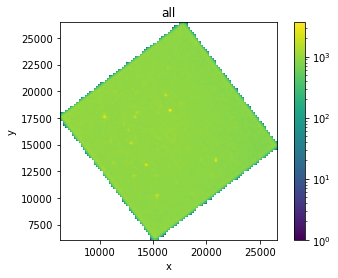

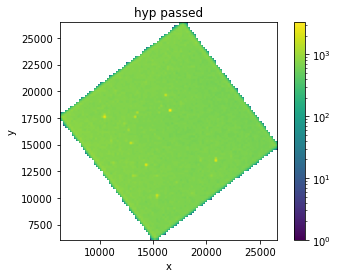

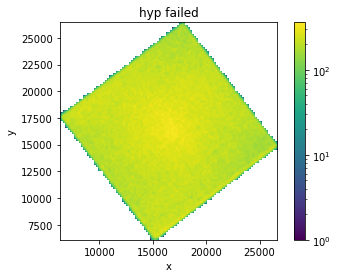

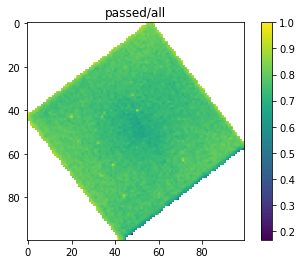

In [16]:
# Optional cell for making cutouts :)0
all = plot_from_df(data_select, 'all', 'x','y')

#data_select = data_select[data_select['y']>22000]

passed = plot_from_df(data_select[data_select['Hyperbola test passed']==True], 'hyp passed', 'x','y')
fail = plot_from_df(data_select[data_select['Hyperbola test passed']==False], 'hyp failed', 'x','y')


# Try to plot these ratios:
plt.imshow(passed/all)
plt.colorbar()
plt.title('passed/all')
plt.show()

<Figure size 432x288 with 0 Axes>

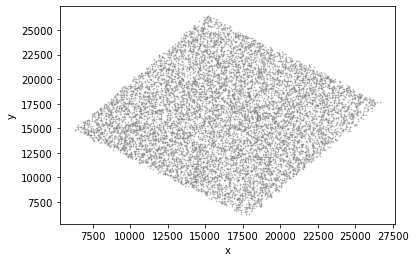

<Figure size 432x288 with 0 Axes>

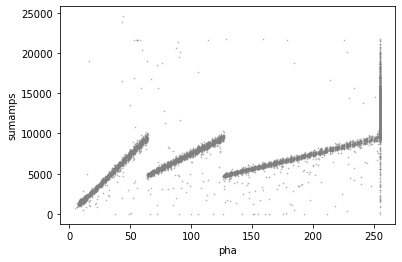

<Figure size 432x288 with 0 Axes>

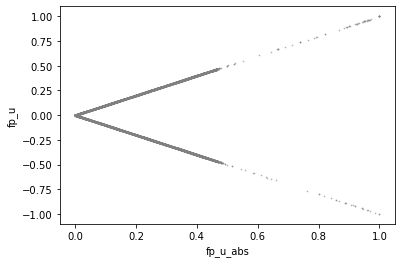

<Figure size 432x288 with 0 Axes>

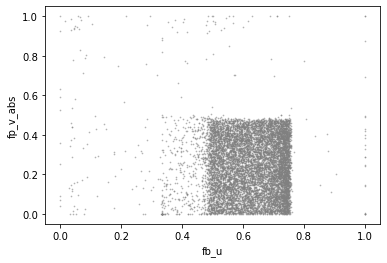

<Figure size 432x288 with 0 Axes>

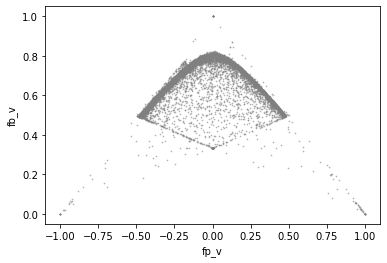

<Figure size 432x288 with 0 Axes>

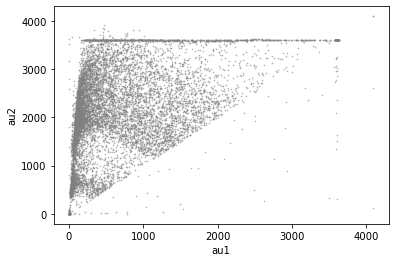

<Figure size 432x288 with 0 Axes>

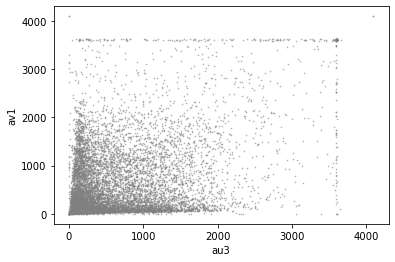

<Figure size 432x288 with 0 Axes>

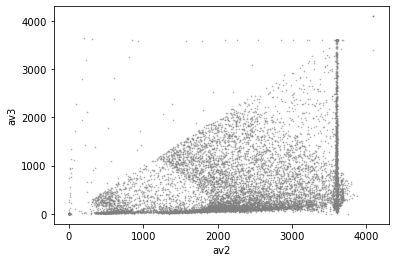

<Figure size 432x288 with 0 Axes>

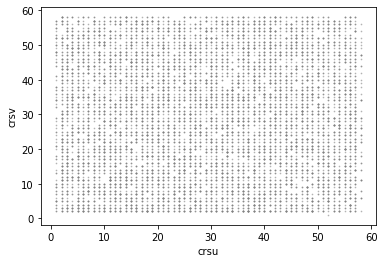

<Figure size 432x288 with 0 Axes>

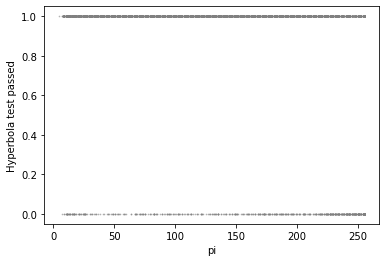

In [9]:
size_random = 10000
data_select_samp = data_select.sample(n=size_random)




for i in range(int(len(feature_list)/2)):
    # Make the shape of this divided by two of plots
    
    # Get the x and y features:
    plot_x = feature_list[2*i]
    plot_y = feature_list[2*i+1]
    
    index_x = all_feature_list.index(plot_x)
    index_y = all_feature_list.index(plot_y)
    
    # Also define where the centers fall: 
    
    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(data_select_samp[plot_x].values, data_select_samp[plot_y].values, 
               color='grey', s=0.5, alpha=0.5)
    #sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
    ax.set_xlabel(str(plot_x))
    ax.set_ylabel(str(plot_y))
    
    
    plt.show()

<Figure size 432x288 with 0 Axes>

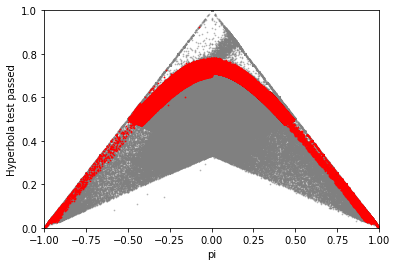

<Figure size 432x288 with 0 Axes>

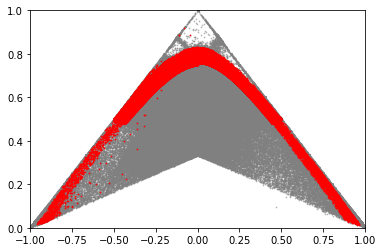

length of selection 3583250


<Figure size 432x288 with 0 Axes>

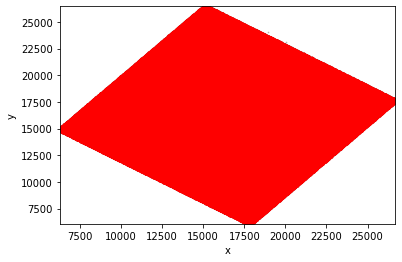

<Figure size 432x288 with 0 Axes>

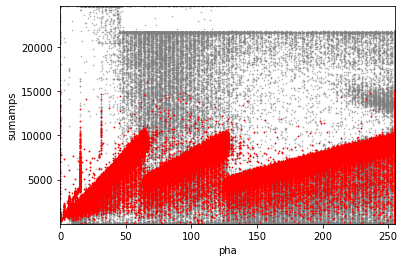

<Figure size 432x288 with 0 Axes>

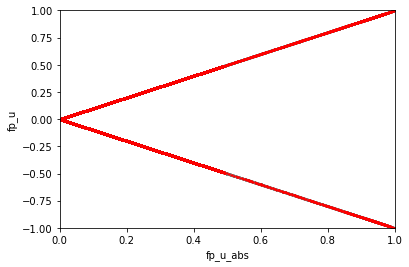

<Figure size 432x288 with 0 Axes>

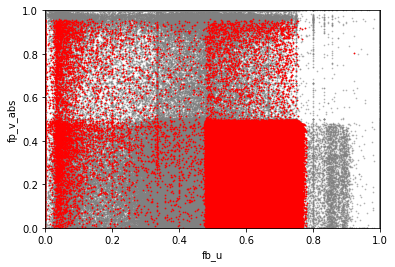

<Figure size 432x288 with 0 Axes>

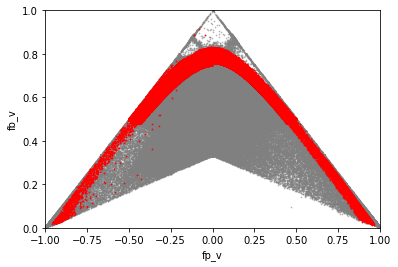

<Figure size 432x288 with 0 Axes>

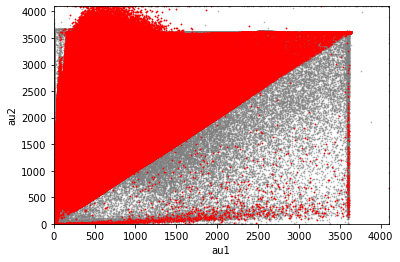

<Figure size 432x288 with 0 Axes>

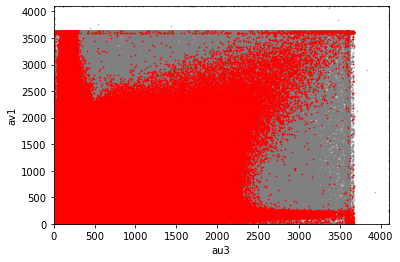

<Figure size 432x288 with 0 Axes>

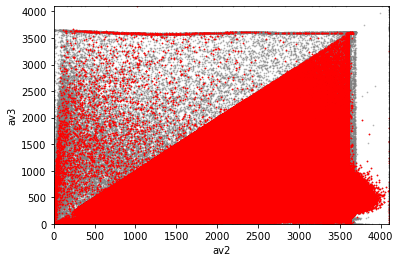

<Figure size 432x288 with 0 Axes>

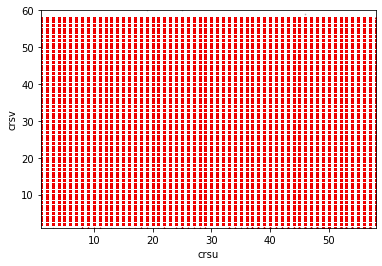

<Figure size 432x288 with 0 Axes>

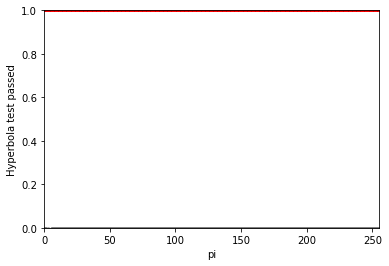

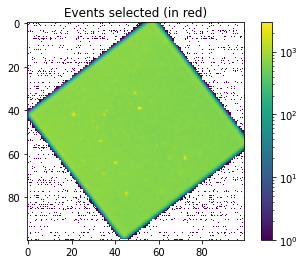

/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide


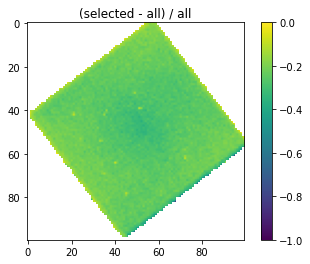

In [10]:
# Now make cuts 


#cut_area = data_select[data_select['pha'] > 250]
# Can this be a function? i.e., below a certain line i.e., the hyperbola forbidden areas

x_select = 'fp_u'
y_select = 'fb_u'

x_select_2 = 'fp_v'
y_select_2 = 'fb_v'
'''
B > (1-f_p)/3
B = B/(A+B+C) where these are au1, au2, au3
'''

selection = ((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))
selection = data_select['Hyperbola test passed']==True
selection_str = 'hyperbola test passed zone'

cut_area = data_select[selection]
#cut_area = data_select[((data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1-data_select[x_select])/3) | (data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1+data_select[x_select])/3))]# & 
                      #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))]
#cut_area = data_select[(data_select[y_select] < -0.5*data_select[x_select] + 0.5) | (data_select[y_select] < 0.5*data_select[x_select] + 0.5)]

plt.clf()
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(data_select[x_select].values, data_select[y_select].values, 
           color='grey', s=0.5, alpha=0.5)
ax.scatter(cut_area[x_select].values, cut_area[y_select].values, 
           color='red', s=0.5)
#sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
ax.set_xlabel(str(plot_x))
ax.set_ylabel(str(plot_y))

ax.set_xlim([np.min(data_select[x_select].values),np.max(data_select[x_select].values)])
ax.set_ylim([np.min(data_select[y_select].values),np.max(data_select[y_select].values)])
plt.show()

plt.clf()
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(data_select[x_select_2].values, data_select[y_select_2].values, 
           color='grey', s=0.5, alpha=0.5)
ax.scatter(cut_area[x_select_2].values, cut_area[y_select_2].values, 
           color='red', s=0.5)


ax.set_xlim([np.min(data_select[x_select_2].values),np.max(data_select[x_select_2].values)])
ax.set_ylim([np.min(data_select[y_select_2].values),np.max(data_select[y_select_2].values)])
plt.show()


'''
[(data_select['fb_u']<0.3) & (data_select['fb_v']<0.3) & 
                       ((data_select['fp_u_abs']<0.6) | (data_select['fp_v_abs']<0.6))]
'''
print('length of selection', len(cut_area))


for i in range(int(len(feature_list)/2)):
    # Make the shape of this divided by two of plots
    
    # Get the x and y features:
    plot_x = feature_list[2*i]
    plot_y = feature_list[2*i+1]
    
    index_x = all_feature_list.index(plot_x)
    index_y = all_feature_list.index(plot_y)
    
    # Also define where the centers fall: 
    
    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(data_select[plot_x].values, data_select[plot_y].values, 
               color='grey', s=0.5, alpha=0.5)
    ax.scatter(cut_area[plot_x].values, cut_area[plot_y].values, 
               color='red', s=0.5)
    #sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
    ax.set_xlabel(str(plot_x))
    ax.set_ylabel(str(plot_y))
    
    ax.set_xlim([np.min(data_select[plot_x].values),np.max(data_select[plot_x].values)])
    ax.set_ylim([np.min(data_select[plot_y].values),np.max(data_select[plot_y].values)])
    plt.show()

# Plot up the properties of the selection
# First, an image
extent_all = [[np.min(data_select['x'].values), np.max(data_select['x'].values)],
              [np.min(data_select['y'].values), np.max(data_select['y'].values)]]
extent_all_crs = [[np.min(data_select['crsu'].values), np.max(data_select['crsu'].values)],
              [np.min(data_select['crsv'].values), np.max(data_select['crsv'].values)]]

x = cut_area['x'].values
y = cut_area['y'].values

x_all = data_select['x'].values
y_all = data_select['y'].values


nbins=100#int(len(x)/10)

img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)

img_data_all, yedges, xedges = np.histogram2d(y_all, x_all, nbins, range=extent_all)

plt.clf()
plt.imshow(abs(img_data), interpolation=None, norm=matplotlib.colors.LogNorm())#,rasterized=True, cmap='viridis', origin='data')

plt.title('Events selected (in red)')
plt.colorbar()
plt.show()



plt.clf()
plt.imshow(((img_data- img_data_all)/img_data_all), interpolation=None)#, norm=matplotlib.colors.LogNorm())#,rasterized=True, cmap='viridis', origin='data')

plt.title('(selected - all) / all')

plt.colorbar()
plt.show()

crsu = cut_area['crsu'].values
crsv = cut_area['crsv'].values


#nbins=100#int(len(x)/10)

#img_data, yedges, xedges = np.histogram2d(crsv, crsu, nbins, range = extent_all_crs)



#plt.clf()
#plt.imshow(abs(img_data), interpolation=None,  norm=matplotlib.colors.LogNorm())#,rasterized=True, cmap='viridis', origin='data')


#plt.colorbar()
#plt.show()

<Figure size 432x288 with 0 Axes>

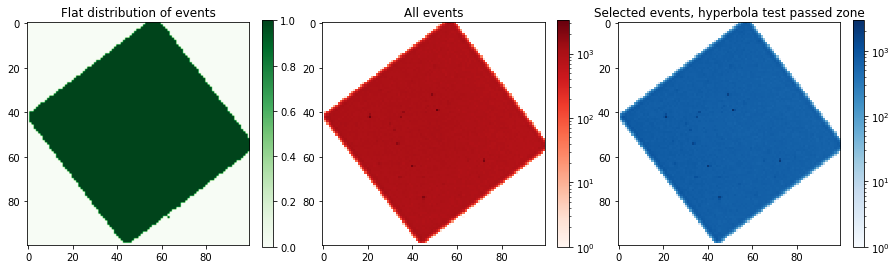

<Figure size 432x288 with 0 Axes>

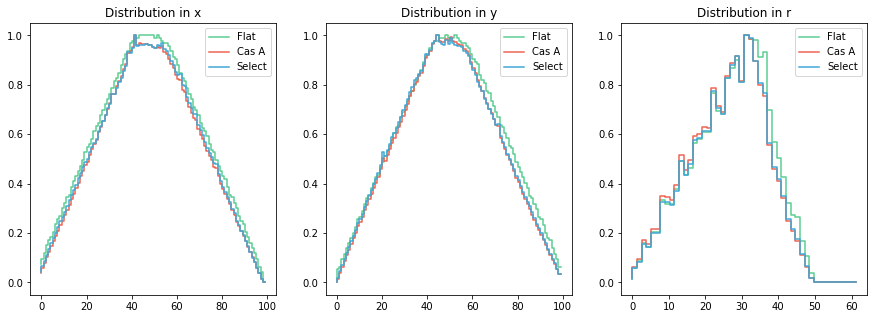

y comparing flat to flat KstestResult(statistic=0.0, pvalue=1.0)
y comparing flat to select KstestResult(statistic=0.09, pvalue=0.8154147124661313)
y comparing flat to all KstestResult(statistic=0.09, pvalue=0.8154147124661313)
y comparing select to all KstestResult(statistic=0.05, pvalue=0.9996892272702655)
Same thing but now radially
y comparing flat to flat KstestResult(statistic=0.0, pvalue=1.0)
y comparing flat to select KstestResult(statistic=0.061224489795918366, pvalue=0.9999937383109323)
y comparing flat to all KstestResult(statistic=0.061224489795918366, pvalue=0.9999937383109323)
y comparing select to all KstestResult(statistic=0.061224489795918366, pvalue=0.9999937383109323)


In [17]:
# Okay but how to statistically talk about the distribution of these events:



#nbins=100#int(len(x)/10)

#img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)

#img_data_all, yedges, xedges = np.histogram2d(y_all, x_all, nbins, range=extent_all)

#img_data_all_masked = np.ma.masked_where(img_data_all==0, img_data_all)

# Decompose this into 2d distribution:
#mask = abs(img_data_all_masked.mask - 1)

# Instead, try to replace


img_data_flat = np.minimum(img_data_all, 1)



#img_data_flat = img_data_all
#img_data_flat[img_data > 0 ] = 1

plt.clf()
fig = plt.figure(figsize=(15,5))
ax0 = fig.add_subplot(131)
im0 = ax0.imshow(img_data_flat, cmap='Greens')
plt.colorbar(im0, fraction = 0.046)
ax0.set_title('Flat distribution of events')

ax1 = fig.add_subplot(132)
im1 = ax1.imshow(img_data_all, norm=matplotlib.colors.LogNorm(), cmap='Reds', interpolation='None')
plt.colorbar(im1, fraction = 0.046)
ax1.set_title('All events')

ax2 = fig.add_subplot(133)
im2 = ax2.imshow(img_data, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
plt.colorbar(im2, fraction = 0.046)
ax2.set_title('Selected events, '+str(selection_str))
plt.show()

'''
# See if you can bin radially
# img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)
extent = (np.max(y) - np.min(y))/2
radial_bins = np.linspace(0,extent+extent/5,50)

ycen = (np.max(y) - np.min(y))/2 + np.min(y)
xcen = (np.max(x) - np.min(x))/2 + np.min(x)

# Make a plot of this to double check that it is working
plt.scatter(x, y)
xs_circ = np.linspace(np.min(x), np.max(x),100)
for i in range(len(radial_bins)):
    #x**2 + y**2 = radial_bins**2
    # radial_bins**2 - (x - xcen)**2 = (y - ycen)**2
    ys_circ = [np.sqrt(radial_bins[i]**2 - (x - xcen)**2) + ycen for x in xs_circ]
    ys_circ_neg = [-np.sqrt(radial_bins[i]**2 - (x - xcen)**2) + ycen for x in xs_circ]
    plt.plot(xs_circ, ys_circ, color='black')
    plt.plot(xs_circ, ys_circ_neg, color='black')
    
plt.show()


print('radial bins', radial_bins)
bin_count = []
for i in range(len(radial_bins)-1):
    counter = 0
    for j in range(len(x)):
        
        if (((y[j]-ycen)**2 + (x[j]-xcen)**2) > radial_bins[i]**2) & (((y[j]-ycen)**2 + (x[j]-xcen)**2) < radial_bins[i+1]**2):
            counter += 1
    bin_count.append(counter)
print(bin_count)

plt.step(radial_bins[:-1], bin_count)
plt.show()
'''


# Ugh, but you actually have to do this for the img_datas, which are 2D
middle_pixel_x = np.shape(img_data_flat)[0]/2
middle_pixel_y = np.shape(img_data_flat)[1]/2


extent = np.shape(img_data_flat)[0]

radial_bins_pix = np.linspace(0,extent/2 + extent/8,50)

radial_bins_pix_flat = []
radial_bins_pix_sample = []
radial_bins_pix_full = []

for k in range(len(radial_bins_pix)-1):
    counter_flat = 0
    counter_sample = 0
    counter_full = 0
    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_flat+=img_data_flat[i,j] # only need to add 1 because its flat distribution
                counter_sample+=img_data[i,j]
                counter_full+=img_data_all[i,j]
    radial_bins_pix_flat.append(counter_flat)
    radial_bins_pix_sample.append(counter_sample)
    radial_bins_pix_full.append(counter_full)
                
dist_flat = radial_bins_pix_flat/np.max(radial_bins_pix_flat)
dist_sample = radial_bins_pix_sample/np.max(radial_bins_pix_sample)
dist_all = radial_bins_pix_full/np.max(radial_bins_pix_full)







# Projected histograms inx and y

hx_flat, hy_flat = margins(img_data_flat)
hx_select, hy_select = margins(img_data)
hx_all, hy_all = margins(img_data_all)

#print('hx all', hx_all.T[0], 'hy all', hy_all[0])
#hx_flat, hy_flat = img_data_flat.sum(axis=0), img_data_flat.sum(axis=1)
#hx_all, hy_all = img_data_all.sum(axis=0), img_data_all.sum(axis=1)

xs = np.linspace(0, len(hx_flat.T[0])-1, len(hx_flat.T[0]))
ys = np.linspace(0, len(hy_flat[0])-1, len(hy_flat[0]))


plt.clf()
fig = plt.figure(figsize=(15,5))
ax0 = fig.add_subplot(131)
ax0.step(xs, hx_flat.T[0]/np.max(hx_flat.T[0]), label='Flat', color='#59CD90')
ax0.step(xs, hx_all.T[0]/np.max(hx_all.T[0]),  label='Cas A', color='#EE6352')#, density=True)
ax0.step(xs, hx_select.T[0]/np.max(hx_select.T[0]), label='Select', color='#3FA7D6')
plt.legend()
ax0.set_title('Distribution in x')

ax1 = fig.add_subplot(132)
ax1.step(ys, hy_flat[0]/np.max(hy_flat[0]), label='Flat', color='#59CD90')
ax1.step(ys, hy_all[0]/np.max(hy_all[0]),  label='Cas A', color='#EE6352')#, density=True)
ax1.step(ys, hy_select[0]/np.max(hy_select[0]), label='Select', color='#3FA7D6')
plt.legend()
ax1.set_title('Distribution in y')

ax2 = fig.add_subplot(133)
ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
ax2.step(radial_bins_pix[:-1], dist_sample, label='Select', color='#3FA7D6')
plt.legend()
ax2.set_title('Distribution in r')

plt.show()


#Conduct k-s test to see how similar this is to the flat distribution
print('y comparing flat to flat', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_flat[0]/np.max(hy_flat[0])) )
print('y comparing flat to select', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_select[0]/np.max(hy_select[0])) )
print('y comparing flat to all', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_all[0]/np.max(hy_all[0])) )

print('y comparing select to all', scipy.stats.ks_2samp(hy_all[0]/np.max(hy_all[0]),hy_select[0]/np.max(hy_select[0])) )

# Doing the same radially
print('Same thing but now radially')
print('y comparing flat to flat', scipy.stats.ks_2samp(dist_flat,dist_flat) )
print('y comparing flat to select', scipy.stats.ks_2samp(dist_flat, dist_sample) )
print('y comparing flat to all', scipy.stats.ks_2samp(dist_flat, dist_all) )

print('y comparing select to all', scipy.stats.ks_2samp(dist_sample, dist_all) )


# The null hypothesis is that the two distributions are identical. 
# We can reject them because the p-val is so small

<Figure size 432x288 with 0 Axes>

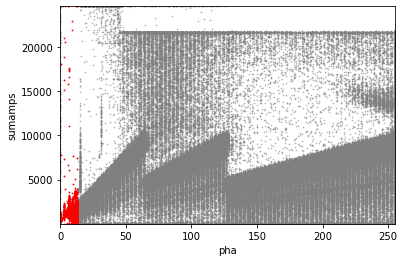

length of selection 270284


<Figure size 432x288 with 0 Axes>

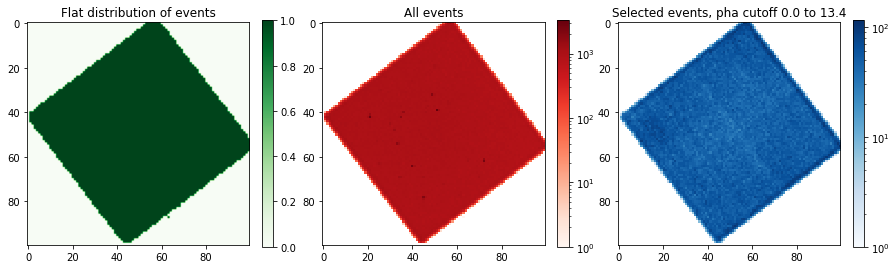

<Figure size 432x288 with 0 Axes>

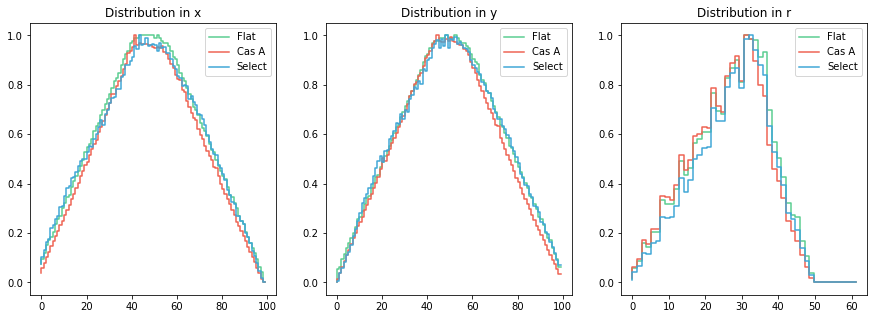

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

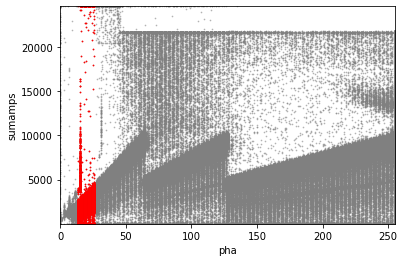

length of selection 293619


<Figure size 432x288 with 0 Axes>

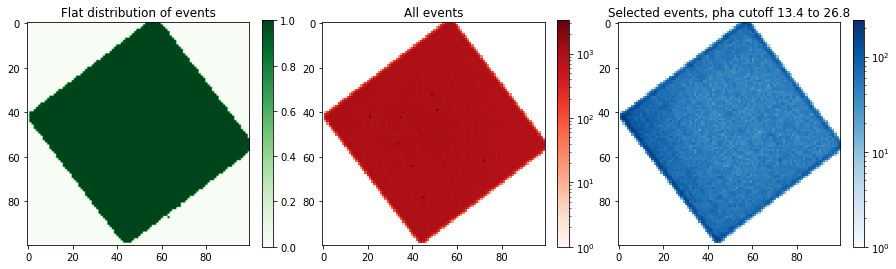

<Figure size 432x288 with 0 Axes>

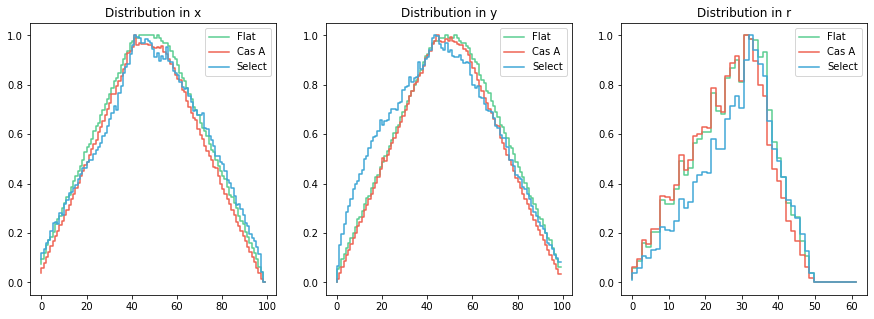

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

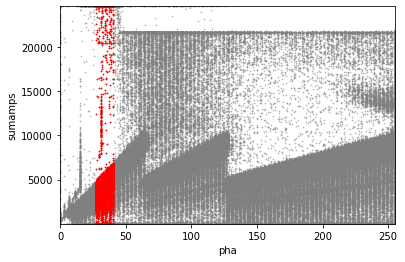

length of selection 261538


<Figure size 432x288 with 0 Axes>

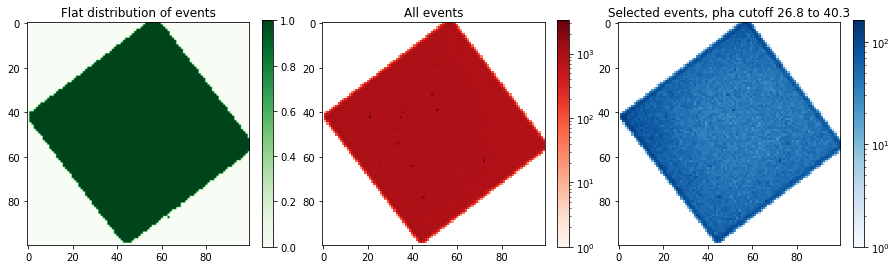

<Figure size 432x288 with 0 Axes>

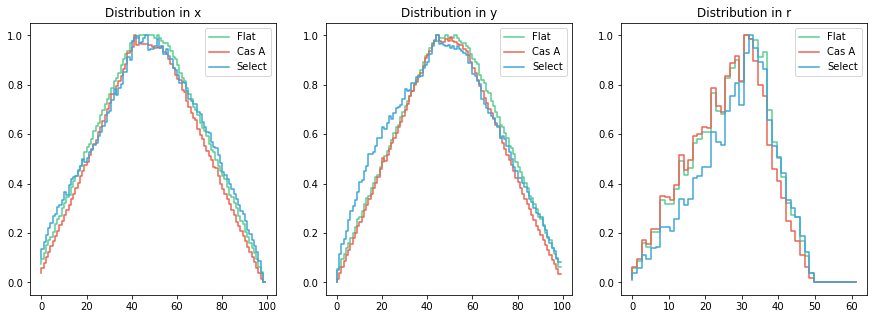

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

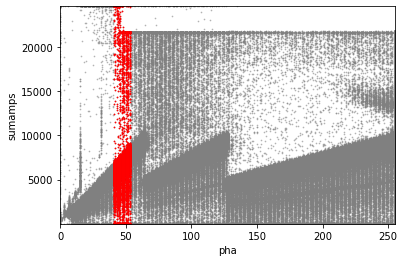

length of selection 246513


<Figure size 432x288 with 0 Axes>

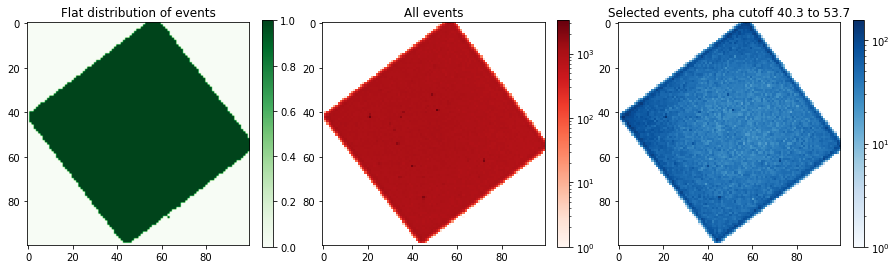

<Figure size 432x288 with 0 Axes>

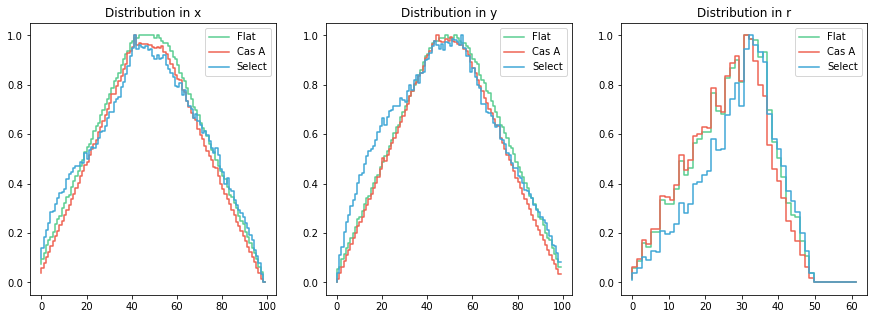

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

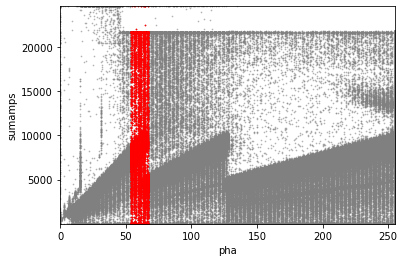

length of selection 289720


<Figure size 432x288 with 0 Axes>

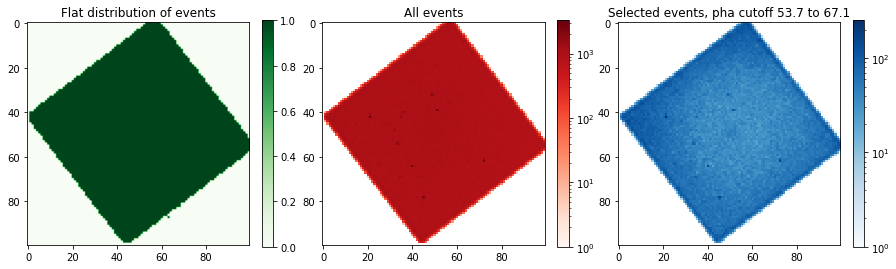

<Figure size 432x288 with 0 Axes>

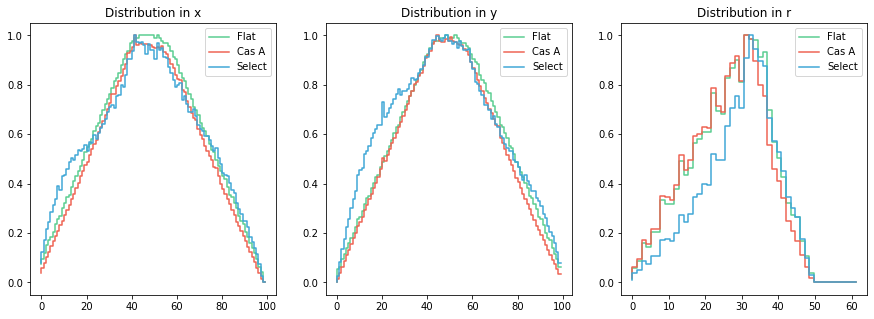

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

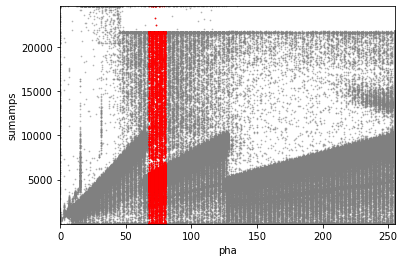

length of selection 288489


<Figure size 432x288 with 0 Axes>

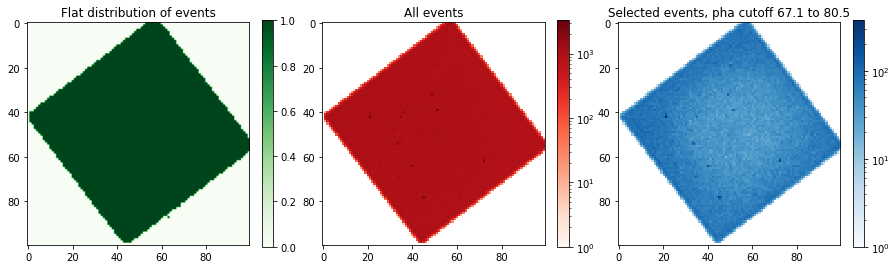

<Figure size 432x288 with 0 Axes>

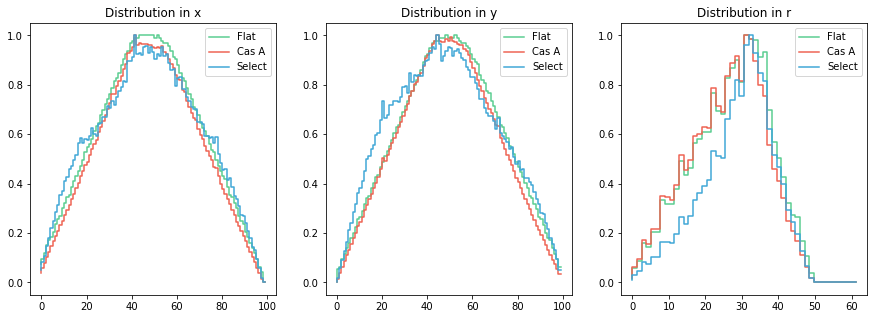

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 0.7048666822735955


<Figure size 432x288 with 0 Axes>

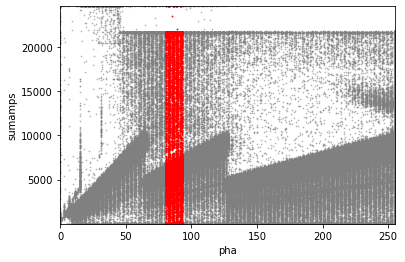

length of selection 285682


<Figure size 432x288 with 0 Axes>

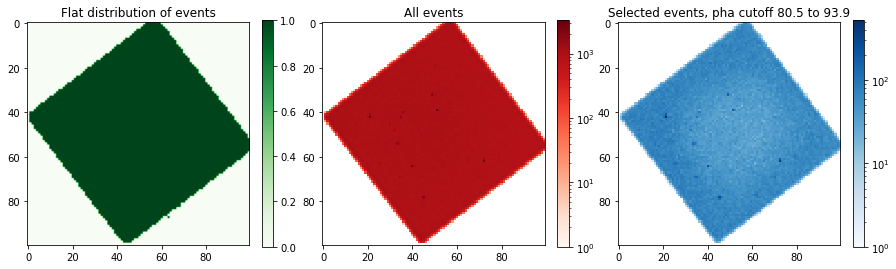

<Figure size 432x288 with 0 Axes>

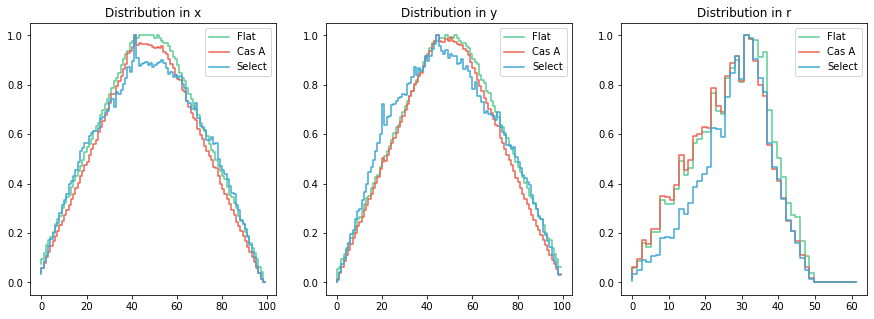

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 0.7048666822735955


<Figure size 432x288 with 0 Axes>

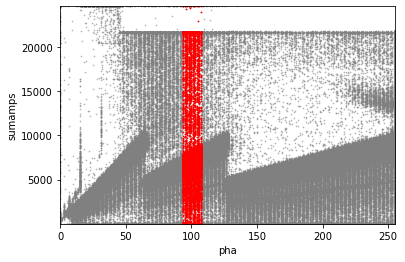

length of selection 291789


<Figure size 432x288 with 0 Axes>

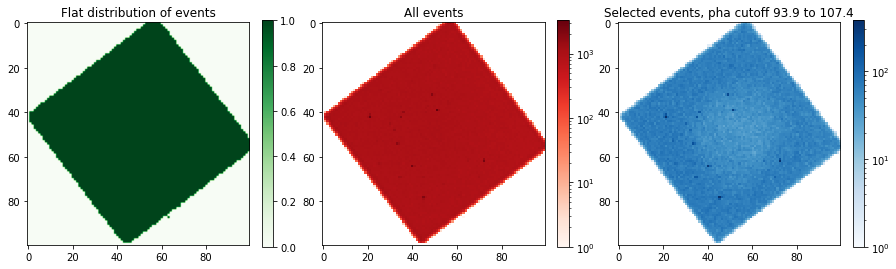

<Figure size 432x288 with 0 Axes>

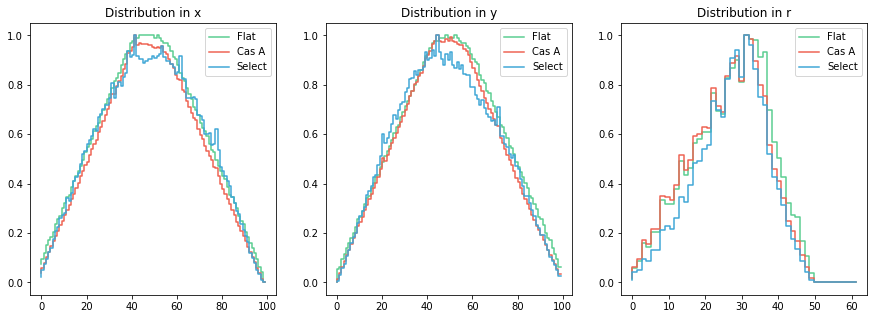

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

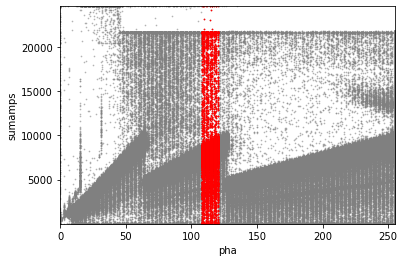

length of selection 249193


<Figure size 432x288 with 0 Axes>

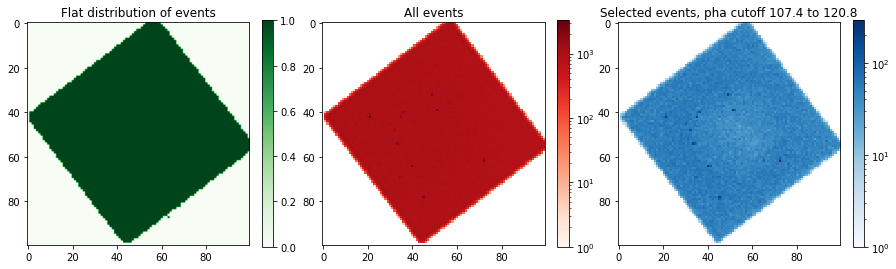

<Figure size 432x288 with 0 Axes>

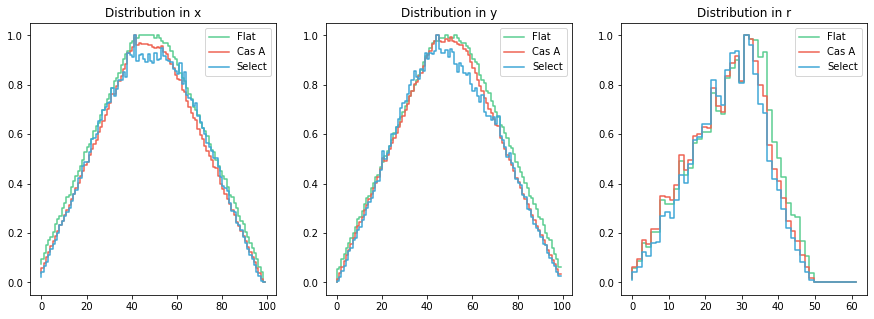

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

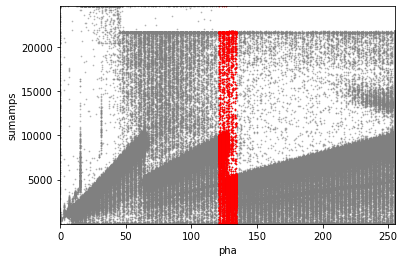

length of selection 242154


<Figure size 432x288 with 0 Axes>

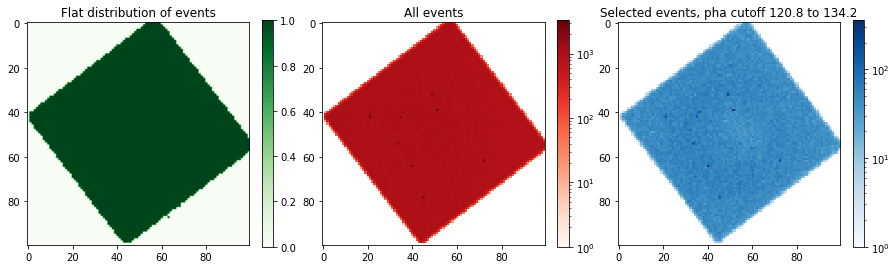

<Figure size 432x288 with 0 Axes>

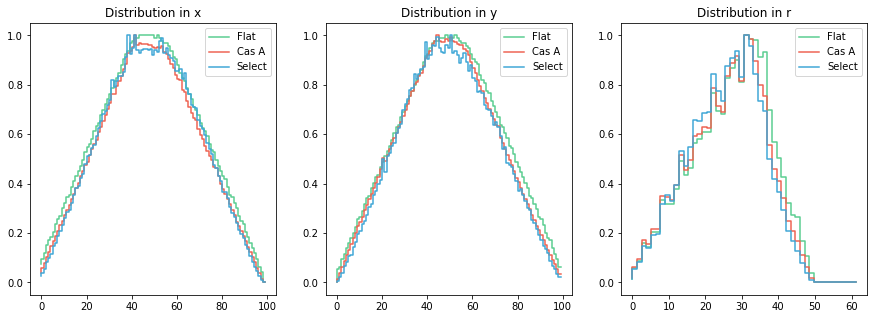

p-value comparing radial distribution to flat 0.997345059724473
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

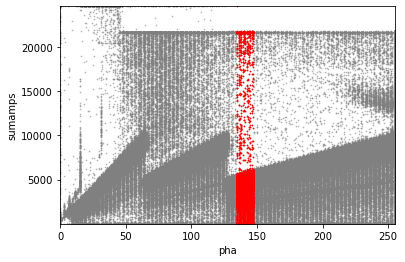

length of selection 200066


<Figure size 432x288 with 0 Axes>

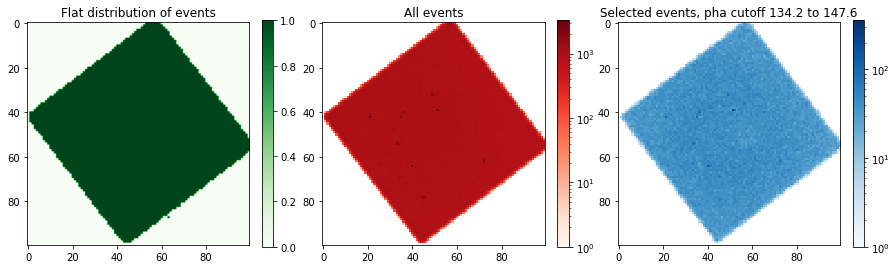

<Figure size 432x288 with 0 Axes>

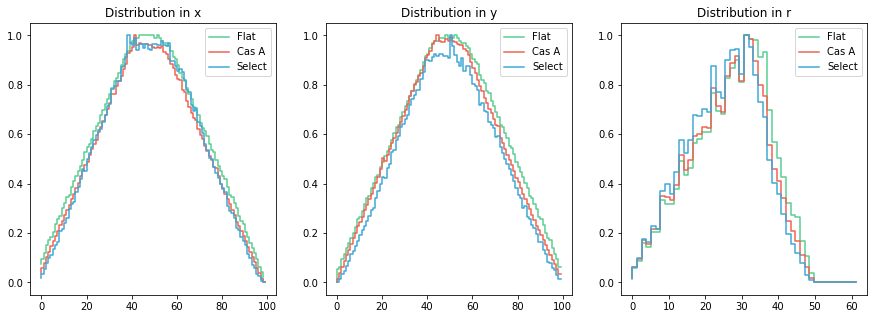

p-value comparing radial distribution to flat 0.9999937383109323
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

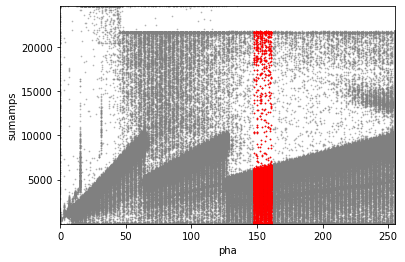

length of selection 189783


<Figure size 432x288 with 0 Axes>

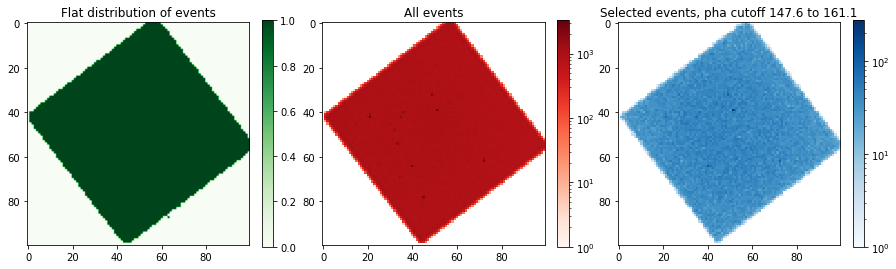

<Figure size 432x288 with 0 Axes>

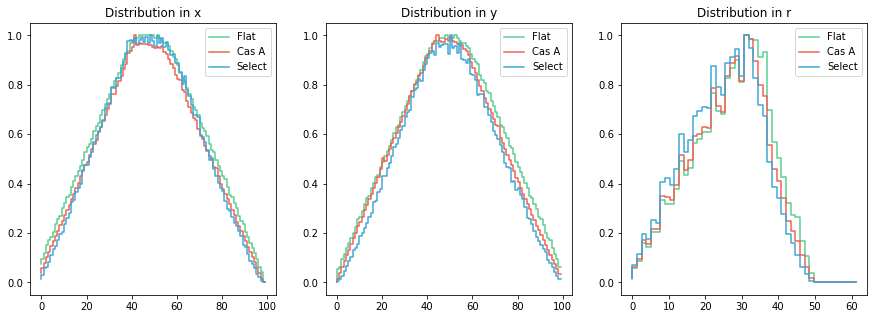

p-value comparing radial distribution to flat 0.9999937383109323
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

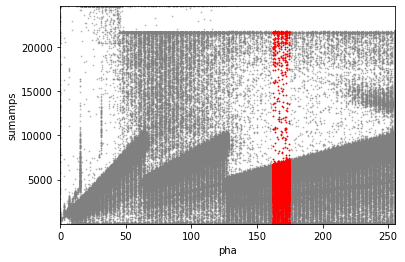

length of selection 155672


<Figure size 432x288 with 0 Axes>

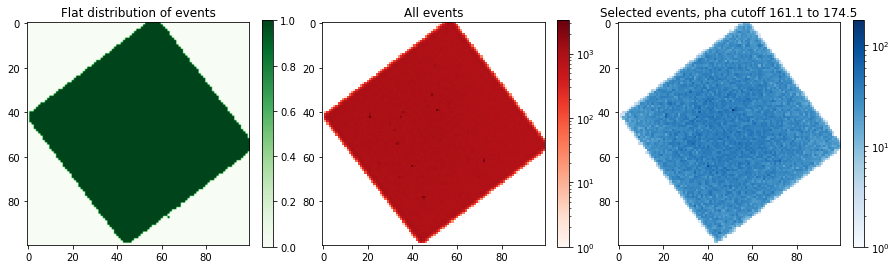

<Figure size 432x288 with 0 Axes>

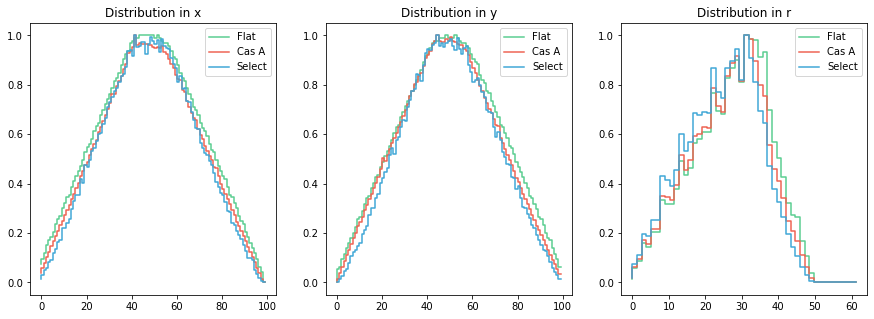

p-value comparing radial distribution to flat 0.9999937383109323
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

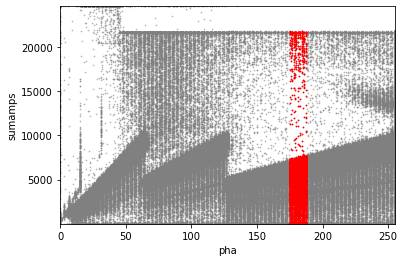

length of selection 136622


<Figure size 432x288 with 0 Axes>

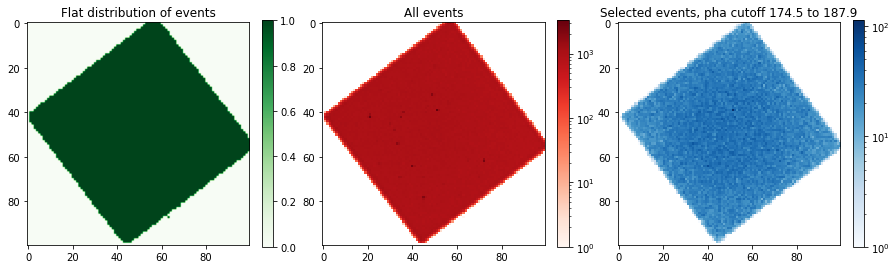

<Figure size 432x288 with 0 Axes>

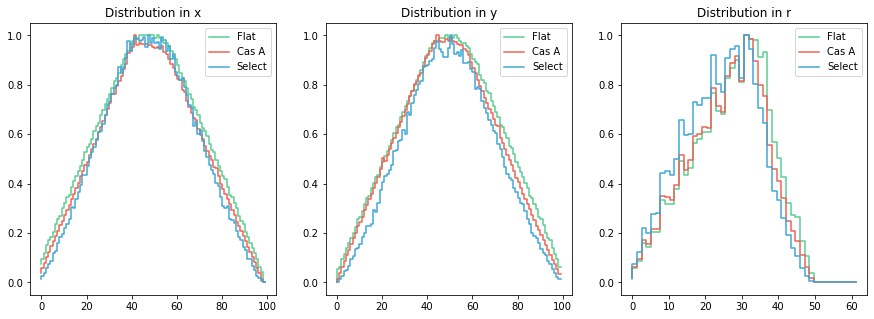

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 0.9636034058516135


<Figure size 432x288 with 0 Axes>

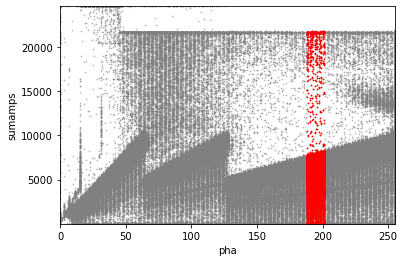

length of selection 133324


<Figure size 432x288 with 0 Axes>

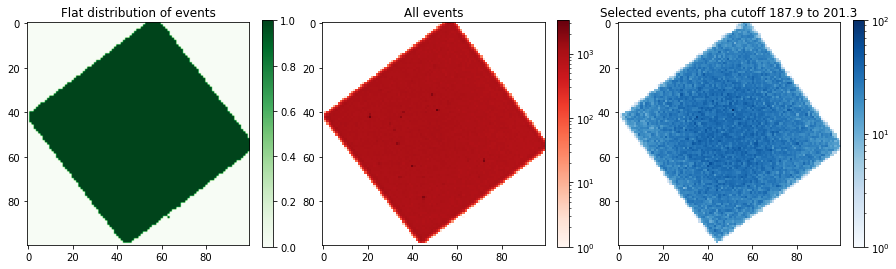

<Figure size 432x288 with 0 Axes>

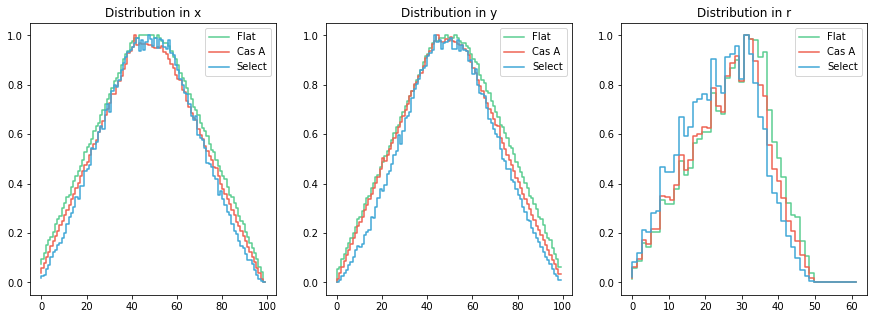

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 0.997345059724473


<Figure size 432x288 with 0 Axes>

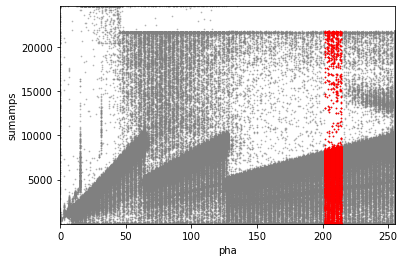

length of selection 109719


<Figure size 432x288 with 0 Axes>

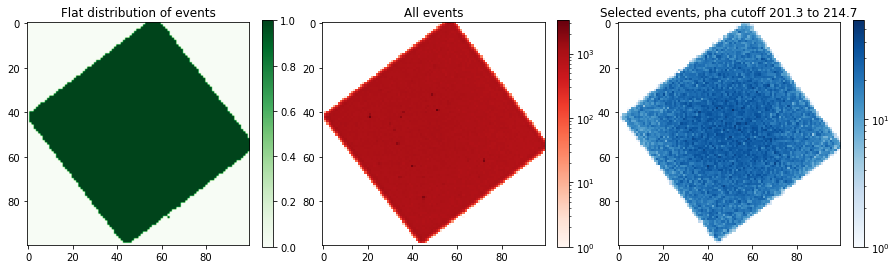

<Figure size 432x288 with 0 Axes>

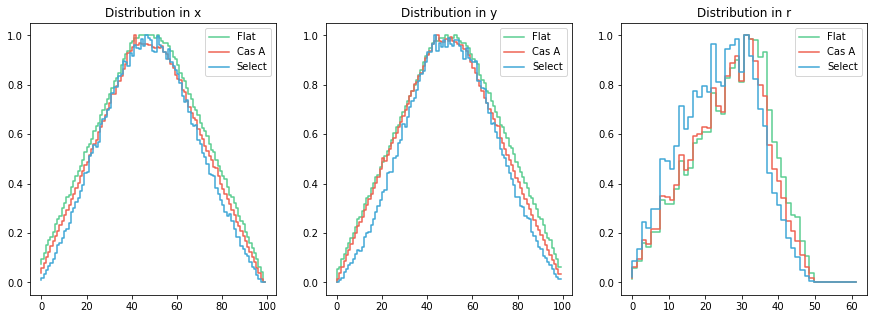

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

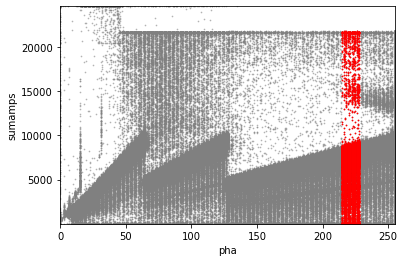

length of selection 105849


<Figure size 432x288 with 0 Axes>

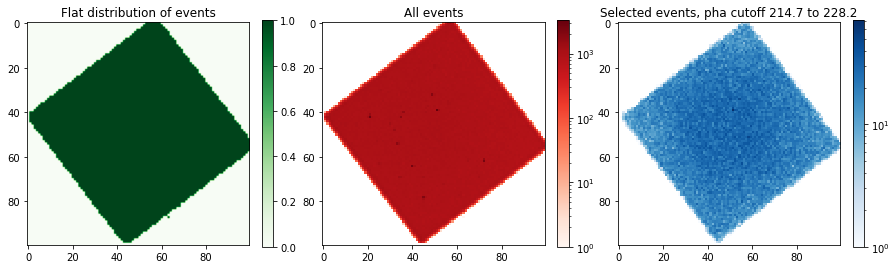

<Figure size 432x288 with 0 Axes>

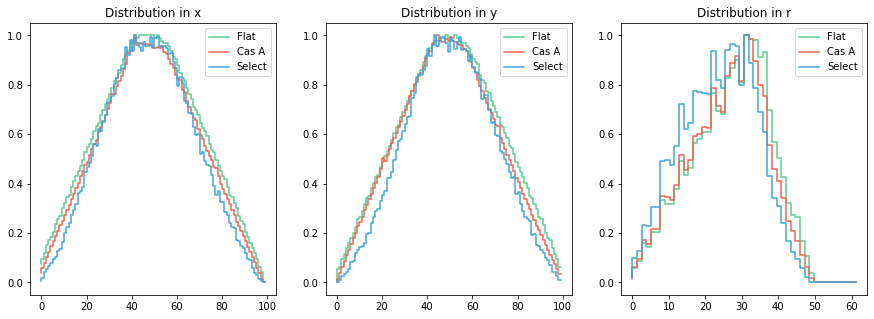

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 0.9636034058516135


<Figure size 432x288 with 0 Axes>

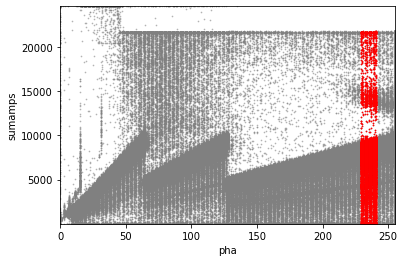

length of selection 88542


<Figure size 432x288 with 0 Axes>

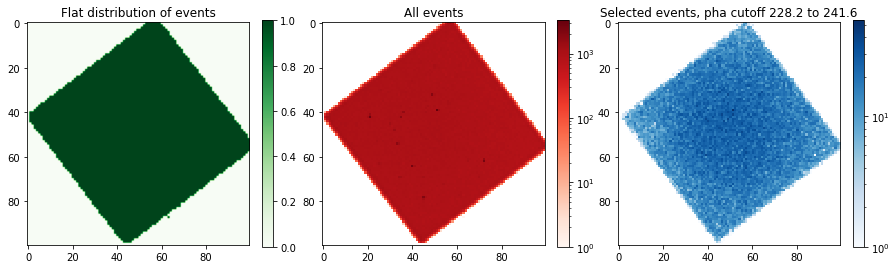

<Figure size 432x288 with 0 Axes>

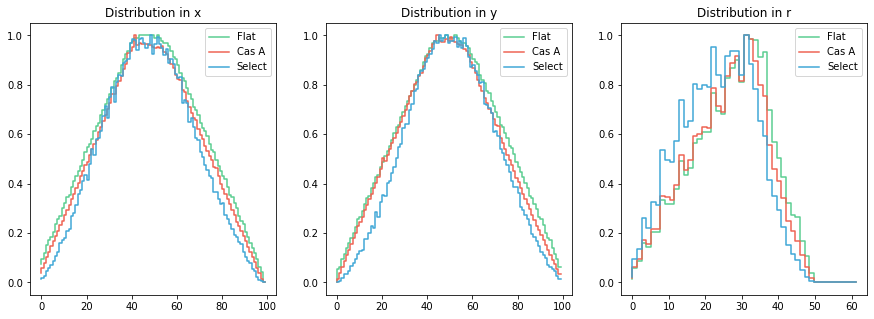

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

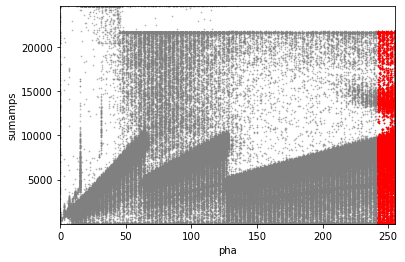

length of selection 84677


<Figure size 432x288 with 0 Axes>

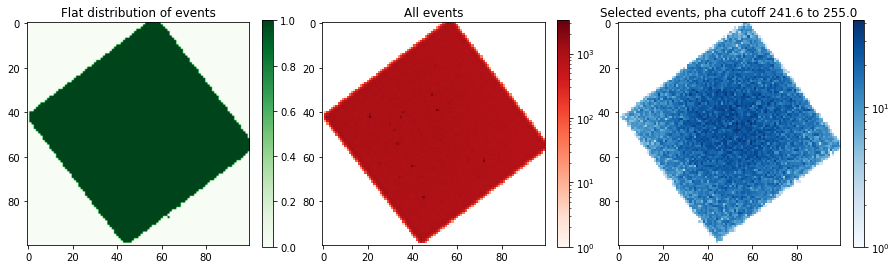

<Figure size 432x288 with 0 Axes>

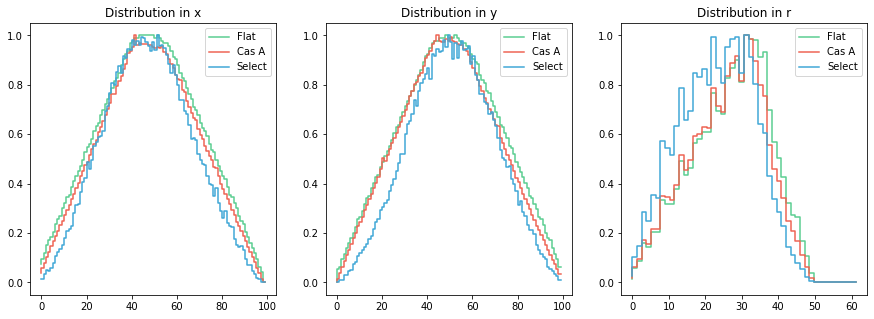

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 0.7048666822735955
ks value for r flat [0.9636034058516135, 0.7048666822735955, 0.8612765597225885, 0.8612765597225885, 0.7048666822735955, 0.5355200665725597, 0.7048666822735955, 0.7048666822735955, 0.9636034058516135, 0.997345059724473, 0.9999937383109323, 0.9999937383109323, 0.9999937383109323, 0.9636034058516135, 0.9636034058516135, 0.8612765597225885, 0.8612765597225885, 0.9636034058516135, 0.8612765597225885]
ks value for r all [0.997345059724473, 0.8612765597225885, 0.8612765597225885, 0.8612765597225885, 0.8612765597225885, 0.7048666822735955, 0.7048666822735955, 0.8612765597225885, 0.997345059724473, 0.997345059724473, 0.997345059724473, 0.997345059724473, 0.997345059724473, 0.9636034058516135, 0.997345059724473, 0.8612765597225885, 0.9636034058516135, 0.8612765597225885, 0.7048666822735955]
ks value for x flat [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 

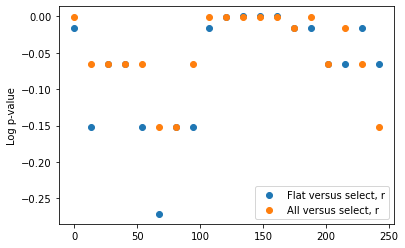

In [18]:
# Okay what about putting this together to run iteratively?
# Try this in just pha first
x_select = 'fp_u'
y_select = 'fb_u'

x_select = 'pha'
y_select = 'sumamps'

x_select_2 = 'fp_v'
y_select_2 = 'fb_v'
'''
B > (1-f_p)/3
B = B/(A+B+C) where these are au1, au2, au3
'''

steps = np.linspace(0,255,20) #for pha

#steps = np.linspace(0, 1, 10) #for fp and fp
#steps = [0,1]

#steps = np.linspace(0,20000,10)

k_s_val_flat_x = []
k_s_val_all_x = []
k_s_val_flat_r = []
k_s_val_all_r = []


# Prep stuff for the 'all' and 'flat' cases outside of the loop:
extent_all = [[np.min(data_select['x'].values), np.max(data_select['x'].values)],
                  [np.min(data_select['y'].values), np.max(data_select['y'].values)]]

x_all = data_select['x'].values
y_all = data_select['y'].values


nbins=100#int(len(x)/10)

img_data_all, yedges, xedges = np.histogram2d(y_all, x_all, nbins, range=extent_all)

img_data_flat = np.minimum(img_data_all, 1)

hx_flat, hy_flat = margins(img_data_flat)
hx_all, hy_all = margins(img_data_all)


middle_pixel_x = np.shape(img_data_flat)[0]/2
middle_pixel_y = np.shape(img_data_flat)[1]/2


extent = np.shape(img_data_flat)[0]

radial_bins_pix = np.linspace(0,extent/2 + extent/8,50)

radial_bins_pix_flat = []
radial_bins_pix_full = []

for k in range(len(radial_bins_pix)-1):
    counter_flat = 0
    counter_full = 0
    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_flat+=img_data_flat[i,j] # only need to add 1 because its flat distribution
                counter_full+=img_data_all[i,j]
    radial_bins_pix_flat.append(counter_flat)
    radial_bins_pix_full.append(counter_full)

dist_flat = radial_bins_pix_flat/np.max(radial_bins_pix_flat)
dist_all = radial_bins_pix_full/np.max(radial_bins_pix_full)

u1 = data_select['au1']
u2 = data_select['au2']
u3 = data_select['au3']
v1 = data_select['av1']
v2 = data_select['av2']
v3 = data_select['av3']

for i in range(len(steps)-1):
    val = steps[i]
    val_plus_one = steps[i+1]

    
    
    selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) | ((u2/(u1+u2+u3) > val*(1+data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1+data_select[x_select])/3))
    selection = ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3)) | ((v2/(v1+v2+v3) > val*(1+data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1+data_select[x_select_2])/3))
    
    selection = ((data_select['sumamps'] < val_plus_one) & (data_select['sumamps'] > val))
    selection = ((data_select['pha'] < val_plus_one) & (data_select['pha'] > val))
    
    #selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) & ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3))
    #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))
    
    
    
    selection_str = 'pha cutoff '+str(round(val,1))+' to '+str(round(val_plus_one,1))

    cut_area = data_select[selection]
    #cut_area = data_select[((data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1-data_select[x_select])/3) | (data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1+data_select[x_select])/3))]# & 
                          #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))]
    #cut_area = data_select[(data_select[y_select] < -0.5*data_select[x_select] + 0.5) | (data_select[y_select] < 0.5*data_select[x_select] + 0.5)]

    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(data_select[x_select].values, data_select[y_select].values, 
               color='grey', s=0.5, alpha=0.5)
    ax.scatter(cut_area[x_select].values, cut_area[y_select].values, 
               color='red', s=0.5)
    #sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
    ax.set_xlabel(x_select)
    ax.set_ylabel(y_select)

    ax.set_xlim([np.min(data_select[x_select].values),np.max(data_select[x_select].values)])
    ax.set_ylim([np.min(data_select[y_select].values),np.max(data_select[y_select].values)])
    plt.show()
    
    if x_select=='fp_u':

        plt.clf()
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.scatter(data_select[x_select_2].values, data_select[y_select_2].values, 
                   color='grey', s=0.5, alpha=0.5)
        ax.scatter(cut_area[x_select_2].values, cut_area[y_select_2].values, 
                   color='red', s=0.5)


        ax.set_xlim([np.min(data_select[x_select_2].values),np.max(data_select[x_select_2].values)])
        ax.set_ylim([np.min(data_select[y_select_2].values),np.max(data_select[y_select_2].values)])
        ax.set_xlabel(x_select_2)
        ax.set_ylabel(y_select_2)
        
        plt.show()


    print('length of selection', len(cut_area))


    # Plot up the properties of the selection
    # First, an image
    

    x = cut_area['x'].values
    y = cut_area['y'].values
    
    

    img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)
    
    


    #img_data_flat = img_data_all
    #img_data_flat[img_data > 0 ] = 1

    plt.clf()
    fig = plt.figure(figsize=(15,5))
    ax0 = fig.add_subplot(131)
    im0 = ax0.imshow(img_data_flat, cmap='Greens')
    plt.colorbar(im0, fraction = 0.046)
    ax0.set_title('Flat distribution of events')

    ax1 = fig.add_subplot(132)
    im1 = ax1.imshow(img_data_all, norm=matplotlib.colors.LogNorm(), cmap='Reds', interpolation='None')
    plt.colorbar(im1, fraction = 0.046)
    ax1.set_title('All events')

    ax2 = fig.add_subplot(133)
    im2 = ax2.imshow(img_data, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
    try:
        plt.colorbar(im2, fraction = 0.046)
    except:
        k_s_val_flat_x.append(0)
        k_s_val_all_x.append(0)
        k_s_val_flat_r.append(0)
        k_s_val_all_r.append(0)
        continue
    ax2.set_title('Selected events, '+str(selection_str))
    plt.show()


    # What about projecting radially?
    # This could be cool for breaking down what is happening on the very edge of the chip
    # Ugh, but you actually have to do this for the img_datas, which are 2D

    radial_bins_pix_sample = []

    for k in range(len(radial_bins_pix)-1):
        
        counter_sample = 0
        
        for i in range(np.shape(img_data_flat)[0]):
            for j in range(np.shape(img_data_flat)[1]):
                # so for each pixel see how far it is in pixel bins from the center
                if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                    counter_sample+=img_data[i,j]
                    
        radial_bins_pix_sample.append(counter_sample)
        
    dist_sample = radial_bins_pix_sample/np.max(radial_bins_pix_sample)
    


    # Projected histograms inx and y

    
    hx_select, hy_select = margins(img_data)
    

    #print('hx all', hx_all.T[0], 'hy all', hy_all[0])
    #hx_flat, hy_flat = img_data_flat.sum(axis=0), img_data_flat.sum(axis=1)
    #hx_all, hy_all = img_data_all.sum(axis=0), img_data_all.sum(axis=1)

    xs = np.linspace(0, len(hx_flat.T[0])-1, len(hx_flat.T[0]))
    ys = np.linspace(0, len(hy_flat[0])-1, len(hy_flat[0]))


    plt.clf()
    fig = plt.figure(figsize=(15,5))
    ax0 = fig.add_subplot(131)
    ax0.step(xs, hx_flat.T[0]/np.max(hx_flat.T[0]), label='Flat', color='#59CD90')
    ax0.step(xs, hx_all.T[0]/np.max(hx_all.T[0]),  label='Cas A', color='#EE6352')#, density=True)
    ax0.step(xs, hx_select.T[0]/np.max(hx_select.T[0]), label='Select', color='#3FA7D6')
    plt.legend()
    ax0.set_title('Distribution in x')

    ax1 = fig.add_subplot(132)
    ax1.step(ys, hy_flat[0]/np.max(hy_flat[0]), label='Flat', color='#59CD90')
    ax1.step(ys, hy_all[0]/np.max(hy_all[0]),  label='Cas A', color='#EE6352')#, density=True)
    ax1.step(ys, hy_select[0]/np.max(hy_select[0]), label='Select', color='#3FA7D6')
    plt.legend()
    ax1.set_title('Distribution in y')
    
    ax2 = fig.add_subplot(133)
    ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
    ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
    ax2.step(radial_bins_pix[:-1], dist_sample, label='Select', color='#3FA7D6')
    plt.legend()
    ax2.set_title('Distribution in r')
    plt.show()


    #Conduct k-s test to see how similar this is to the flat distribution
    stat_flat_x = scipy.stats.ks_2samp(hx_flat[0]/np.max(hx_flat[0]),hx_select[0]/np.max(hx_select[0]))
    stat_all_x = scipy.stats.ks_2samp(hx_all[0]/np.max(hx_all[0]),hx_select[0]/np.max(hx_select[0]))
    stat_flat_r = scipy.stats.ks_2samp(dist_flat, dist_sample)
    stat_all_r = scipy.stats.ks_2samp(dist_sample, dist_all)
    #print(stat.pvalue)
    k_s_val_flat_x.append(stat_flat_x.pvalue)
    k_s_val_all_x.append(stat_all_x.pvalue)
    k_s_val_flat_r.append(stat_flat_r.pvalue)
    k_s_val_all_r.append(stat_all_r.pvalue)
    
    print('p-value comparing radial distribution to flat', stat_flat_r.pvalue)
    print('p-value comparing radial distribution to all events', stat_all_r.pvalue)
   


#print('pha cuts', pha_cuts)
print('ks value for r flat', k_s_val_flat_r)
print('ks value for r all', k_s_val_all_r)
print('ks value for x flat', k_s_val_flat_x)
print('ks value for x all', k_s_val_all_x)
import math
plt.clf()

log_ks_flat = [math.log10(x) for x in k_s_val_flat_r]
log_ks_all = [math.log10(x) for x in k_s_val_all_r]
plt.scatter(steps[:-1], log_ks_flat, label='Flat versus select, r')
plt.scatter(steps[:-1], log_ks_all, label='All versus select, r')

#plt.scatter(pha_cuts[:-1], k_s_val_flat_x, label='Flat versus select, x')
#plt.scatter(pha_cuts[:-1], k_s_val_all_x, label='All versus select, x')
plt.legend()
plt.ylabel('Log p-value')
plt.show()


### Okay now do this in two dimensions:


length of selection 133485


<Figure size 432x288 with 0 Axes>

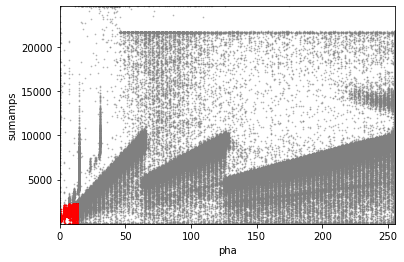

p-value comparing radial distribution to flat 0.997345059724473
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

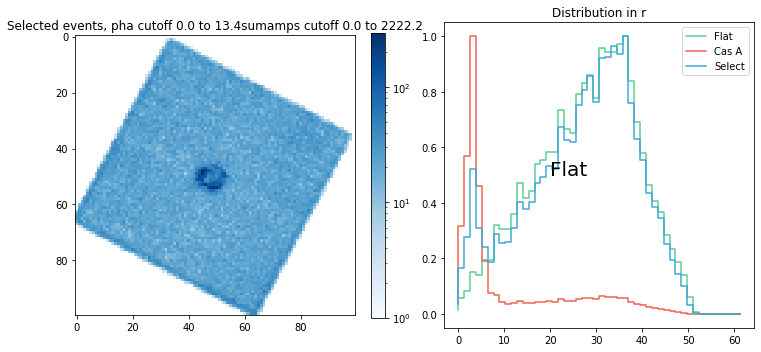

length of selection 1096


<Figure size 432x288 with 0 Axes>

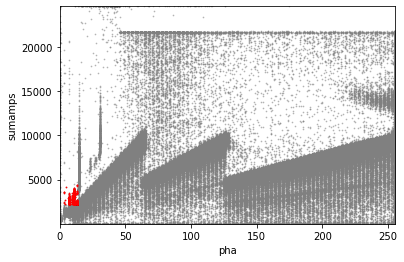

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

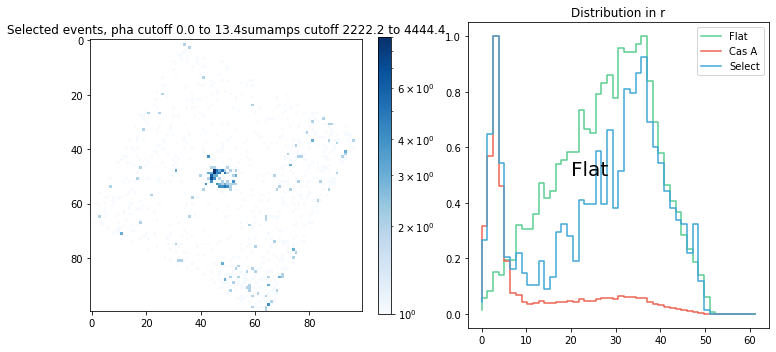

length of selection 5
length of selection 6
length of selection 3
length of selection 4
length of selection 6
length of selection 10
length of selection 4
length of selection 30341


<Figure size 432x288 with 0 Axes>

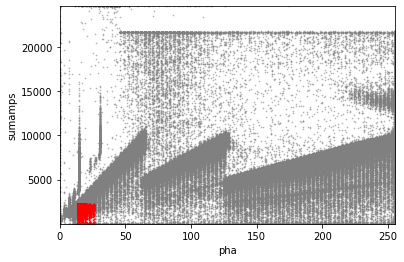

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

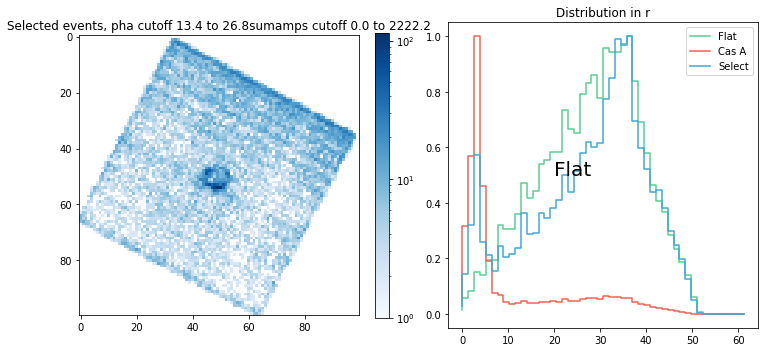

length of selection 126536


<Figure size 432x288 with 0 Axes>

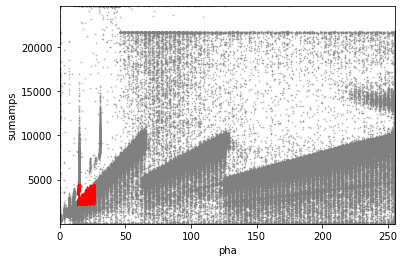

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

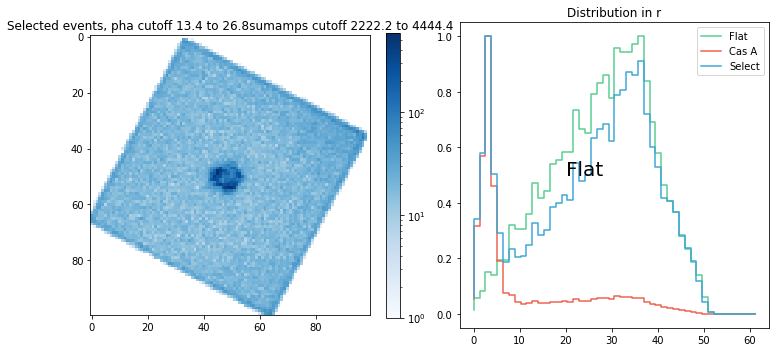

length of selection 1154


<Figure size 432x288 with 0 Axes>

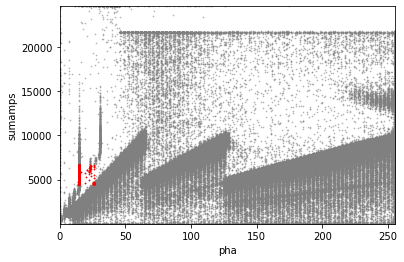

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

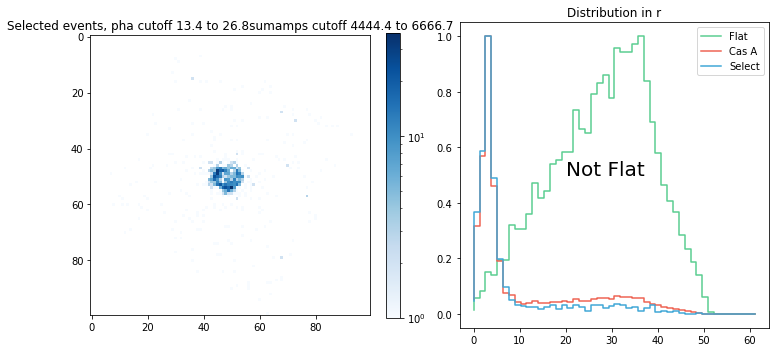

length of selection 582


<Figure size 432x288 with 0 Axes>

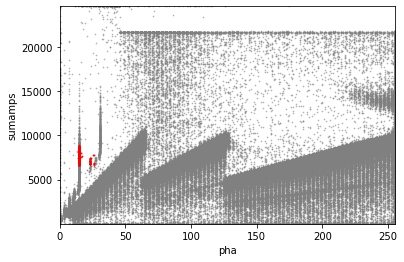

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 0.00020262539475434033


<Figure size 432x288 with 0 Axes>

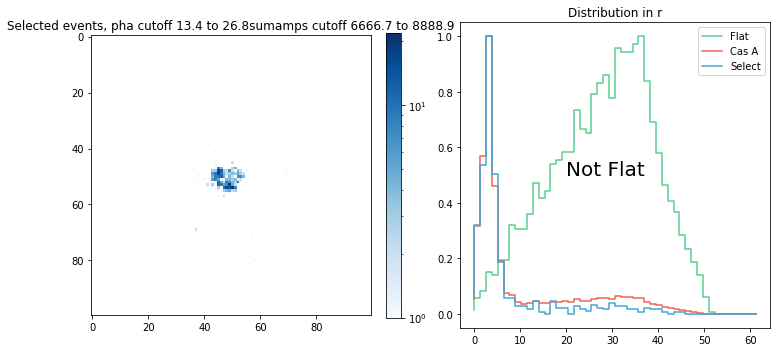

length of selection 127


<Figure size 432x288 with 0 Axes>

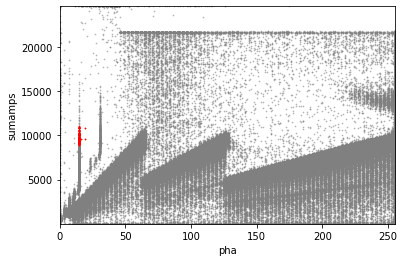

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 0.00020262539475434033


<Figure size 432x288 with 0 Axes>

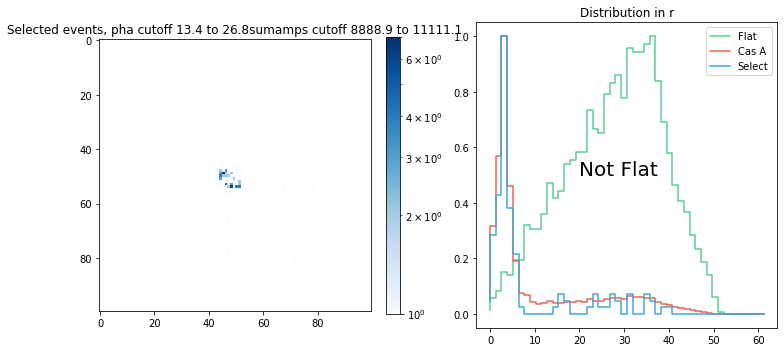

length of selection 18
length of selection 9
length of selection 6
length of selection 3
length of selection 472


<Figure size 432x288 with 0 Axes>

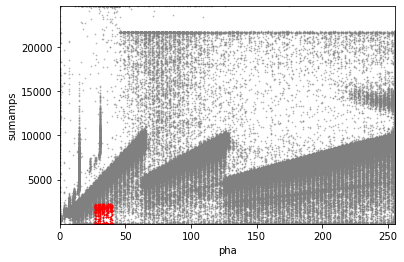

p-value comparing radial distribution to flat 0.2611068851719254
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

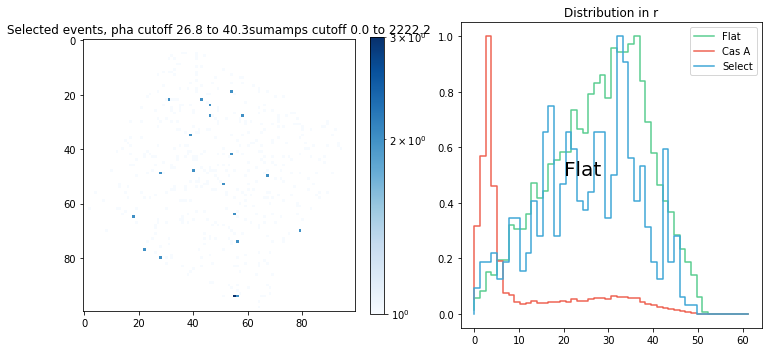

length of selection 44984


<Figure size 432x288 with 0 Axes>

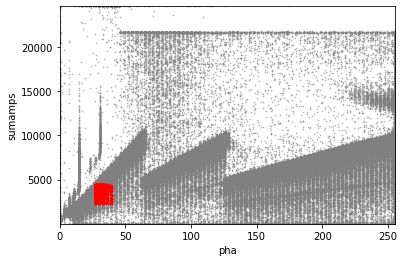

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

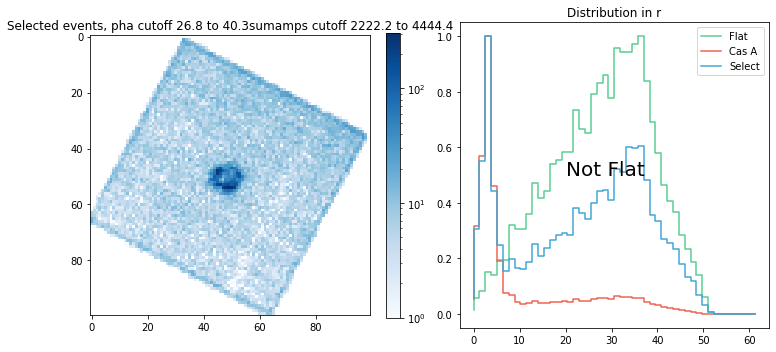

length of selection 112432


<Figure size 432x288 with 0 Axes>

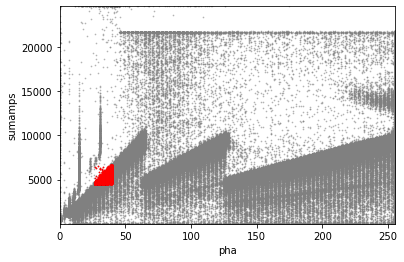

p-value comparing radial distribution to flat 0.005166468598651642
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

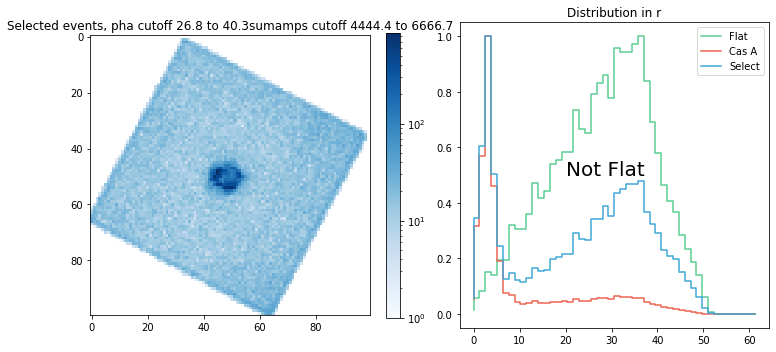

length of selection 205


<Figure size 432x288 with 0 Axes>

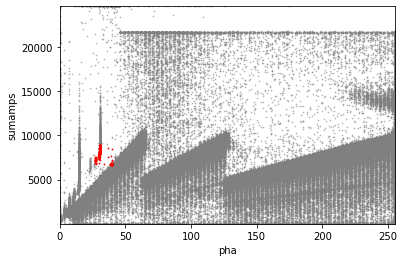

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.03612176482297013


<Figure size 432x288 with 0 Axes>

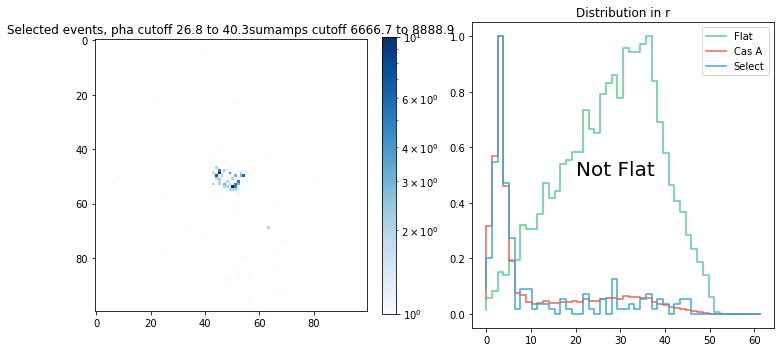

length of selection 251


<Figure size 432x288 with 0 Axes>

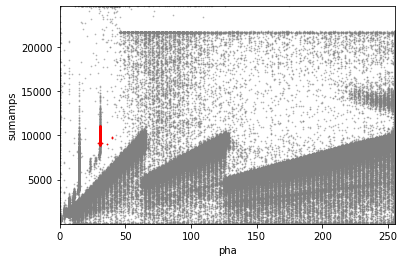

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 0.001124920295006686


<Figure size 432x288 with 0 Axes>

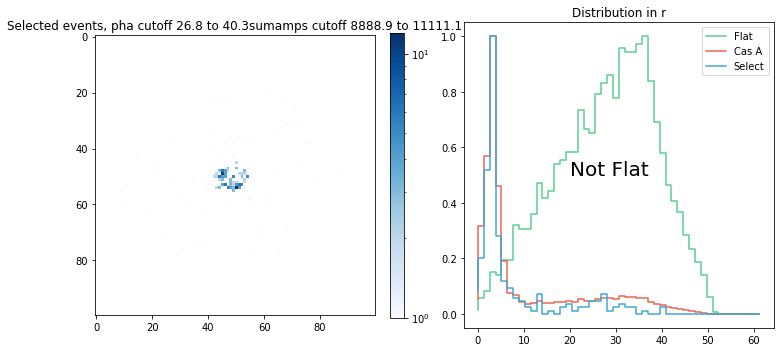

length of selection 107


<Figure size 432x288 with 0 Axes>

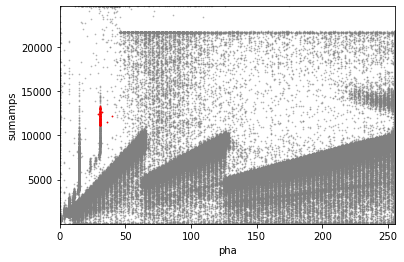

p-value comparing radial distribution to flat 1.1538080891883593e-06
p-value comparing radial distribution to all events 0.0004890957804413903


<Figure size 432x288 with 0 Axes>

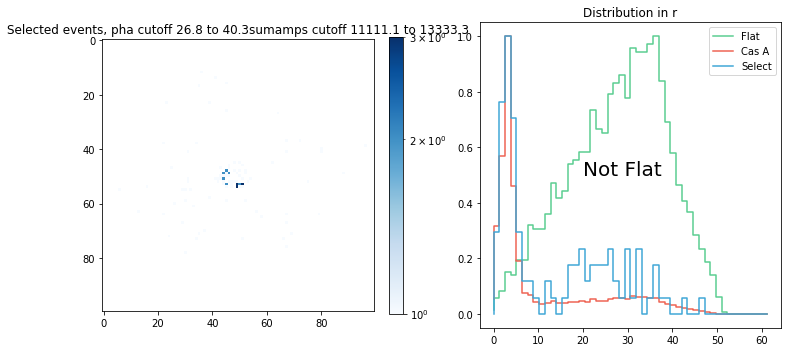

length of selection 29
length of selection 5
length of selection 8
length of selection 245


<Figure size 432x288 with 0 Axes>

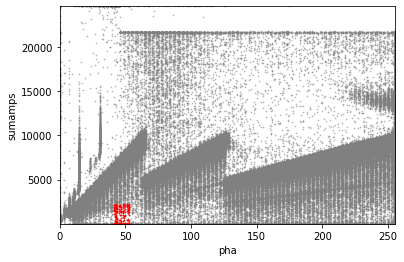

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

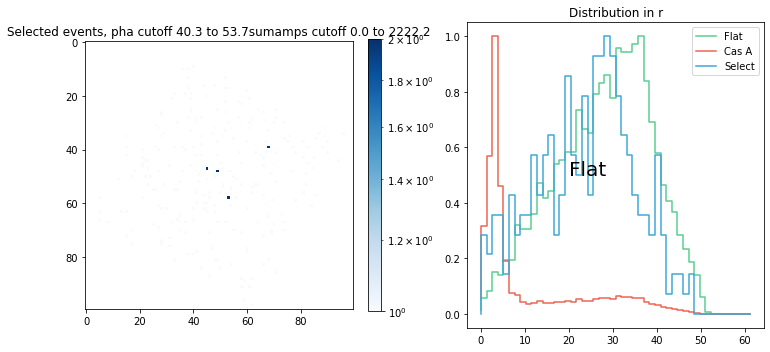

length of selection 437


<Figure size 432x288 with 0 Axes>

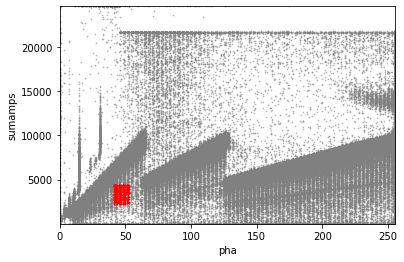

p-value comparing radial distribution to flat 0.2611068851719254
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

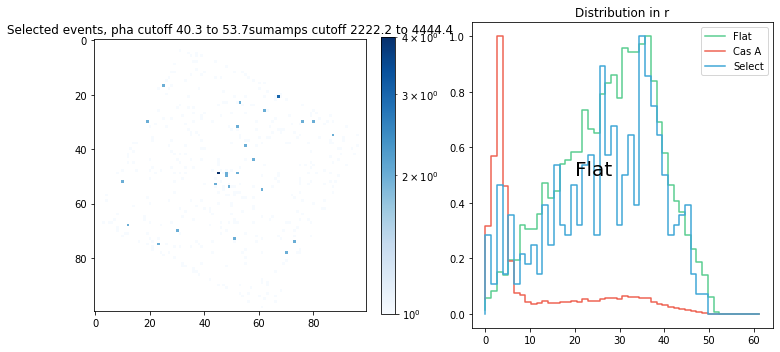

length of selection 56758


<Figure size 432x288 with 0 Axes>

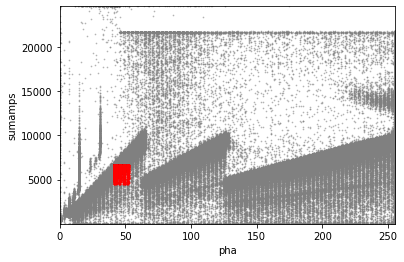

p-value comparing radial distribution to flat 0.00020262539475434033
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

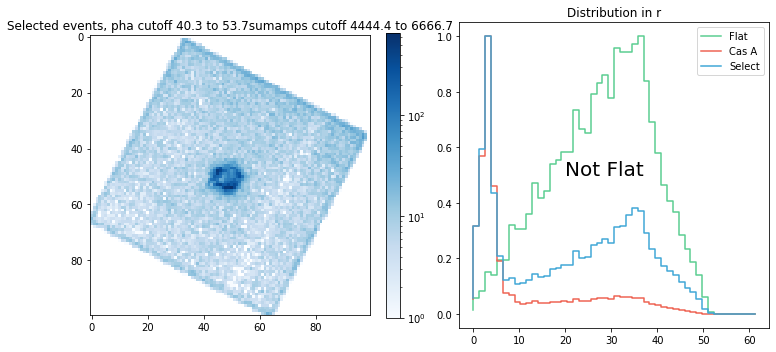

length of selection 107169


<Figure size 432x288 with 0 Axes>

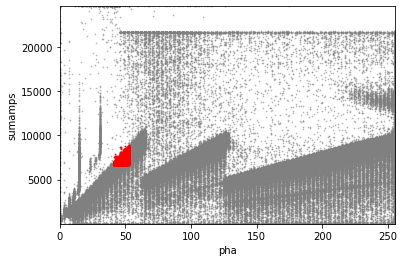

p-value comparing radial distribution to flat 2.9965727393247677e-05
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

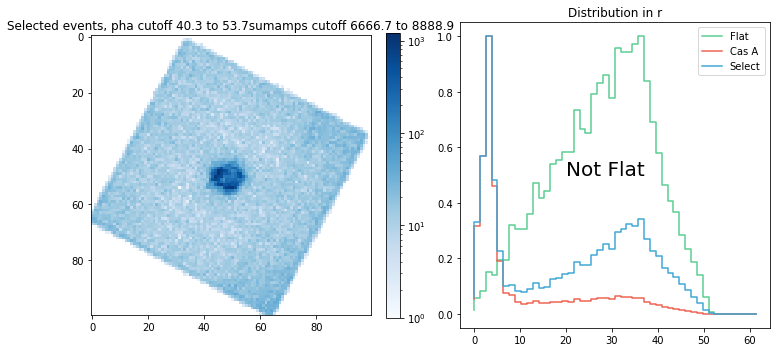

length of selection 25
length of selection 26
length of selection 31
length of selection 34
length of selection 58
length of selection 307


<Figure size 432x288 with 0 Axes>

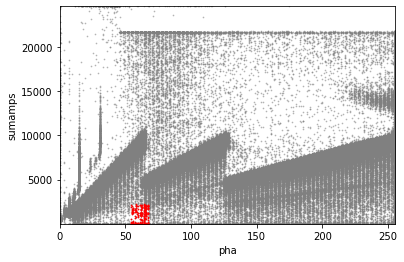

p-value comparing radial distribution to flat 0.2611068851719254
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

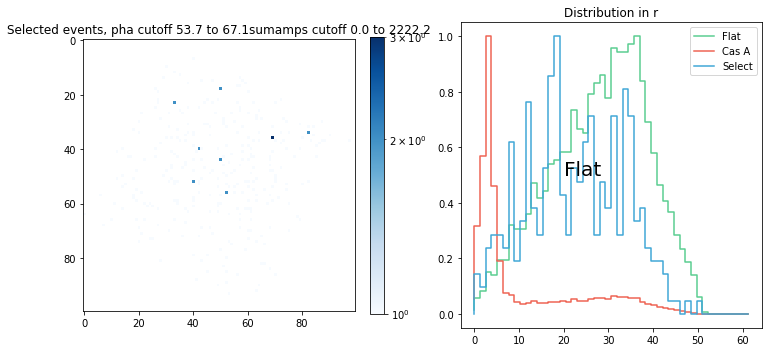

length of selection 705


<Figure size 432x288 with 0 Axes>

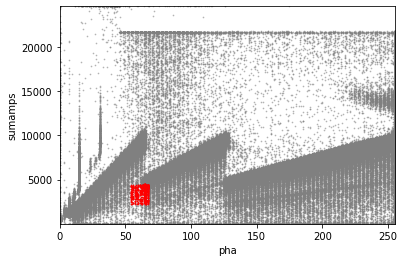

p-value comparing radial distribution to flat 0.06321210922149156
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

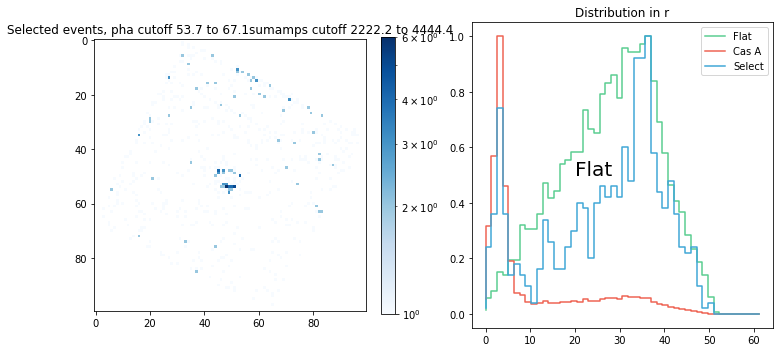

length of selection 51762


<Figure size 432x288 with 0 Axes>

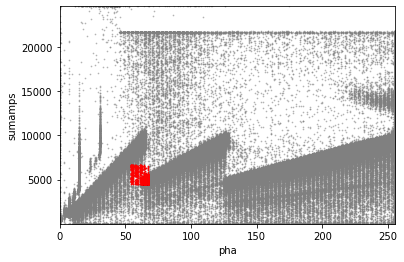

p-value comparing radial distribution to flat 1.1538080891883593e-06
p-value comparing radial distribution to all events 3.4917876383331924e-07


<Figure size 432x288 with 0 Axes>

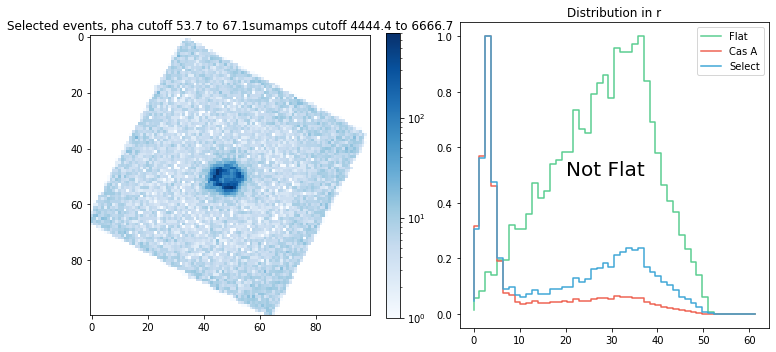

length of selection 92198


<Figure size 432x288 with 0 Axes>

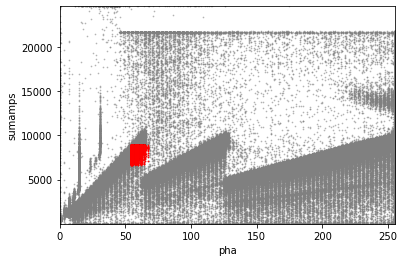

p-value comparing radial distribution to flat 1.1538080891883593e-06
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

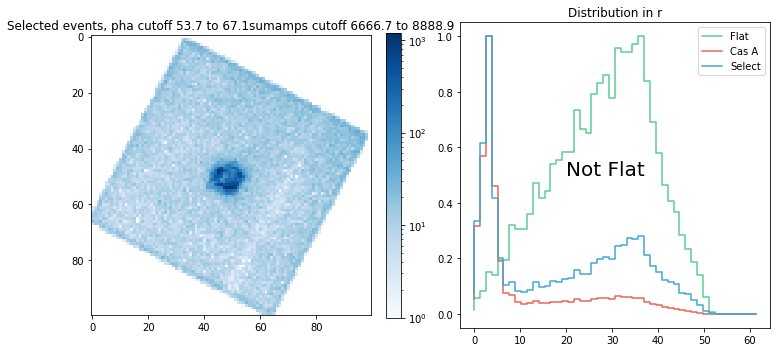

length of selection 66450


<Figure size 432x288 with 0 Axes>

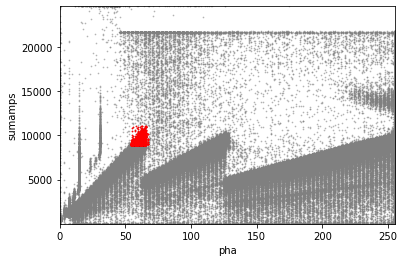

p-value comparing radial distribution to flat 2.9965727393247677e-05
p-value comparing radial distribution to all events 6.799975926646917e-09


<Figure size 432x288 with 0 Axes>

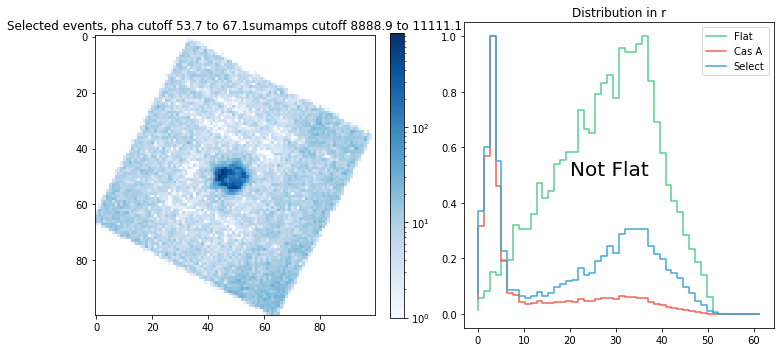

length of selection 76
length of selection 99
length of selection 104


<Figure size 432x288 with 0 Axes>

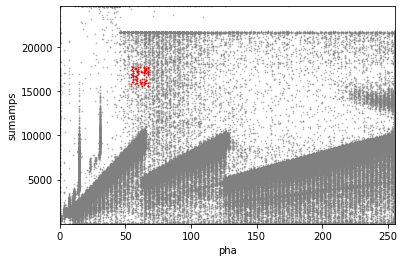

p-value comparing radial distribution to flat 0.001124920295006686
p-value comparing radial distribution to all events 0.001124920295006686


<Figure size 432x288 with 0 Axes>

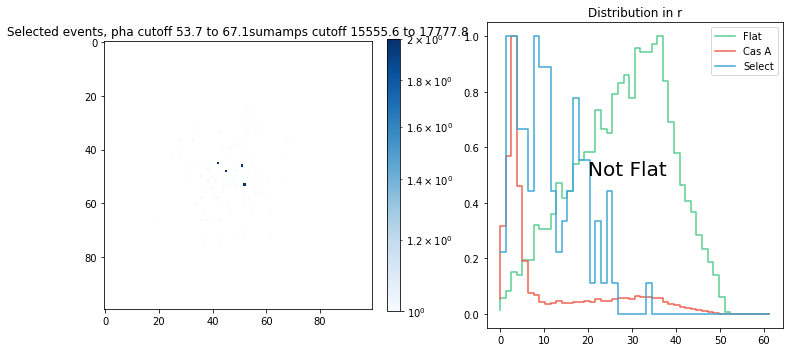

length of selection 138


<Figure size 432x288 with 0 Axes>

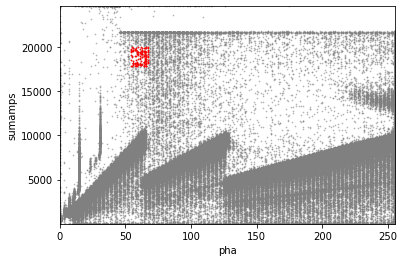

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

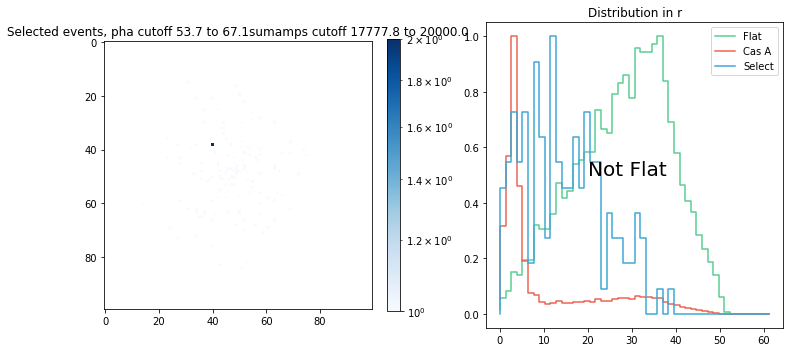

length of selection 365


<Figure size 432x288 with 0 Axes>

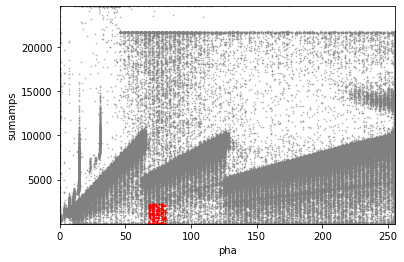

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 6.799975926646917e-09


<Figure size 432x288 with 0 Axes>

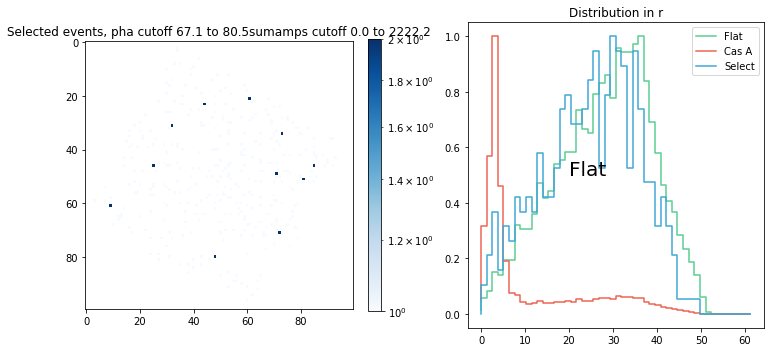

length of selection 753


<Figure size 432x288 with 0 Axes>

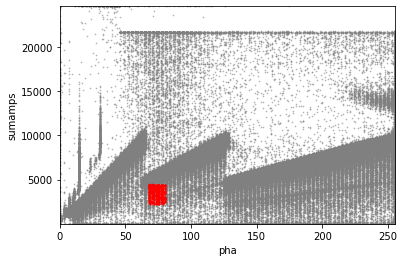

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

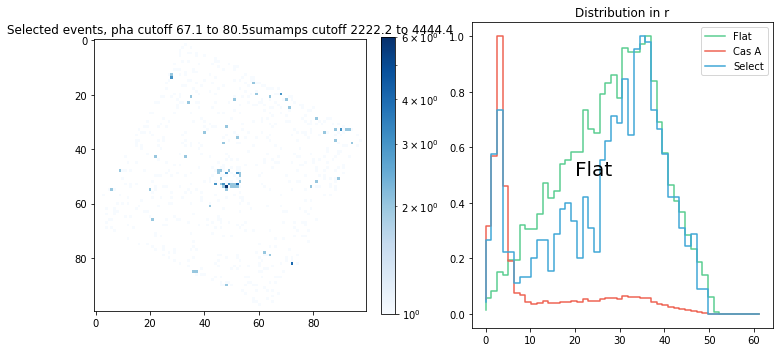

length of selection 230133


<Figure size 432x288 with 0 Axes>

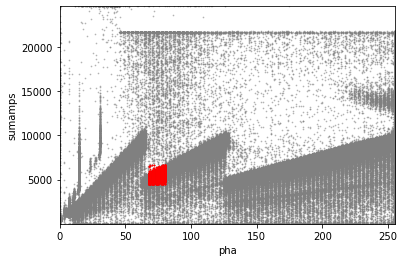

p-value comparing radial distribution to flat 3.4917876383331924e-07
p-value comparing radial distribution to all events 1.1538080891883593e-06


<Figure size 432x288 with 0 Axes>

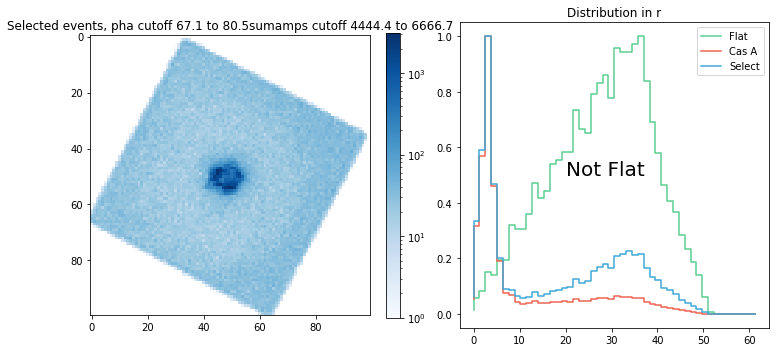

length of selection 135


<Figure size 432x288 with 0 Axes>

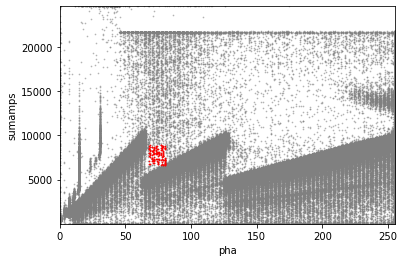

p-value comparing radial distribution to flat 2.9965727393247677e-05
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

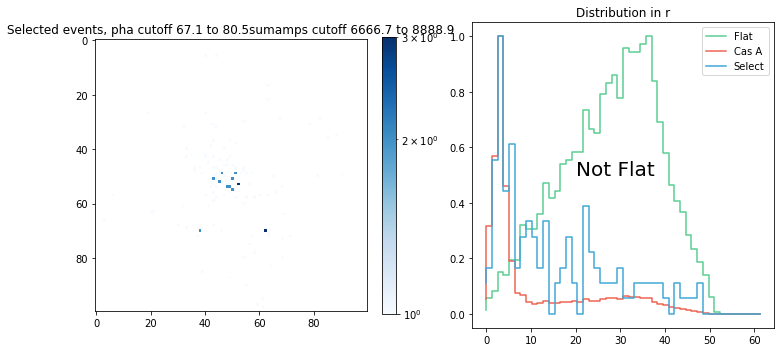

length of selection 148


<Figure size 432x288 with 0 Axes>

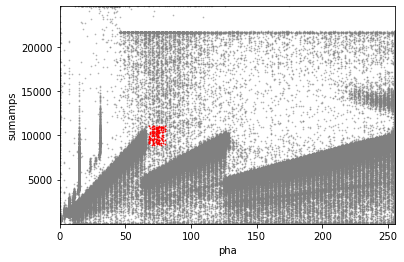

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

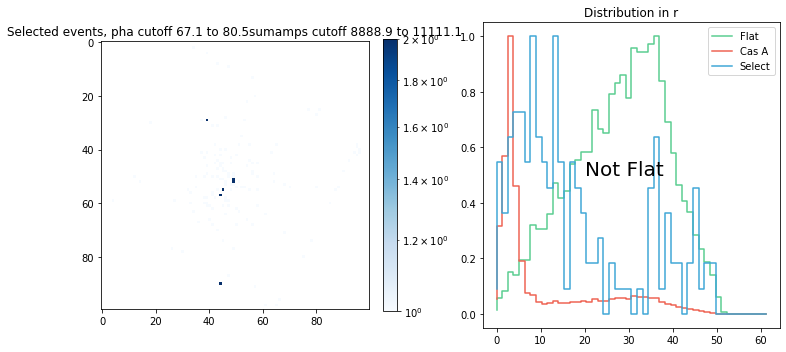

length of selection 155


<Figure size 432x288 with 0 Axes>

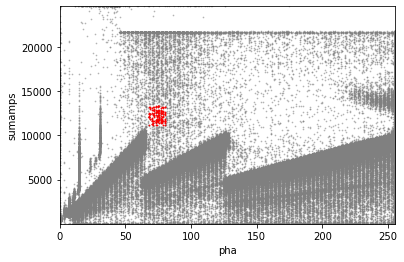

p-value comparing radial distribution to flat 0.005166468598651642
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

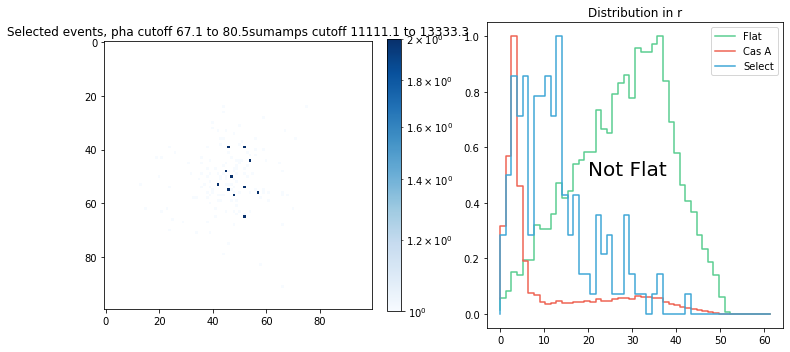

length of selection 166


<Figure size 432x288 with 0 Axes>

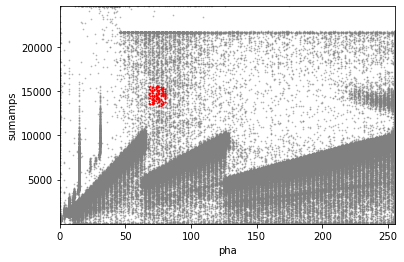

p-value comparing radial distribution to flat 0.001124920295006686
p-value comparing radial distribution to all events 0.001124920295006686


<Figure size 432x288 with 0 Axes>

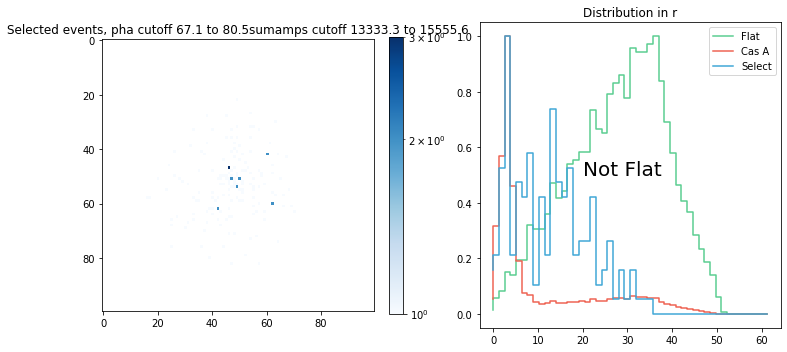

length of selection 180


<Figure size 432x288 with 0 Axes>

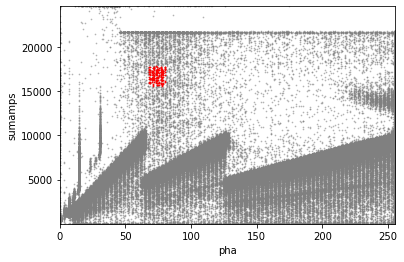

p-value comparing radial distribution to flat 0.010332936867101364
p-value comparing radial distribution to all events 0.001124920295006686


<Figure size 432x288 with 0 Axes>

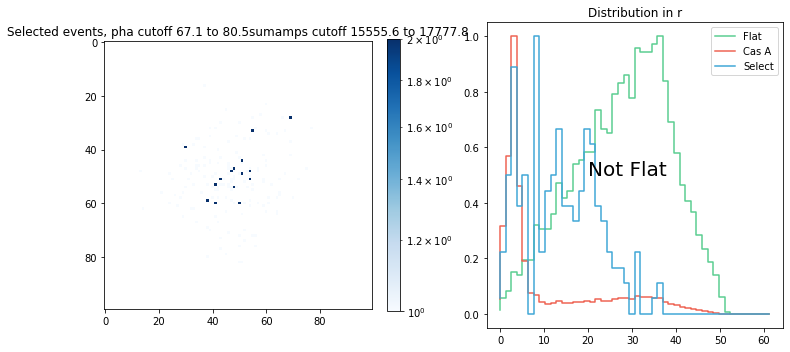

length of selection 201


<Figure size 432x288 with 0 Axes>

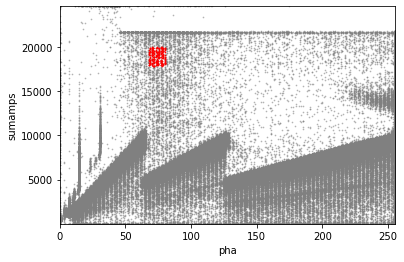

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 7.990860638199379e-05


<Figure size 432x288 with 0 Axes>

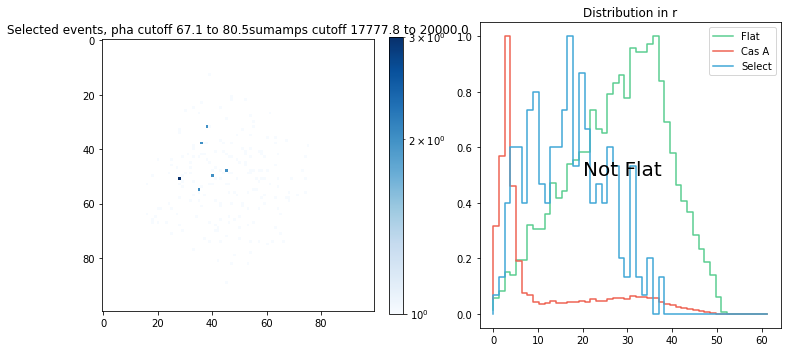

length of selection 341


<Figure size 432x288 with 0 Axes>

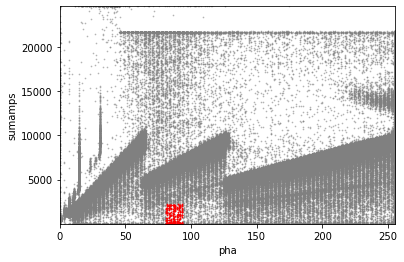

p-value comparing radial distribution to flat 0.10591425451435192
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

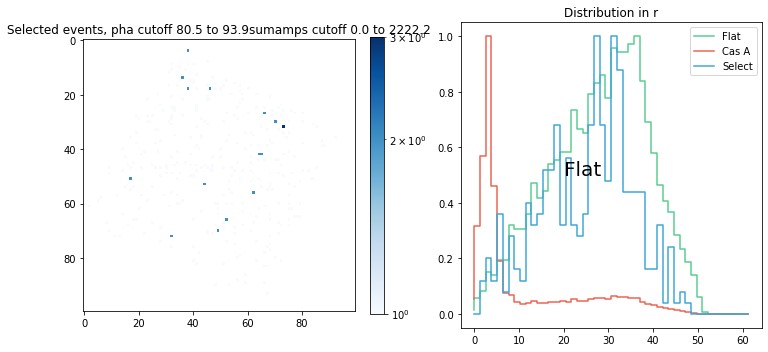

length of selection 487


<Figure size 432x288 with 0 Axes>

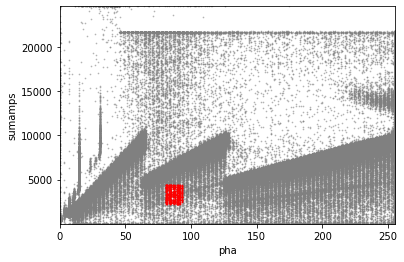

p-value comparing radial distribution to flat 0.9636034058516135
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

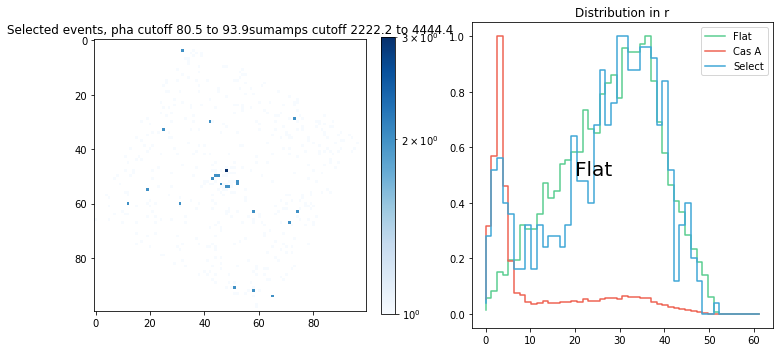

length of selection 168725


<Figure size 432x288 with 0 Axes>

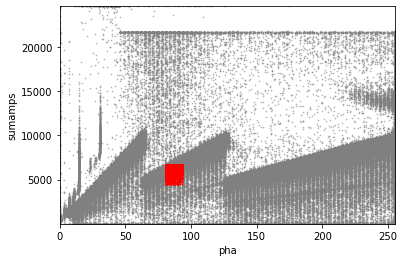

p-value comparing radial distribution to flat 6.799975926646917e-09
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

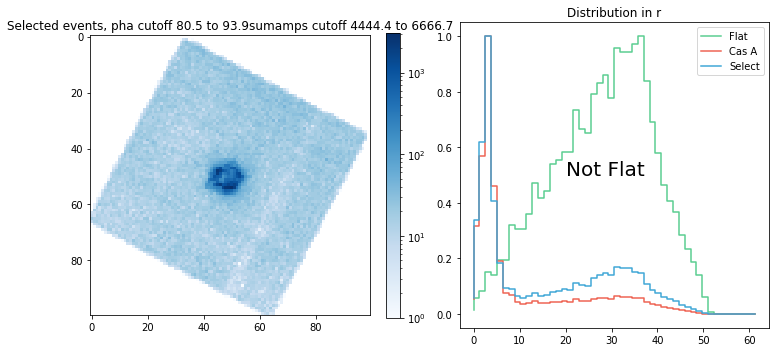

length of selection 94879


<Figure size 432x288 with 0 Axes>

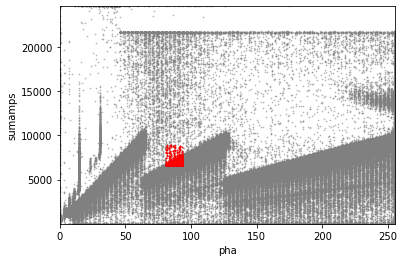

p-value comparing radial distribution to flat 2.6859904910255327e-08
p-value comparing radial distribution to all events 0.00020262539475434033


<Figure size 432x288 with 0 Axes>

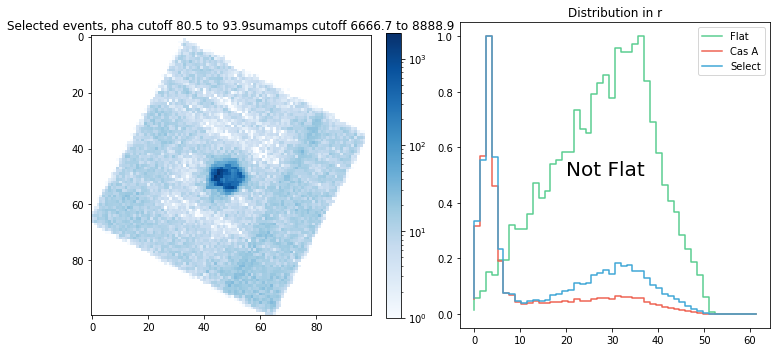

length of selection 113


<Figure size 432x288 with 0 Axes>

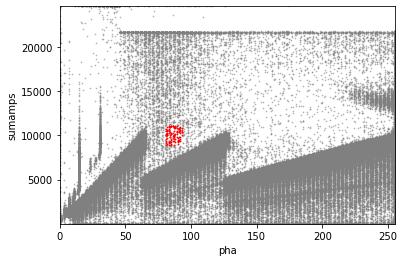

p-value comparing radial distribution to flat 0.005166468598651642
p-value comparing radial distribution to all events 0.00020262539475434033


<Figure size 432x288 with 0 Axes>

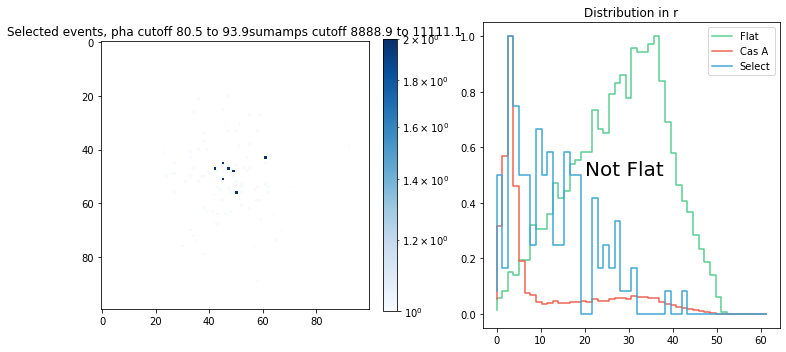

length of selection 128


<Figure size 432x288 with 0 Axes>

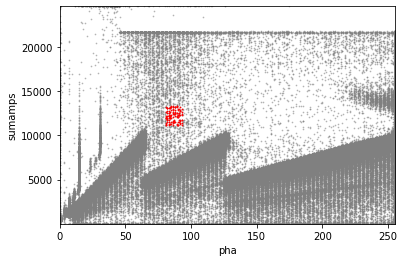

p-value comparing radial distribution to flat 0.010332936867101364
p-value comparing radial distribution to all events 7.990860638199379e-05


<Figure size 432x288 with 0 Axes>

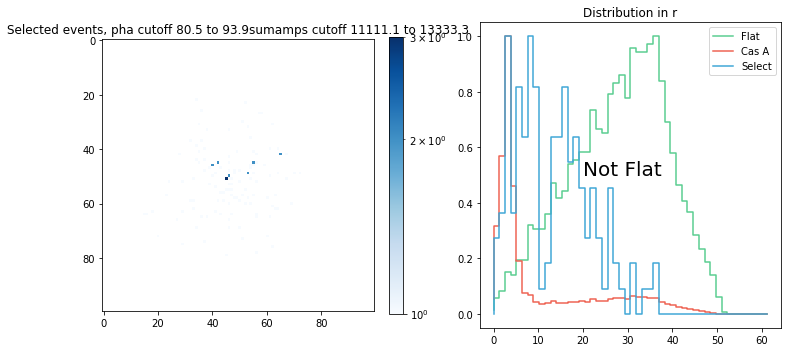

length of selection 140


<Figure size 432x288 with 0 Axes>

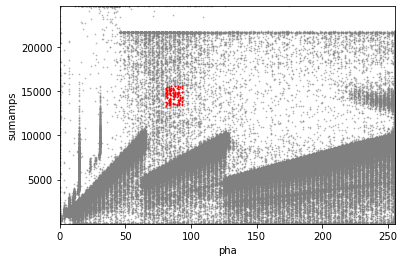

p-value comparing radial distribution to flat 0.019754137896767714
p-value comparing radial distribution to all events 7.990860638199379e-05


<Figure size 432x288 with 0 Axes>

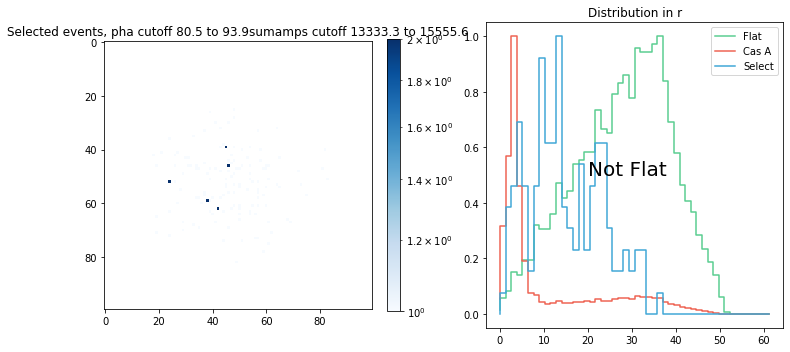

length of selection 149


<Figure size 432x288 with 0 Axes>

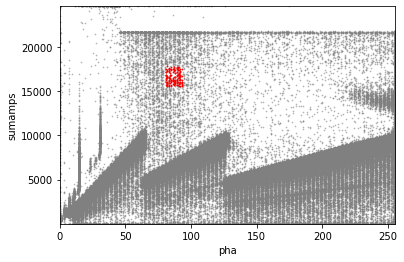

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 1.0672724824992323e-05


<Figure size 432x288 with 0 Axes>

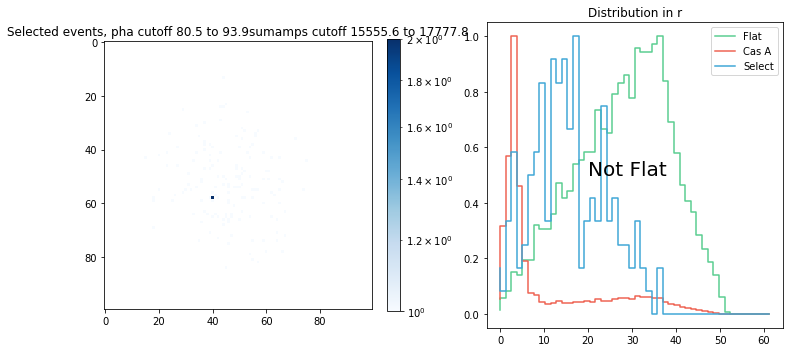

length of selection 174


<Figure size 432x288 with 0 Axes>

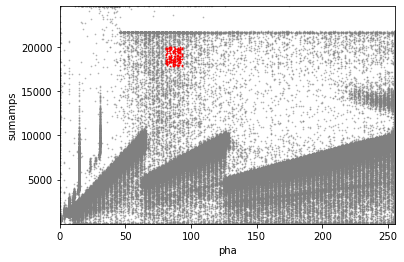

p-value comparing radial distribution to flat 0.10591425451435192
p-value comparing radial distribution to all events 1.0672724824992323e-05


<Figure size 432x288 with 0 Axes>

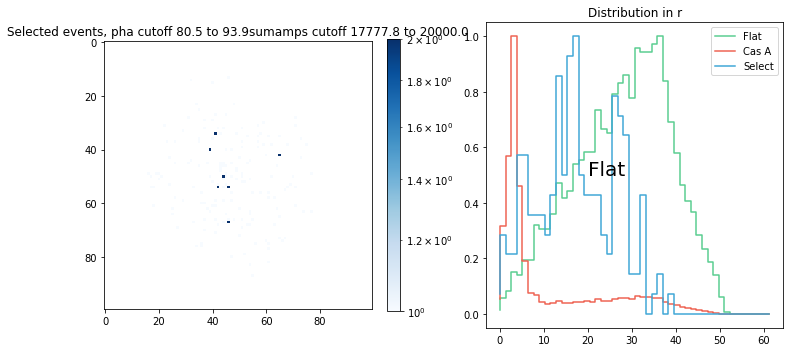

length of selection 302


<Figure size 432x288 with 0 Axes>

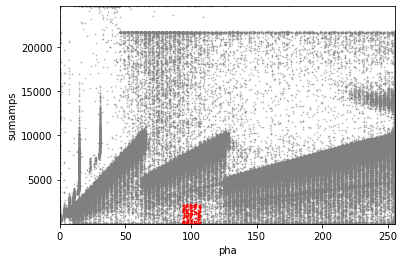

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

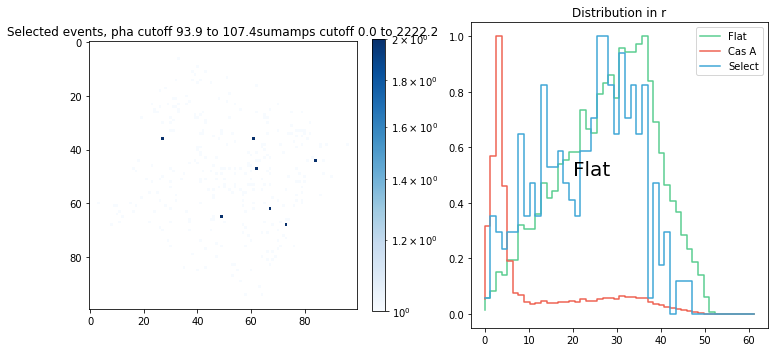

length of selection 490


<Figure size 432x288 with 0 Axes>

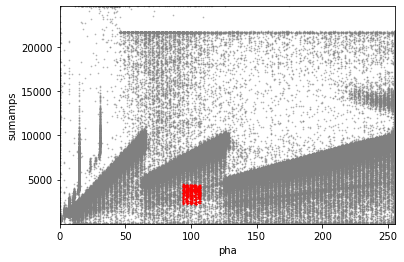

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

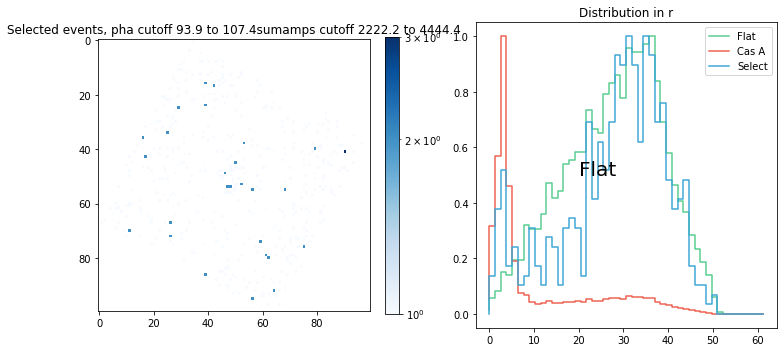

length of selection 1907


<Figure size 432x288 with 0 Axes>

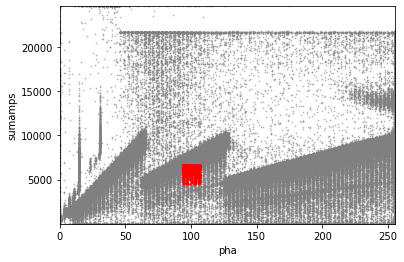

p-value comparing radial distribution to flat 0.06321210922149156
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

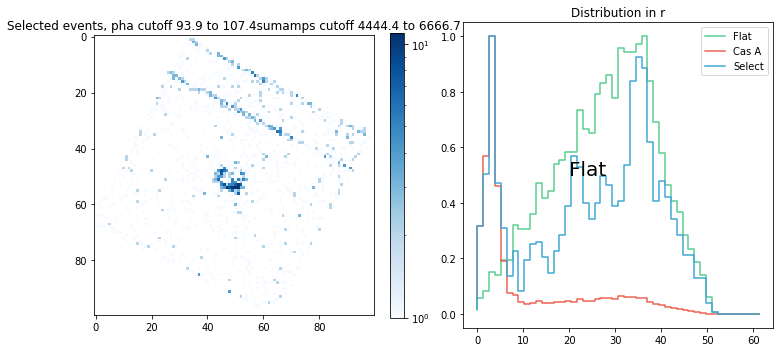

length of selection 319276


<Figure size 432x288 with 0 Axes>

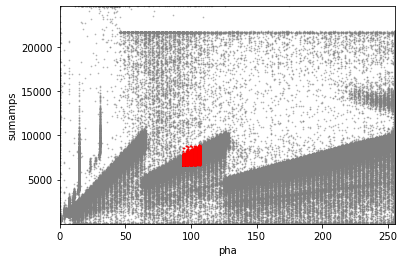

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.002467567098321789


<Figure size 432x288 with 0 Axes>

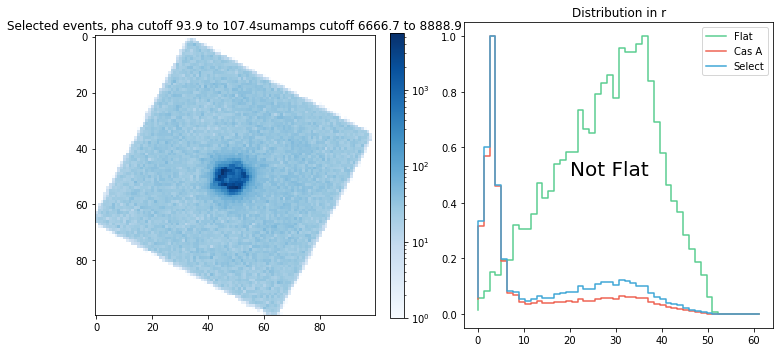

length of selection 80
length of selection 96
length of selection 75
length of selection 101


<Figure size 432x288 with 0 Axes>

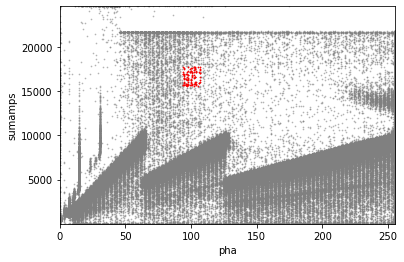

p-value comparing radial distribution to flat 0.010332936867101364
p-value comparing radial distribution to all events 7.990860638199379e-05


<Figure size 432x288 with 0 Axes>

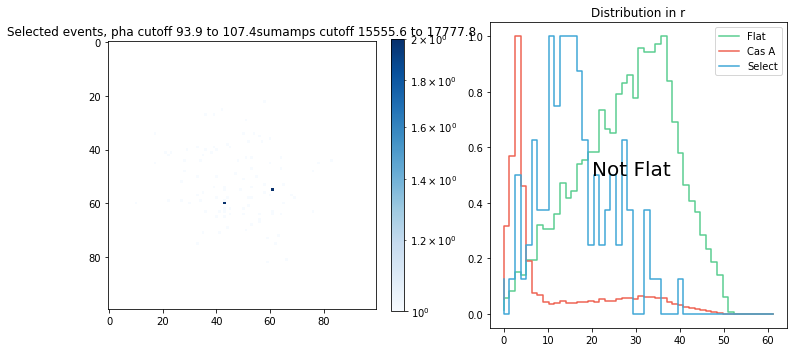

length of selection 116


<Figure size 432x288 with 0 Axes>

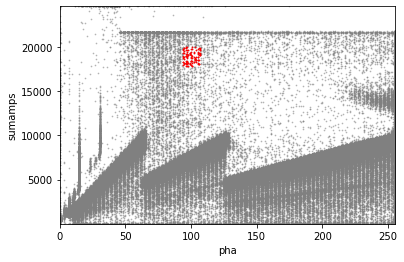

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

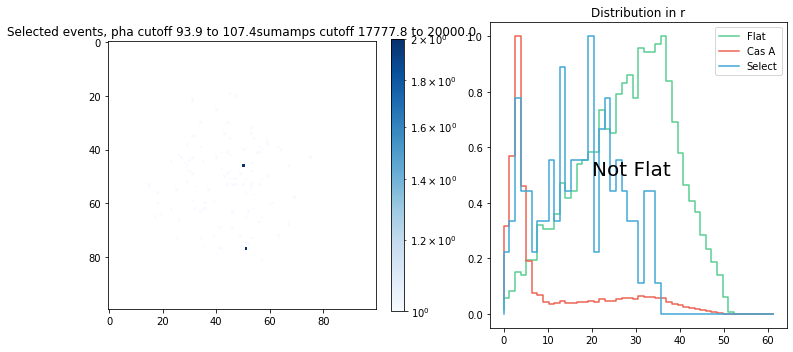

length of selection 258


<Figure size 432x288 with 0 Axes>

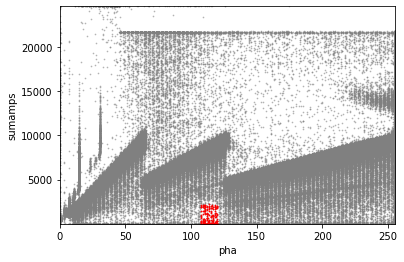

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

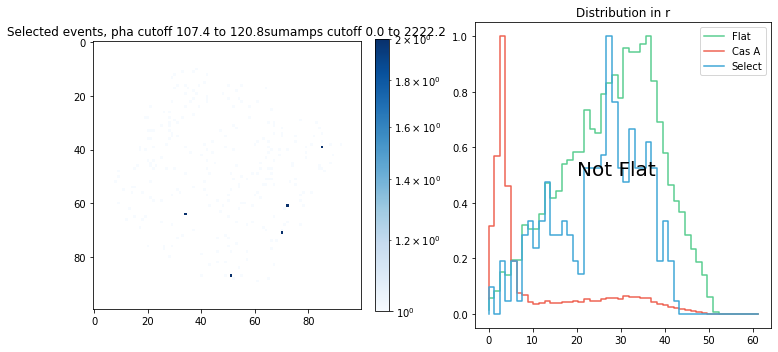

length of selection 368


<Figure size 432x288 with 0 Axes>

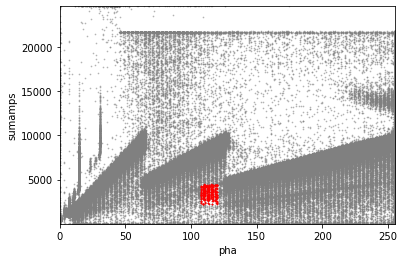

p-value comparing radial distribution to flat 0.06321210922149156
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

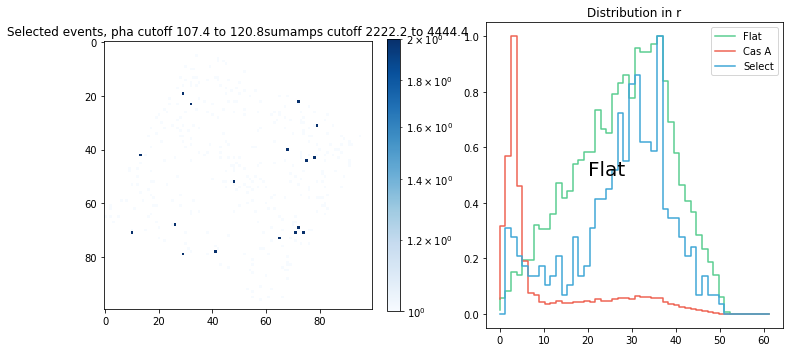

length of selection 606


<Figure size 432x288 with 0 Axes>

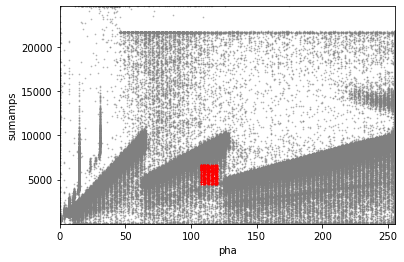

p-value comparing radial distribution to flat 0.997345059724473
p-value comparing radial distribution to all events 2.5612230854975707e-12


<Figure size 432x288 with 0 Axes>

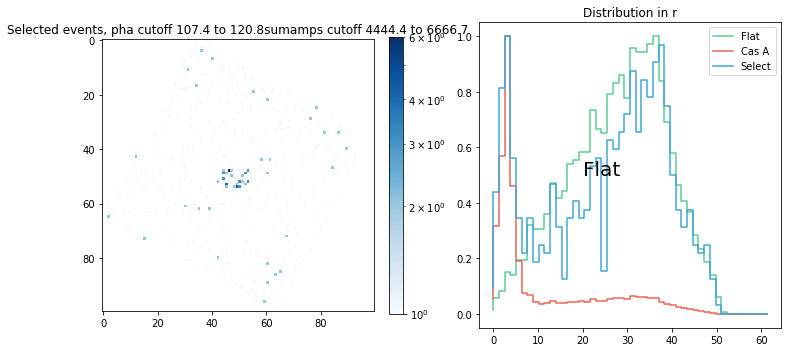

length of selection 286628


<Figure size 432x288 with 0 Axes>

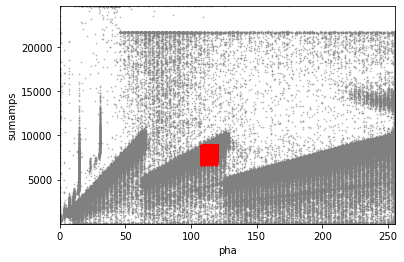

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.005166468598651642


<Figure size 432x288 with 0 Axes>

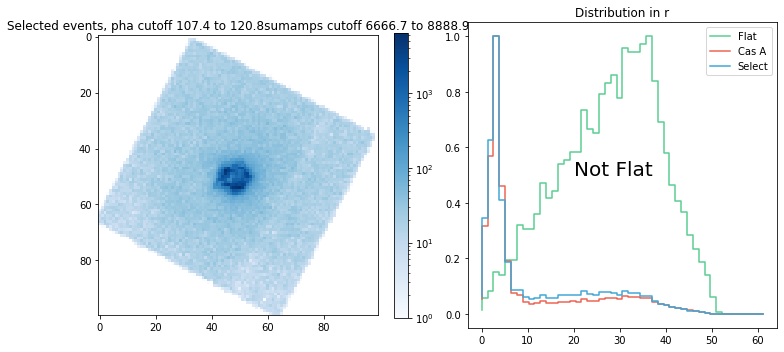

length of selection 53148


<Figure size 432x288 with 0 Axes>

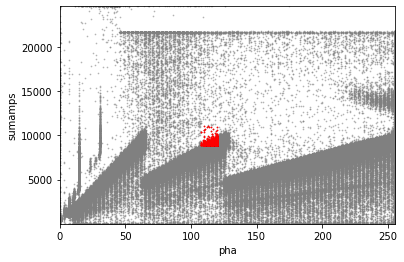

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.06321210922149156


<Figure size 432x288 with 0 Axes>

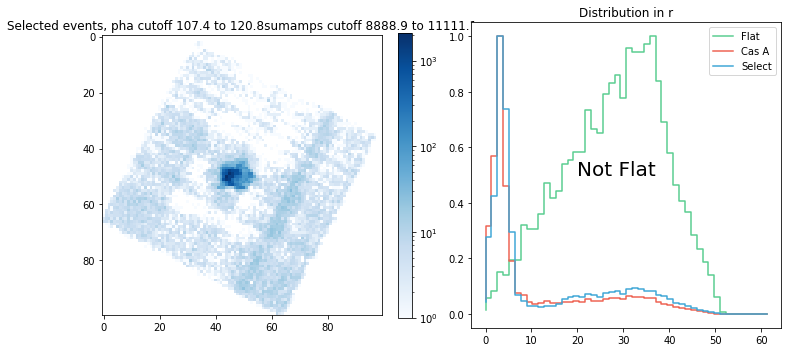

length of selection 39
length of selection 43
length of selection 41
length of selection 80
length of selection 588


<Figure size 432x288 with 0 Axes>

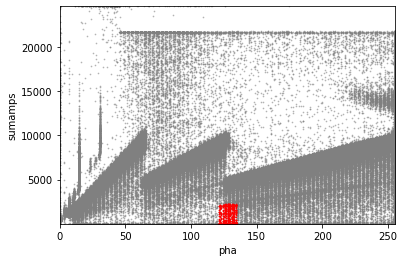

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 9.976536109523406e-08


<Figure size 432x288 with 0 Axes>

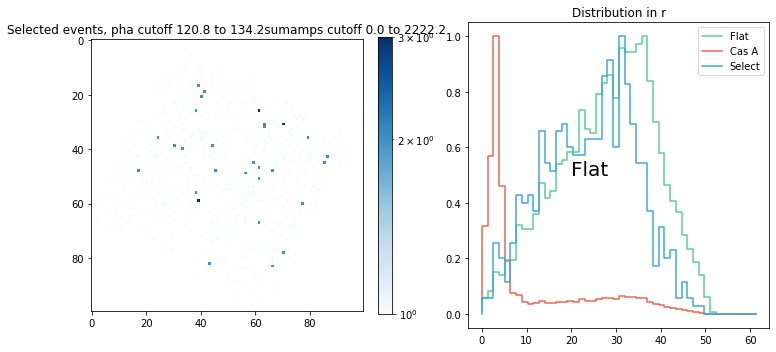

length of selection 1578


<Figure size 432x288 with 0 Axes>

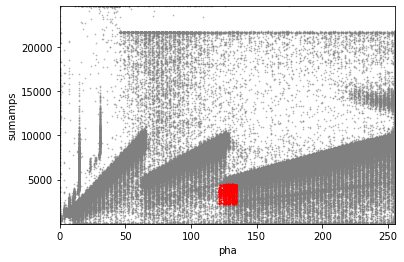

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

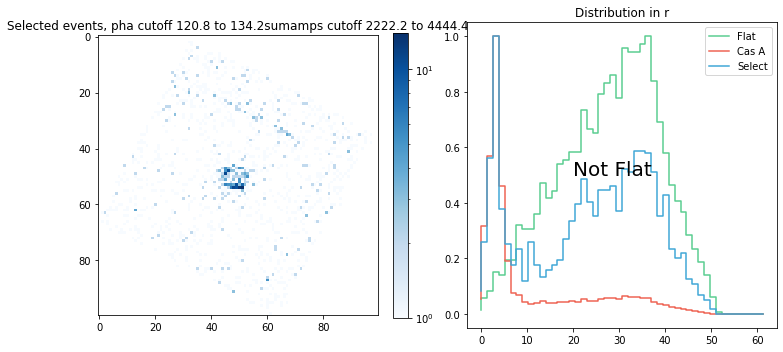

length of selection 258657


<Figure size 432x288 with 0 Axes>

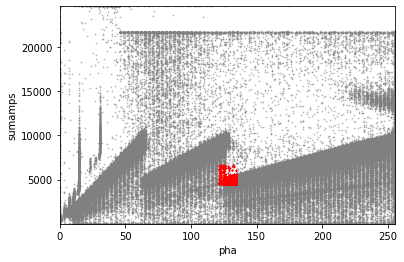

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.5355200665725597


<Figure size 432x288 with 0 Axes>

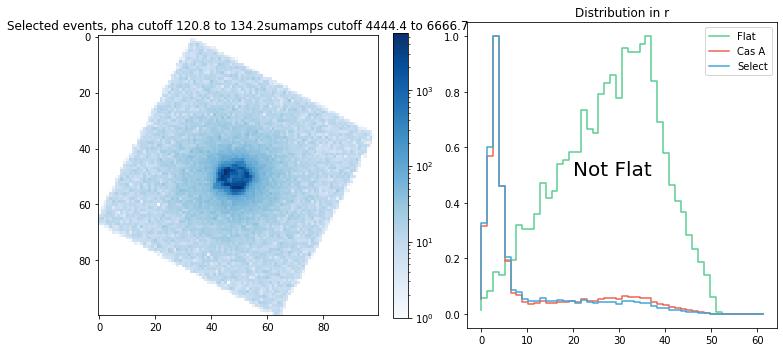

length of selection 14368


<Figure size 432x288 with 0 Axes>

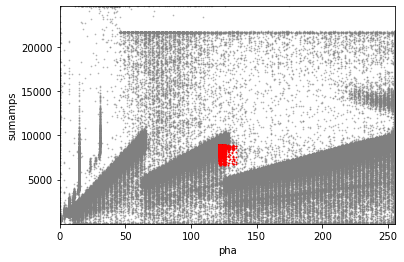

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 0.8612765597225885


<Figure size 432x288 with 0 Axes>

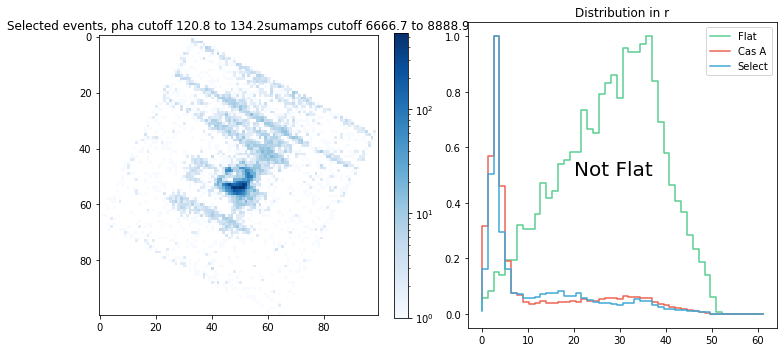

length of selection 153424


<Figure size 432x288 with 0 Axes>

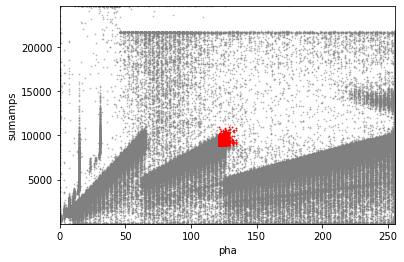

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.16995747466707573


<Figure size 432x288 with 0 Axes>

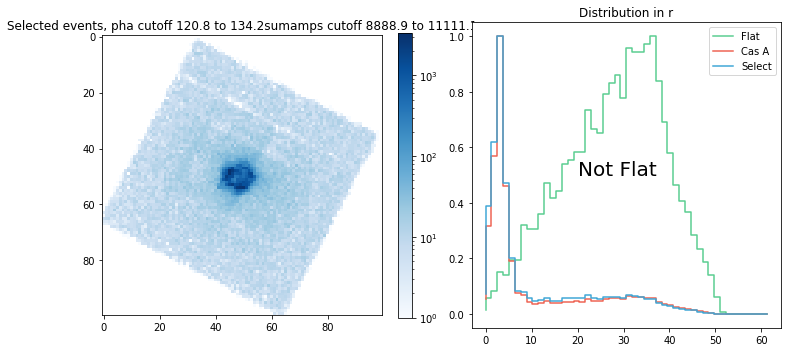

length of selection 42
length of selection 47
length of selection 28
length of selection 46
length of selection 746


<Figure size 432x288 with 0 Axes>

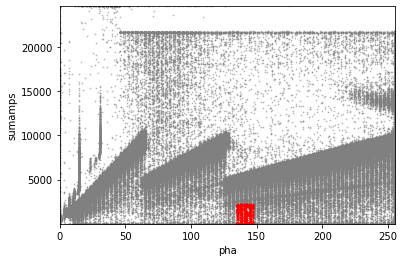

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

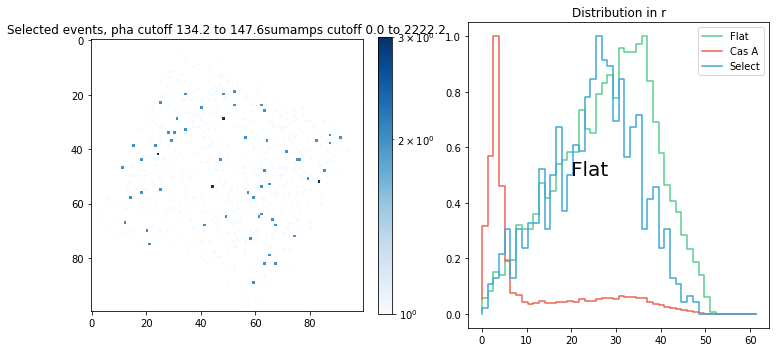

length of selection 1287


<Figure size 432x288 with 0 Axes>

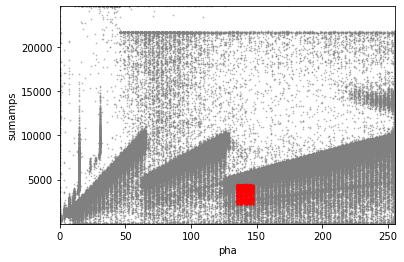

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

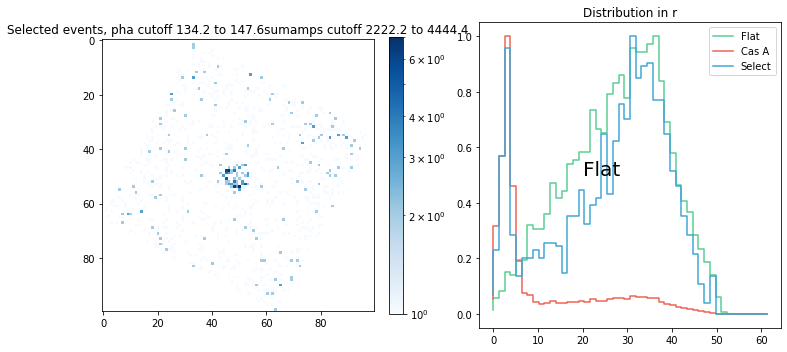

length of selection 477029


<Figure size 432x288 with 0 Axes>

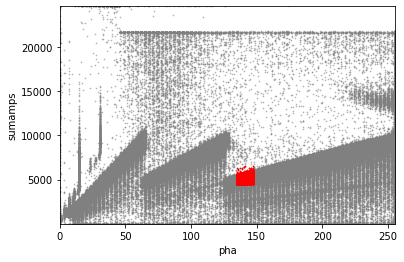

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 0.001124920295006686


<Figure size 432x288 with 0 Axes>

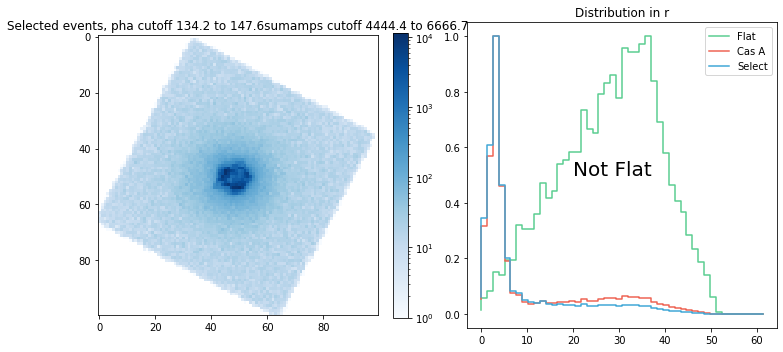

length of selection 84
length of selection 29
length of selection 32
length of selection 20
length of selection 21
length of selection 33
length of selection 663


<Figure size 432x288 with 0 Axes>

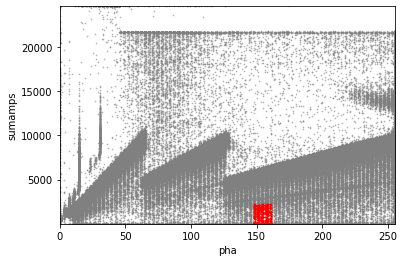

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

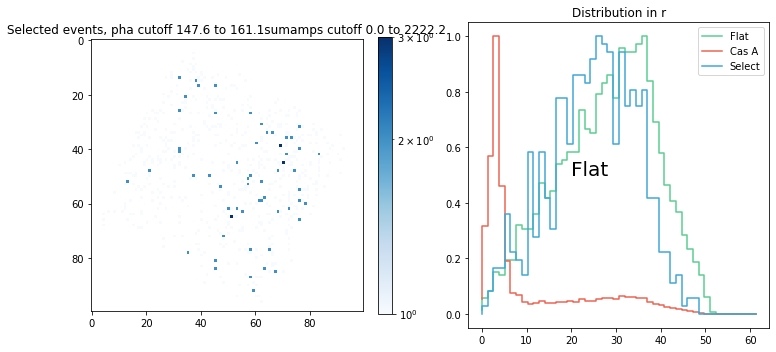

length of selection 1061


<Figure size 432x288 with 0 Axes>

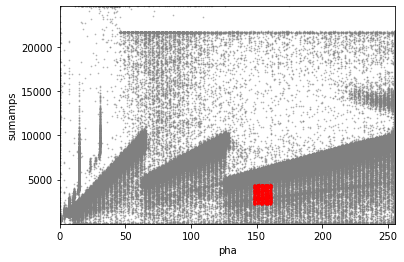

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 7.440353063370443e-11


<Figure size 432x288 with 0 Axes>

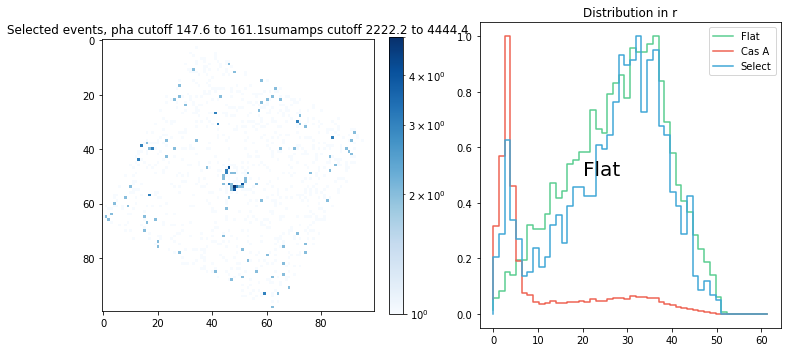

length of selection 599051


<Figure size 432x288 with 0 Axes>

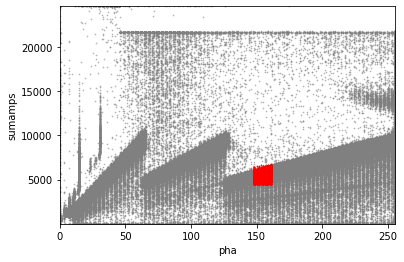

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 1.0672724824992323e-05


<Figure size 432x288 with 0 Axes>

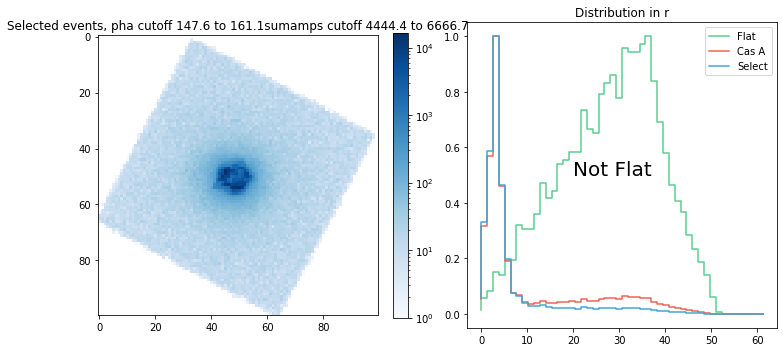

length of selection 61
length of selection 22
length of selection 16
length of selection 21
length of selection 15
length of selection 40
length of selection 570


<Figure size 432x288 with 0 Axes>

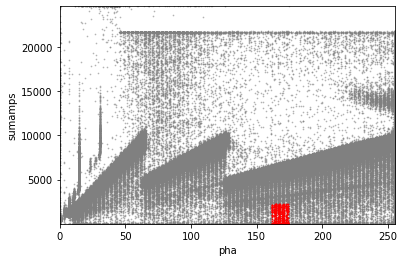

p-value comparing radial distribution to flat 0.2611068851719254
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

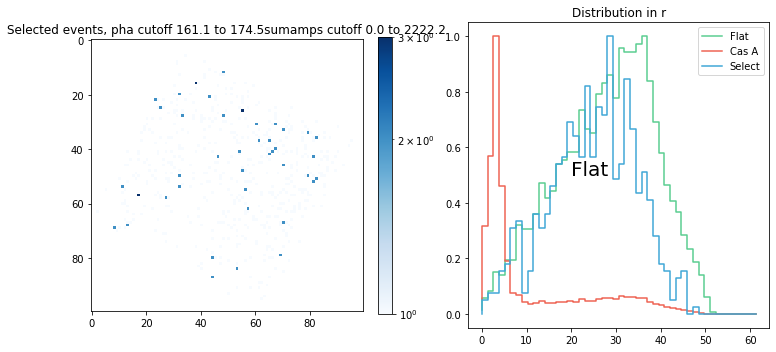

length of selection 910


<Figure size 432x288 with 0 Axes>

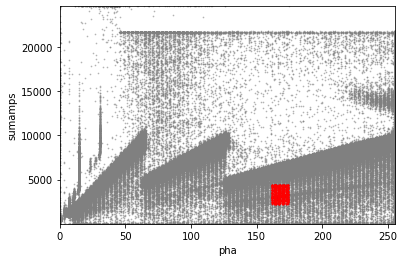

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

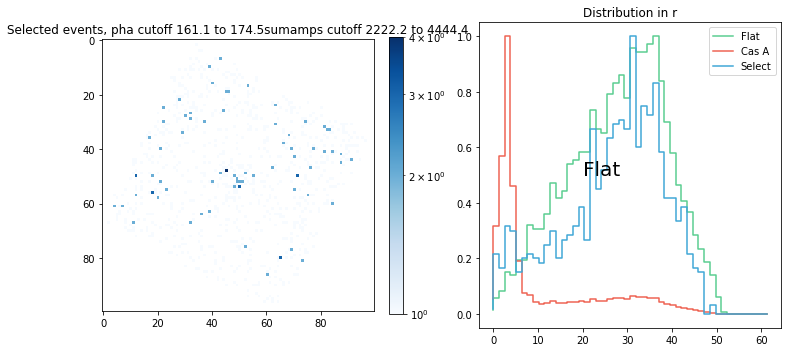

length of selection 547875


<Figure size 432x288 with 0 Axes>

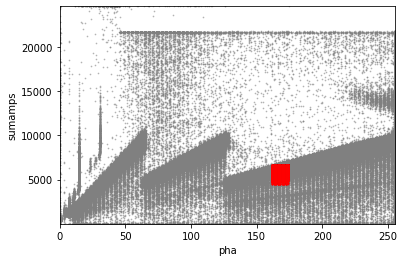

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

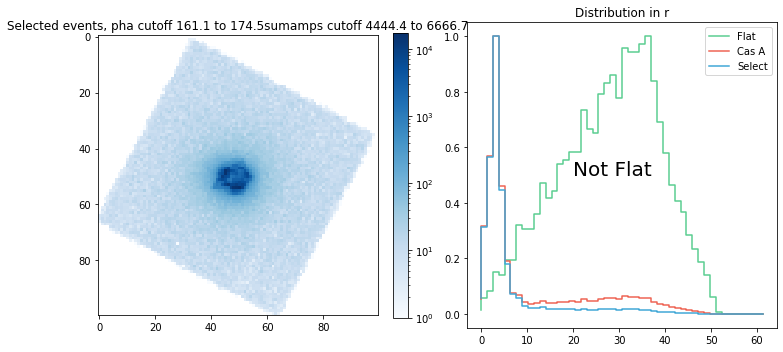

length of selection 22349


<Figure size 432x288 with 0 Axes>

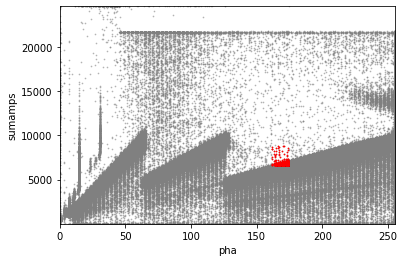

p-value comparing radial distribution to flat 2.5612230854975707e-12
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

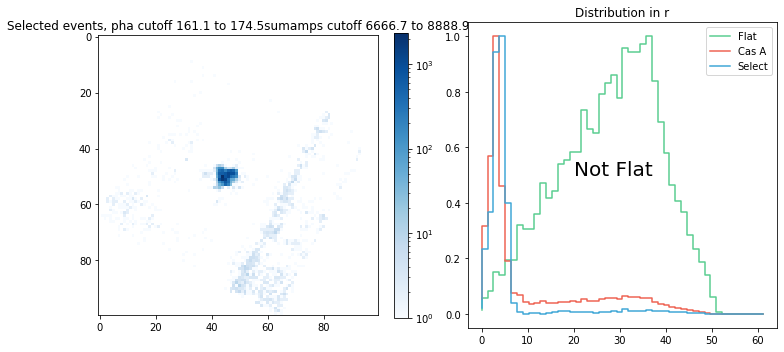

length of selection 20
length of selection 18
length of selection 20
length of selection 28
length of selection 51
length of selection 558


<Figure size 432x288 with 0 Axes>

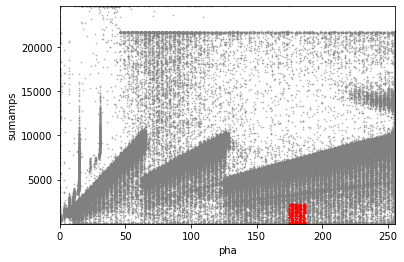

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 9.976536109523406e-08


<Figure size 432x288 with 0 Axes>

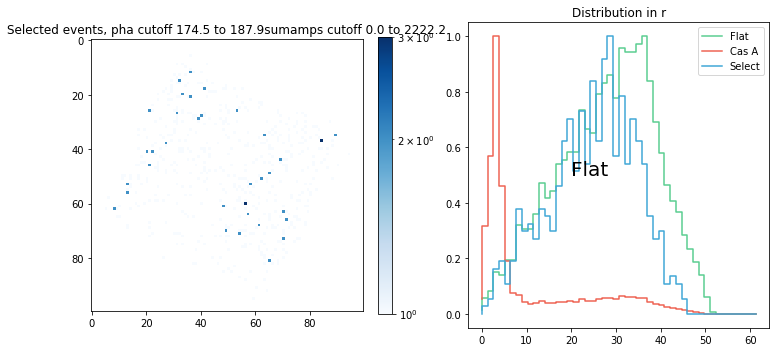

length of selection 795


<Figure size 432x288 with 0 Axes>

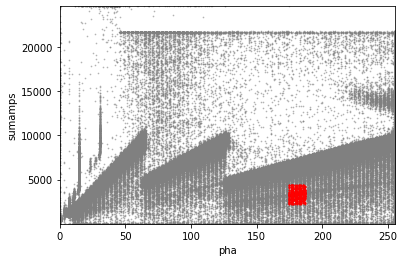

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

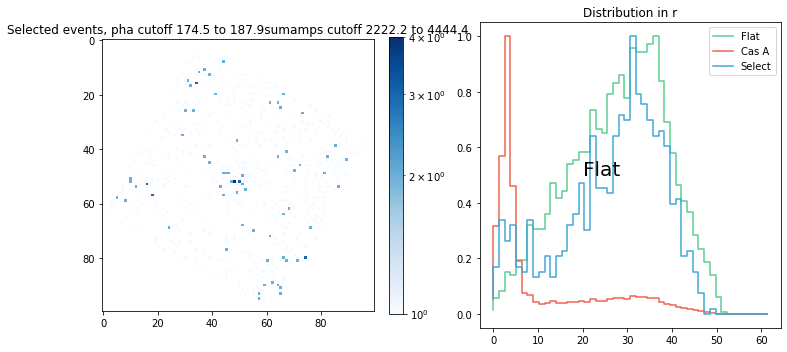

length of selection 189055


<Figure size 432x288 with 0 Axes>

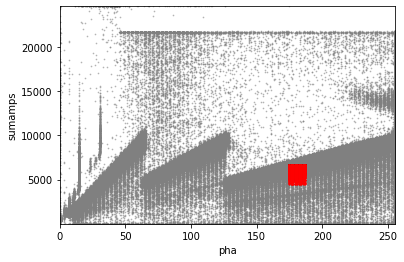

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

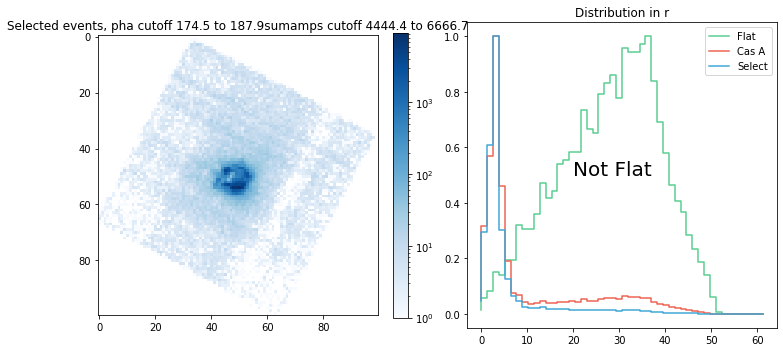

length of selection 305573


<Figure size 432x288 with 0 Axes>

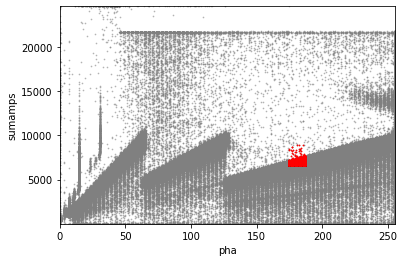

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 1.1538080891883593e-06


<Figure size 432x288 with 0 Axes>

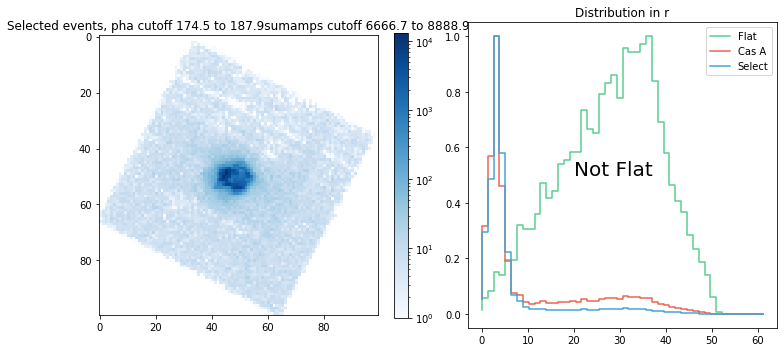

length of selection 25
length of selection 15
length of selection 13
length of selection 22
length of selection 36
length of selection 507


<Figure size 432x288 with 0 Axes>

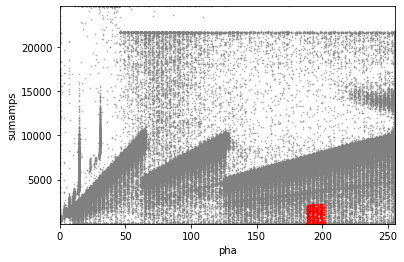

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 6.799975926646917e-09


<Figure size 432x288 with 0 Axes>

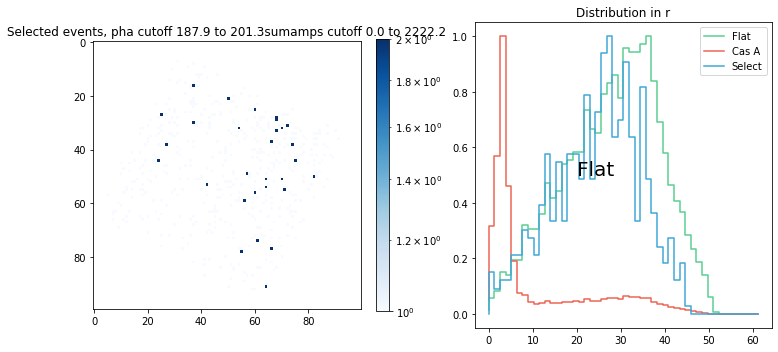

length of selection 771


<Figure size 432x288 with 0 Axes>

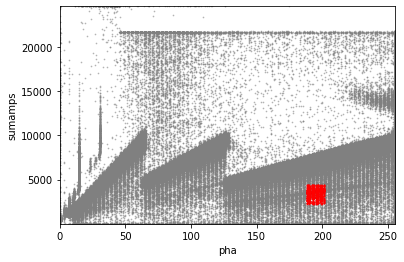

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

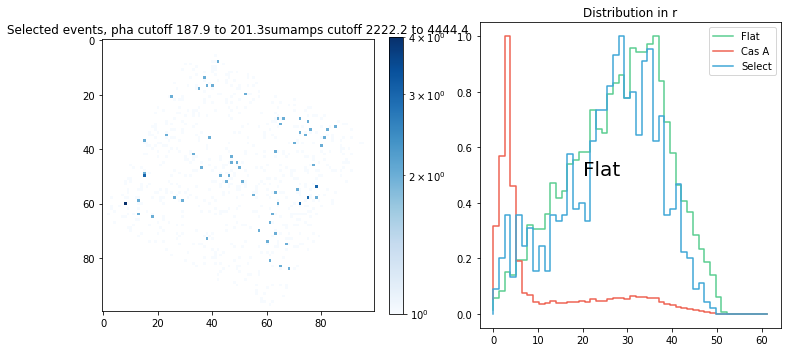

length of selection 3730


<Figure size 432x288 with 0 Axes>

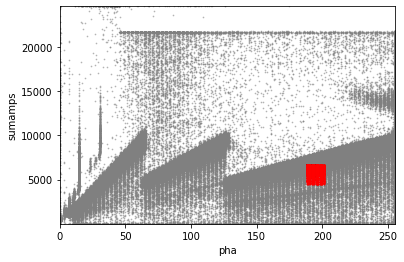

p-value comparing radial distribution to flat 9.976536109523406e-08
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

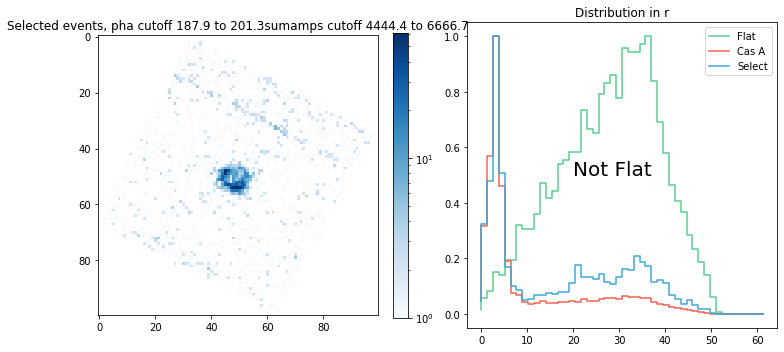

length of selection 421651


<Figure size 432x288 with 0 Axes>

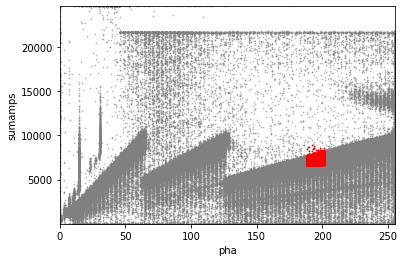

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

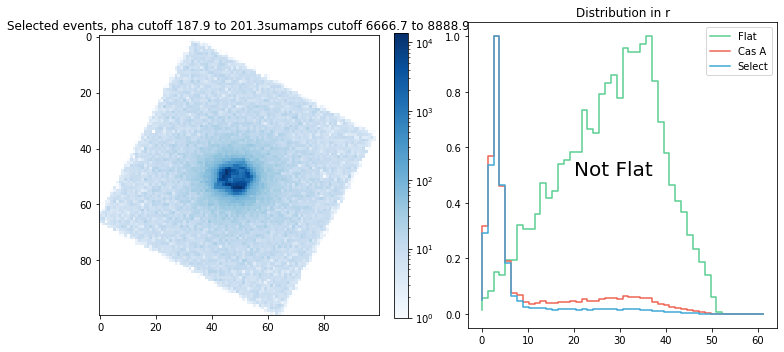

length of selection 22
length of selection 15
length of selection 17
length of selection 26
length of selection 48
length of selection 460


<Figure size 432x288 with 0 Axes>

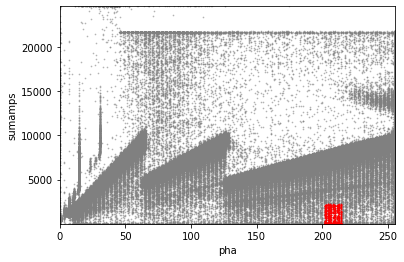

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 9.976536109523406e-08


<Figure size 432x288 with 0 Axes>

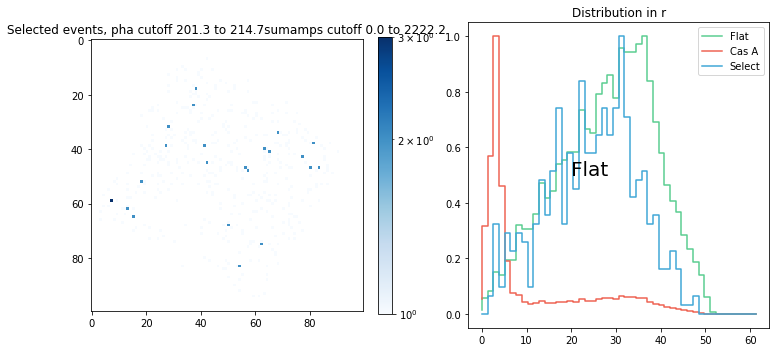

length of selection 659


<Figure size 432x288 with 0 Axes>

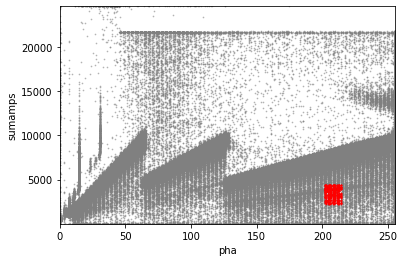

p-value comparing radial distribution to flat 0.5355200665725597
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

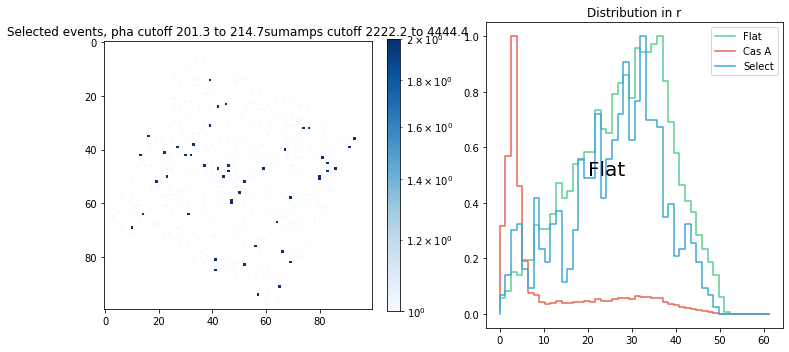

length of selection 1477


<Figure size 432x288 with 0 Axes>

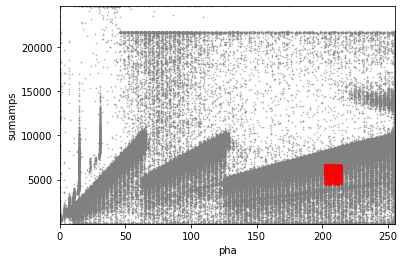

p-value comparing radial distribution to flat 2.9965727393247677e-05
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

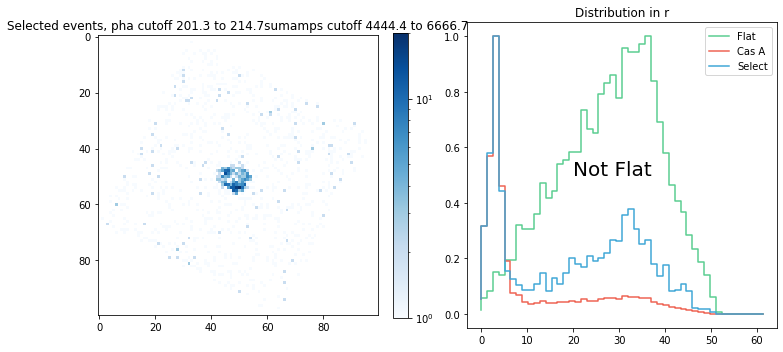

length of selection 310057


<Figure size 432x288 with 0 Axes>

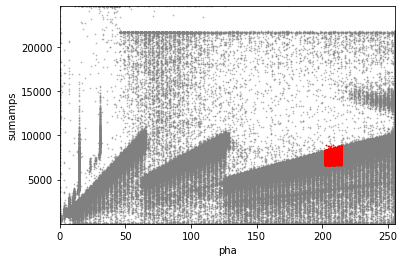

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

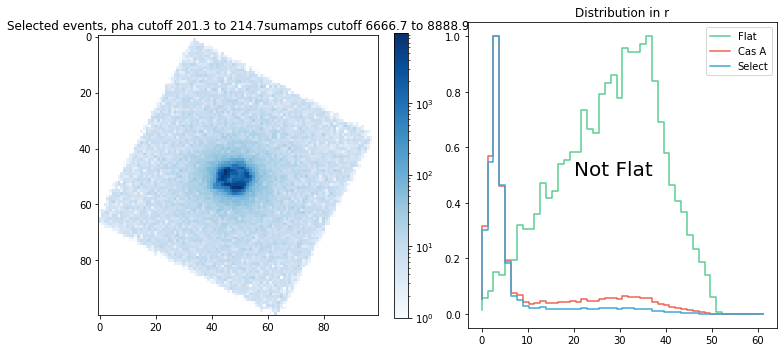

length of selection 21
length of selection 17
length of selection 19
length of selection 36
length of selection 69
length of selection 471


<Figure size 432x288 with 0 Axes>

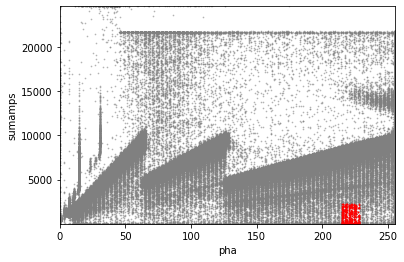

p-value comparing radial distribution to flat 0.16995747466707573
p-value comparing radial distribution to all events 1.1538080891883593e-06


<Figure size 432x288 with 0 Axes>

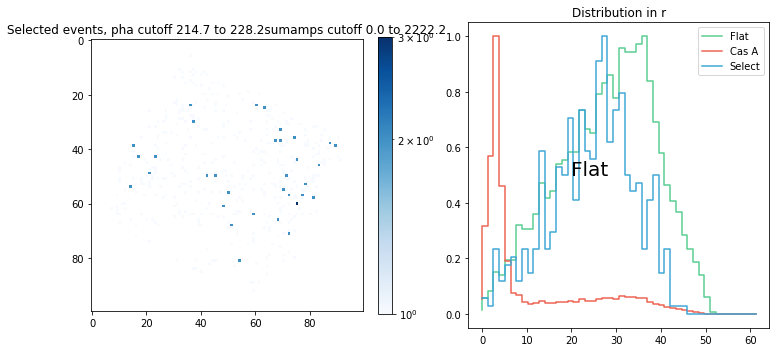

length of selection 678


<Figure size 432x288 with 0 Axes>

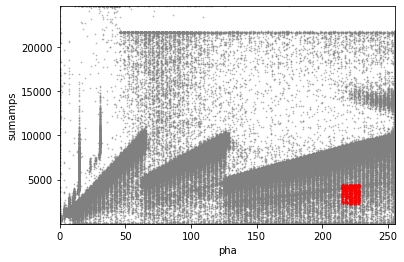

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

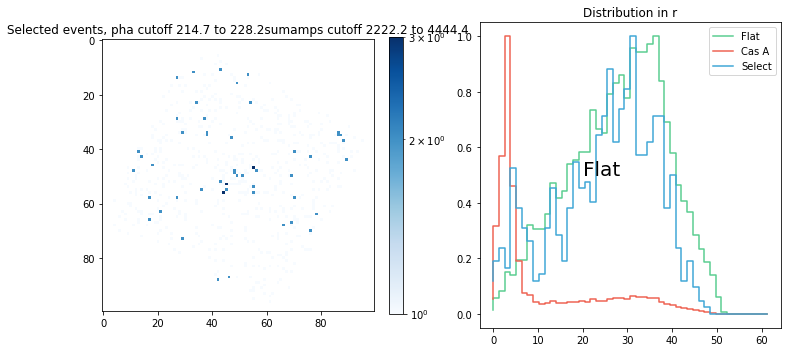

length of selection 942


<Figure size 432x288 with 0 Axes>

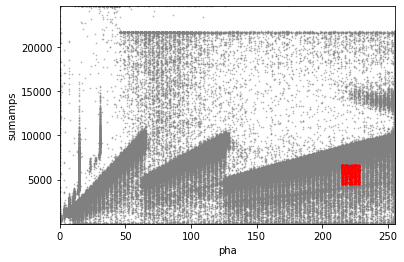

p-value comparing radial distribution to flat 0.03612176482297013
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

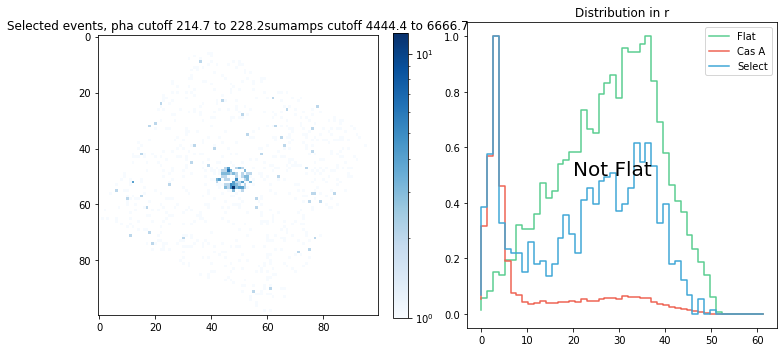

length of selection 274055


<Figure size 432x288 with 0 Axes>

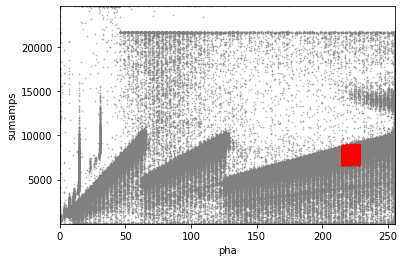

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

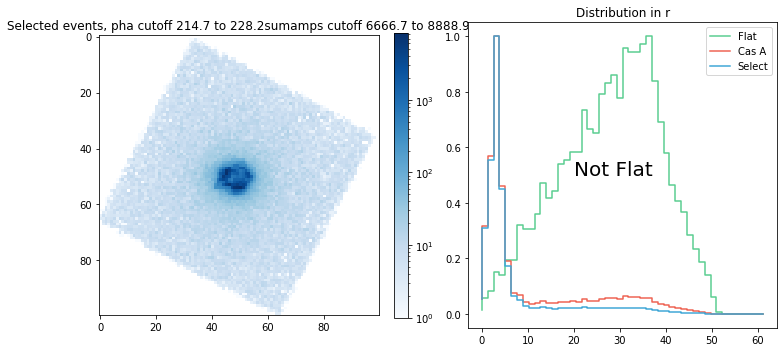

length of selection 4278


<Figure size 432x288 with 0 Axes>

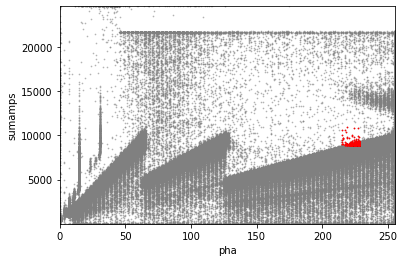

p-value comparing radial distribution to flat 2.5612230854975707e-12
p-value comparing radial distribution to all events 2.6859904910255327e-08


<Figure size 432x288 with 0 Axes>

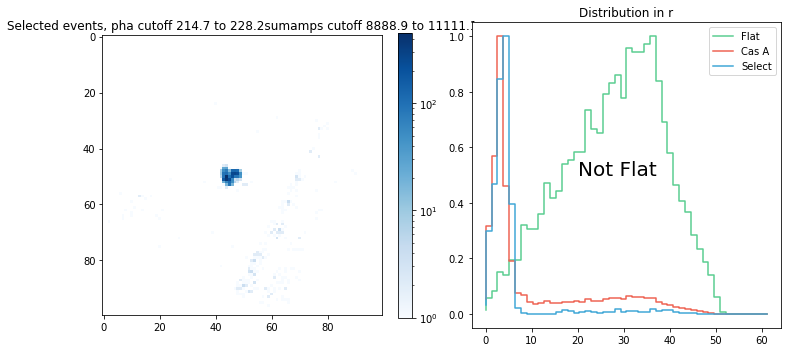

length of selection 19
length of selection 154


<Figure size 432x288 with 0 Axes>

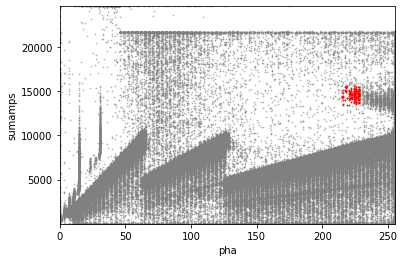

p-value comparing radial distribution to flat 3.5888761835080957e-10
p-value comparing radial distribution to all events 0.16995747466707573


<Figure size 432x288 with 0 Axes>

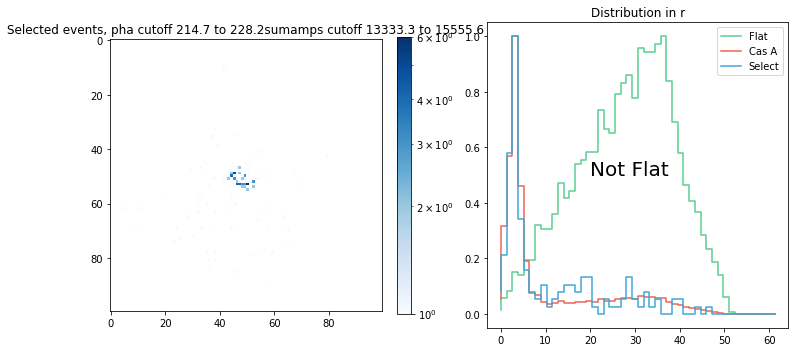

length of selection 46
length of selection 62
length of selection 346


<Figure size 432x288 with 0 Axes>

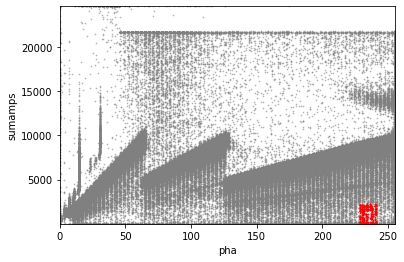

p-value comparing radial distribution to flat 0.10591425451435192
p-value comparing radial distribution to all events 3.4917876383331924e-07


<Figure size 432x288 with 0 Axes>

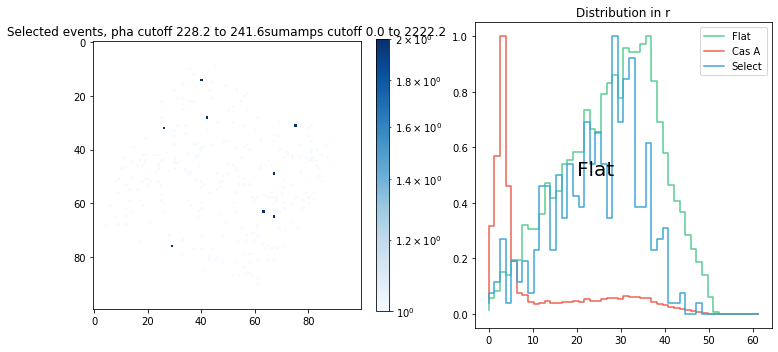

length of selection 514


<Figure size 432x288 with 0 Axes>

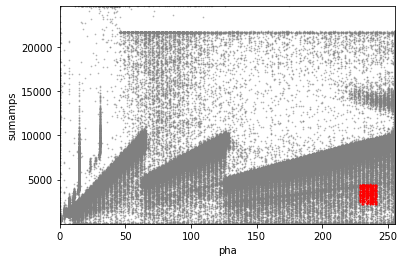

p-value comparing radial distribution to flat 0.2611068851719254
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

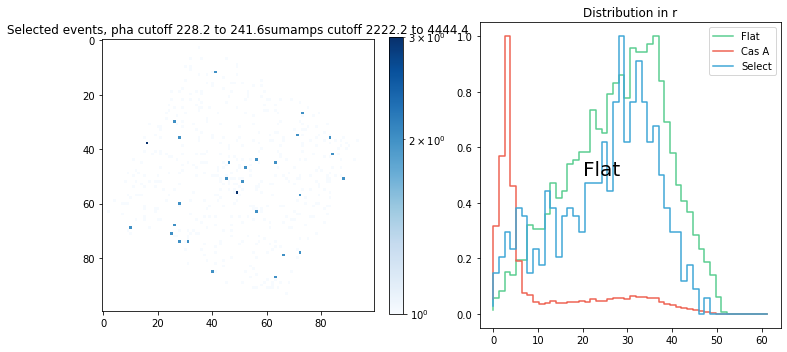

length of selection 728


<Figure size 432x288 with 0 Axes>

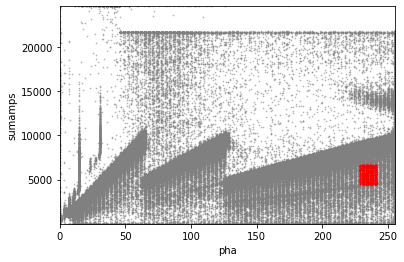

p-value comparing radial distribution to flat 0.3833868439543752
p-value comparing radial distribution to all events 3.5888761835080957e-10


<Figure size 432x288 with 0 Axes>

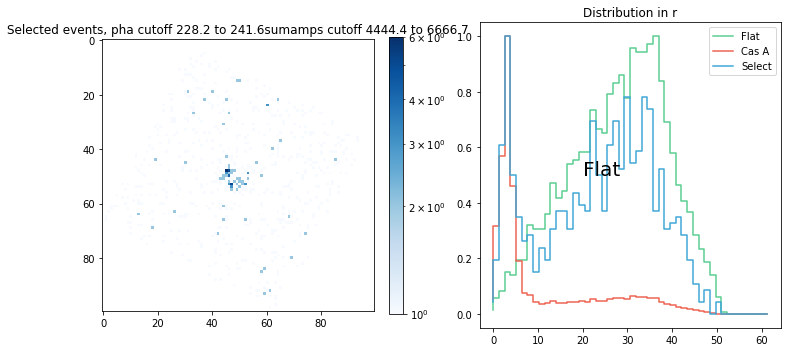

length of selection 147638


<Figure size 432x288 with 0 Axes>

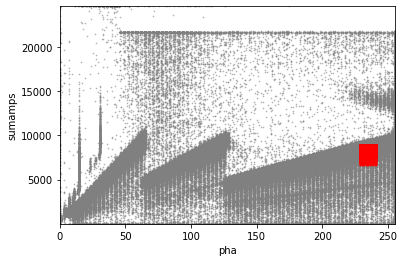

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

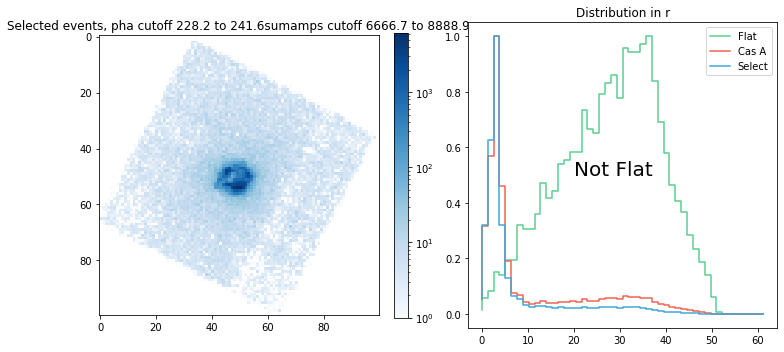

length of selection 69743


<Figure size 432x288 with 0 Axes>

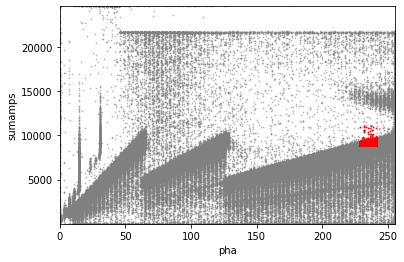

p-value comparing radial distribution to flat 1.4342849278786397e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

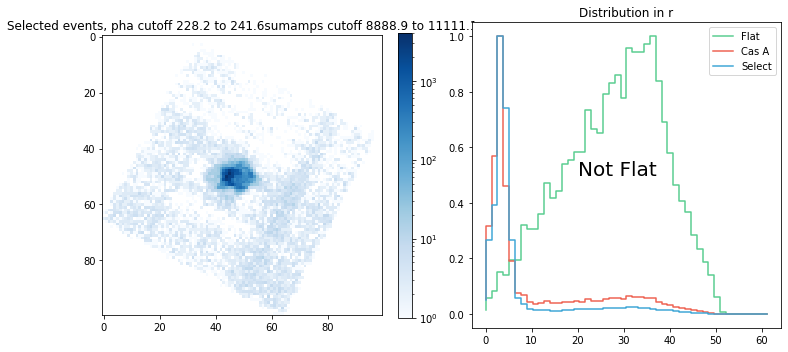

length of selection 39
length of selection 325


<Figure size 432x288 with 0 Axes>

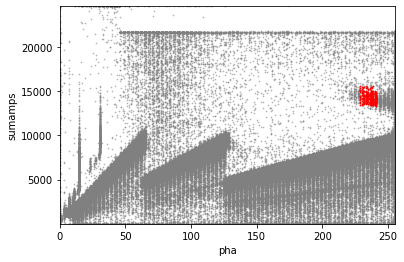

p-value comparing radial distribution to flat 1.614994282578643e-09
p-value comparing radial distribution to all events 0.010332936867101364


<Figure size 432x288 with 0 Axes>

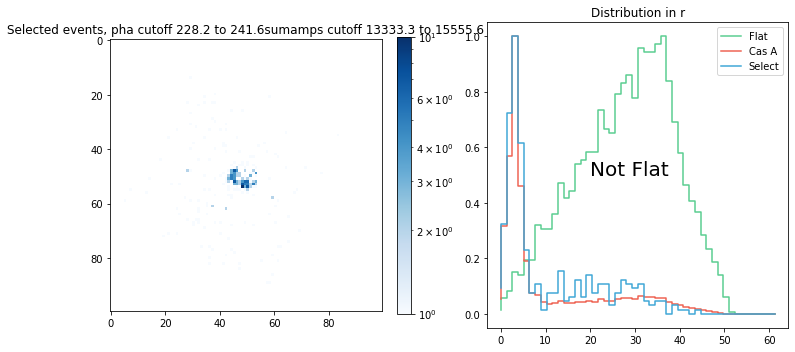

length of selection 42
length of selection 61
length of selection 310


<Figure size 432x288 with 0 Axes>

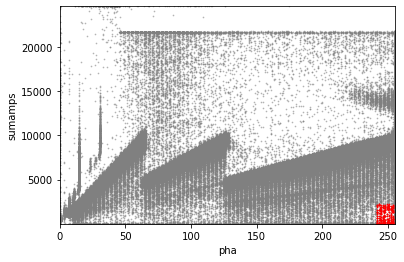

p-value comparing radial distribution to flat 0.010332936867101364
p-value comparing radial distribution to all events 3.4917876383331924e-07


<Figure size 432x288 with 0 Axes>

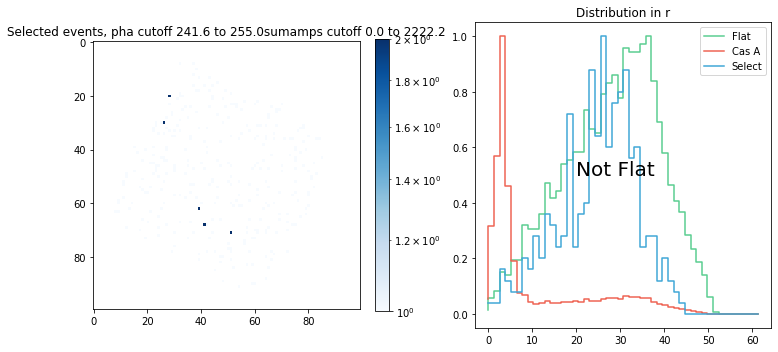

length of selection 386


<Figure size 432x288 with 0 Axes>

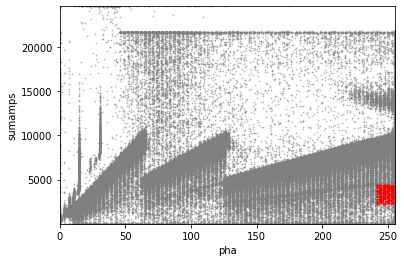

p-value comparing radial distribution to flat 0.7048666822735955
p-value comparing radial distribution to all events 6.799975926646917e-09


<Figure size 432x288 with 0 Axes>

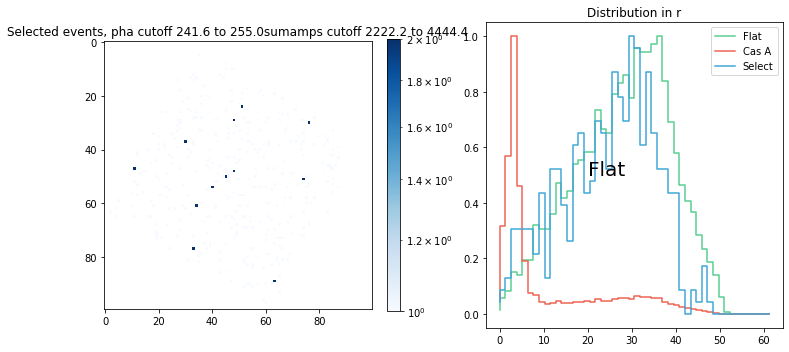

length of selection 710


<Figure size 432x288 with 0 Axes>

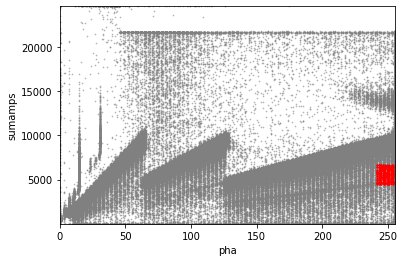

p-value comparing radial distribution to flat 0.8612765597225885
p-value comparing radial distribution to all events 1.4342849278786397e-11


<Figure size 432x288 with 0 Axes>

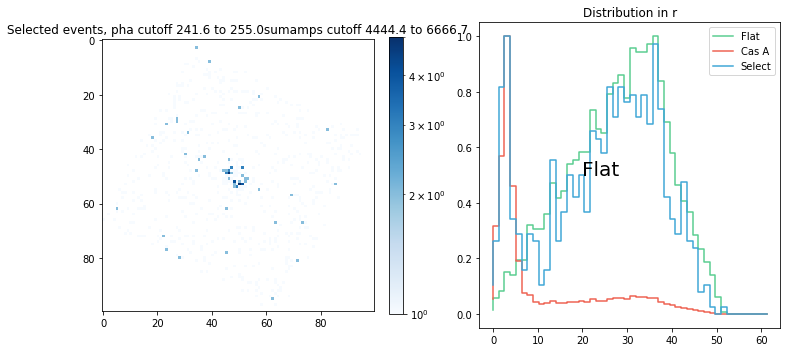

length of selection 12023


<Figure size 432x288 with 0 Axes>

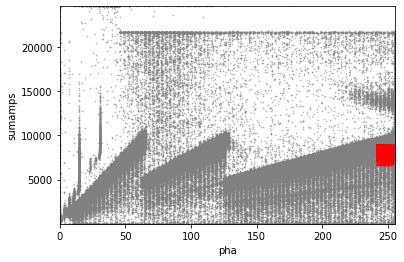

p-value comparing radial distribution to flat 2.5612230854975707e-12
p-value comparing radial distribution to all events 0.16995747466707573


<Figure size 432x288 with 0 Axes>

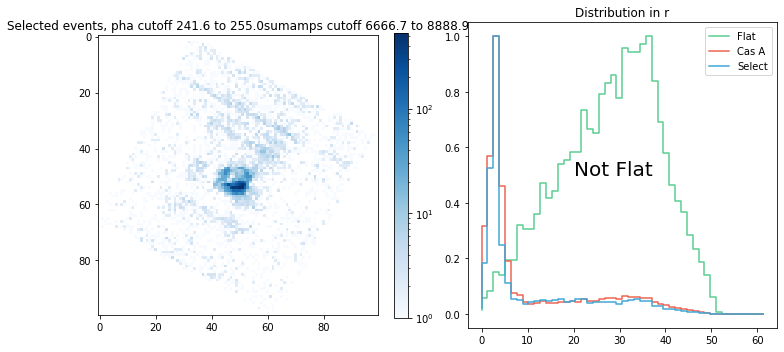

length of selection 184511


<Figure size 432x288 with 0 Axes>

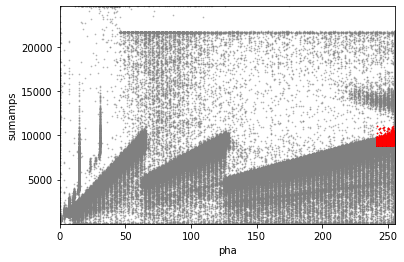

p-value comparing radial distribution to flat 7.440353063370443e-11
p-value comparing radial distribution to all events 3.605650278713622e-06


<Figure size 432x288 with 0 Axes>

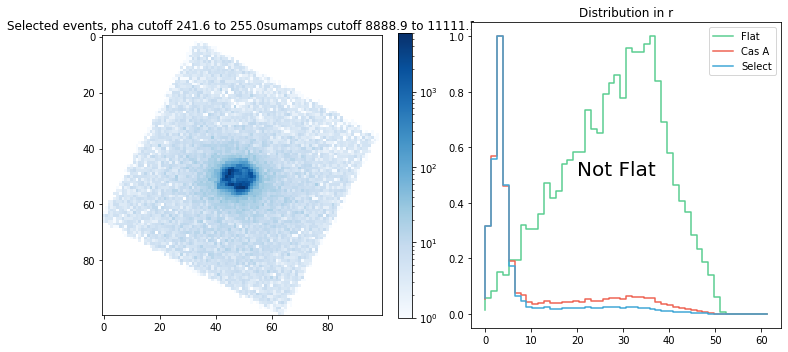

length of selection 142


<Figure size 432x288 with 0 Axes>

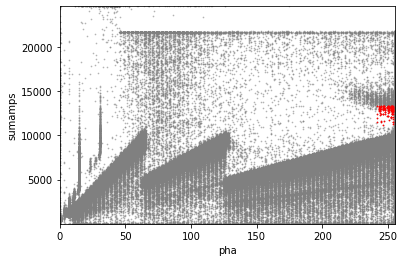

p-value comparing radial distribution to flat 3.4917876383331924e-07
p-value comparing radial distribution to all events 2.9965727393247677e-05


<Figure size 432x288 with 0 Axes>

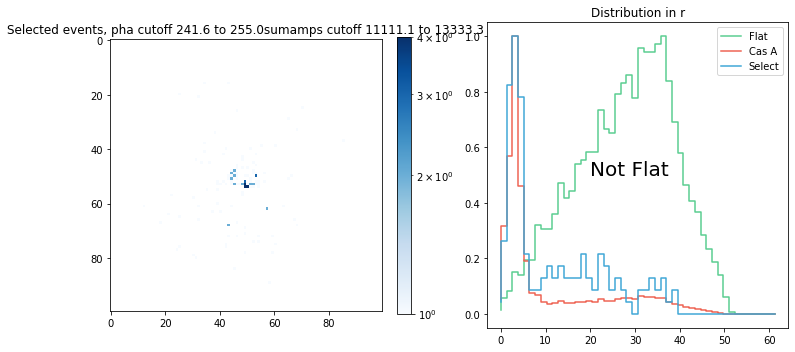

length of selection 616


<Figure size 432x288 with 0 Axes>

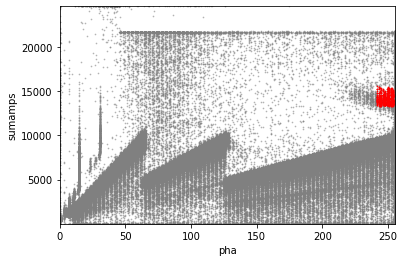

p-value comparing radial distribution to flat 2.6859904910255327e-08
p-value comparing radial distribution to all events 0.005166468598651642


<Figure size 432x288 with 0 Axes>

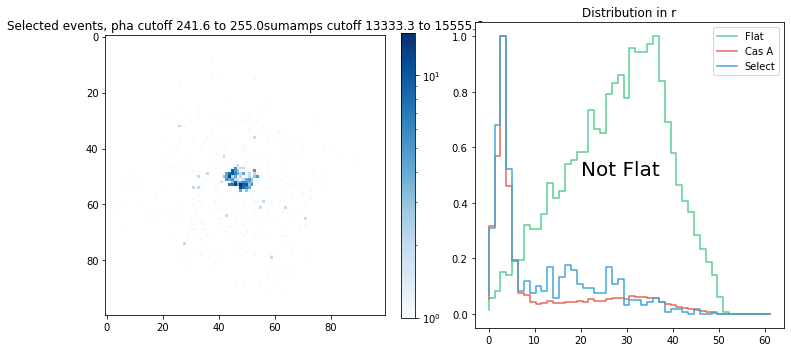

length of selection 68
length of selection 86
ks value for r flat [0.997345059724473, 0.3833868439543752, 0.5355200665725597, 0.9636034058516135, 1.4342849278786397e-11, 1.4342849278786397e-11, 7.440353063370443e-11, 0.2611068851719254, 0.03612176482297013, 0.005166468598651642, 3.5888761835080957e-10, 7.440353063370443e-11, 1.1538080891883593e-06, 0.5355200665725597, 0.2611068851719254, 0.00020262539475434033, 2.9965727393247677e-05, 0.2611068851719254, 0.06321210922149156, 1.1538080891883593e-06, 1.1538080891883593e-06, 2.9965727393247677e-05, 0.001124920295006686, 0.03612176482297013, 0.9636034058516135, 0.5355200665725597, 3.4917876383331924e-07, 2.9965727393247677e-05, 0.03612176482297013, 0.005166468598651642, 0.001124920295006686, 0.010332936867101364, 0.03612176482297013, 0.10591425451435192, 0.9636034058516135, 6.799975926646917e-09, 2.6859904910255327e-08, 0.005166468598651642, 0.010332936867101364, 0.019754137896767714, 0.03612176482297013, 0.10591425451435192, 0.86127655972

ValueError: x and y must be the same size

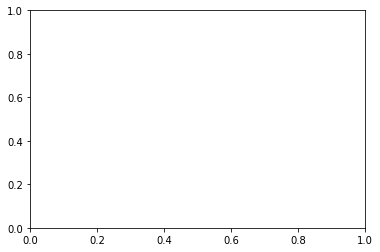

In [37]:
# Okay what about putting this together to run iteratively?
# Try this in just pha first
x_select = 'fp_u'
y_select = 'fb_u'

x_select = 'pha'
y_select = 'sumamps'

x_select_2 = 'fp_v'
y_select_2 = 'fb_v'
'''
B > (1-f_p)/3
B = B/(A+B+C) where these are au1, au2, au3
'''

steps_x = np.linspace(0,255,20) #for pha
steps_y = np.linspace(0,20000,10) # for sumamps

#steps = np.linspace(0, 1, 10) #for fp and fp
#steps = [0,1]

#steps = np.linspace(0,20000,10)

k_s_val_flat_x = []
k_s_val_all_x = []
k_s_val_flat_r = []
k_s_val_all_r = []


# Prep stuff for the 'all' and 'flat' cases outside of the loop:
extent_all = [[np.min(data_select['x'].values), np.max(data_select['x'].values)],
                  [np.min(data_select['y'].values), np.max(data_select['y'].values)]]

x_all = data_select['x'].values
y_all = data_select['y'].values


nbins=100#int(len(x)/10)

img_data_all, yedges, xedges = np.histogram2d(y_all, x_all, nbins, range=extent_all)

img_data_flat = np.minimum(img_data_all, 1)

hx_flat, hy_flat = margins(img_data_flat)
hx_all, hy_all = margins(img_data_all)


middle_pixel_x = np.shape(img_data_flat)[0]/2
middle_pixel_y = np.shape(img_data_flat)[1]/2


extent = np.shape(img_data_flat)[0]

radial_bins_pix = np.linspace(0,extent/2 + extent/8,50)

radial_bins_pix_flat = []
radial_bins_pix_full = []

for k in range(len(radial_bins_pix)-1):
    counter_flat = 0
    counter_full = 0
    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_flat+=img_data_flat[i,j] # only need to add 1 because its flat distribution
                counter_full+=img_data_all[i,j]
    radial_bins_pix_flat.append(counter_flat)
    radial_bins_pix_full.append(counter_full)

dist_flat = radial_bins_pix_flat/np.max(radial_bins_pix_flat)
dist_all = radial_bins_pix_full/np.max(radial_bins_pix_full)

u1 = data_select['au1']
u2 = data_select['au2']
u3 = data_select['au3']
v1 = data_select['av1']
v2 = data_select['av2']
v3 = data_select['av3']

for h in range(len(steps_x)-1):
    for l in range(len(steps_y)-1):
        val_x = steps_x[h]
        val_x_plus_one = steps_x[h+1]
        
        val_y = steps_y[l]
        val_y_plus_one = steps_y[l+1]



        selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) | ((u2/(u1+u2+u3) > val*(1+data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1+data_select[x_select])/3))
        selection = ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3)) | ((v2/(v1+v2+v3) > val*(1+data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1+data_select[x_select_2])/3))

        selection = ((data_select['sumamps'] < val_plus_one) & (data_select['sumamps'] > val))
        selection = ((data_select['pha'] < val_x_plus_one) & (data_select['pha'] > val_x) & (data_select['sumamps'] < val_y_plus_one) & (data_select['sumamps'] > val_y))

        #selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) & ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3))
        #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))



        selection_str = 'pha cutoff '+str(round(val_x,1))+' to '+str(round(val_x_plus_one,1))+'sumamps cutoff '+str(round(val_y,1))+' to '+str(round(val_y_plus_one,1))

        cut_area = data_select[selection]
        print('length of selection', len(cut_area))
        if len(cut_area) < 100: # too small of events to say much
            continue
        #cut_area = data_select[((data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1-data_select[x_select])/3) | (data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1+data_select[x_select])/3))]# & 
                              #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))]
        #cut_area = data_select[(data_select[y_select] < -0.5*data_select[x_select] + 0.5) | (data_select[y_select] < 0.5*data_select[x_select] + 0.5)]

        plt.clf()
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.scatter(data_select[x_select].values, data_select[y_select].values, 
                   color='grey', s=0.5, alpha=0.5)
        ax.scatter(cut_area[x_select].values, cut_area[y_select].values, 
                   color='red', s=0.5)
        #sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
        ax.set_xlabel(x_select)
        ax.set_ylabel(y_select)

        ax.set_xlim([np.min(data_select[x_select].values),np.max(data_select[x_select].values)])
        ax.set_ylim([np.min(data_select[y_select].values),np.max(data_select[y_select].values)])
        plt.show()

        if x_select=='fp_u':

            plt.clf()
            fig = plt.figure()
            ax = fig.add_subplot(111)
            ax.scatter(data_select[x_select_2].values, data_select[y_select_2].values, 
                       color='grey', s=0.5, alpha=0.5)
            ax.scatter(cut_area[x_select_2].values, cut_area[y_select_2].values, 
                       color='red', s=0.5)


            ax.set_xlim([np.min(data_select[x_select_2].values),np.max(data_select[x_select_2].values)])
            ax.set_ylim([np.min(data_select[y_select_2].values),np.max(data_select[y_select_2].values)])
            ax.set_xlabel(x_select_2)
            ax.set_ylabel(y_select_2)

            plt.show()


        


        # Plot up the properties of the selection
        # First, an image


        x = cut_area['x'].values
        y = cut_area['y'].values



        img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)



        plt.clf()
        fig = plt.figure(figsize=(10,5))
      

        ax = fig.add_subplot(121)
        im = ax.imshow(img_data, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
        try:
            plt.colorbar(im, fraction = 0.046)
        except:
            
            k_s_val_flat_r.append(0)
            k_s_val_all_r.append(0)
            continue
        ax.set_title('Selected events, '+str(selection_str))
        


        # What about projecting radially?
        # This could be cool for breaking down what is happening on the very edge of the chip
        # Ugh, but you actually have to do this for the img_datas, which are 2D

        radial_bins_pix_sample = []

        for k in range(len(radial_bins_pix)-1):

            counter_sample = 0

            for i in range(np.shape(img_data_flat)[0]):
                for j in range(np.shape(img_data_flat)[1]):
                    # so for each pixel see how far it is in pixel bins from the center
                    if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                        counter_sample+=img_data[i,j]

            radial_bins_pix_sample.append(counter_sample)

        dist_sample = radial_bins_pix_sample/np.max(radial_bins_pix_sample)


        ax2 = fig.add_subplot(122)
        ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
        ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
        ax2.step(radial_bins_pix[:-1], dist_sample, label='Select', color='#3FA7D6')
        plt.legend()
        ax2.set_title('Distribution in r')
        


        #Conduct k-s test to see how similar this is to the flat distribution
        stat_flat_r = scipy.stats.ks_2samp(dist_flat, dist_sample)
        stat_all_r = scipy.stats.ks_2samp(dist_sample, dist_all)
        #print(stat.pvalue)
        k_s_val_flat_r.append(stat_flat_r.pvalue)
        k_s_val_all_r.append(stat_all_r.pvalue)

        print('p-value comparing radial distribution to flat', stat_flat_r.pvalue)
        print('p-value comparing radial distribution to all events', stat_all_r.pvalue)
        
        if stat_flat_r.pvalue < 0.05:
            ax2.annotate('Not Flat', xy=(20,0.5),xycoords='data',size=20)
        else:
            ax2.annotate('Flat', xy=(20,0.5),xycoords='data',size=20)
        plt.tight_layout()
        plt.show()
   


#print('pha cuts', pha_cuts)
print('ks value for r flat', k_s_val_flat_r)
print('ks value for r all', k_s_val_all_r)

import math
plt.clf()

log_ks_flat = [math.log10(x) for x in k_s_val_flat_r]
log_ks_all = [math.log10(x) for x in k_s_val_all_r]
plt.scatter(steps[:-1], log_ks_flat, label='Flat versus select, r')
plt.scatter(steps[:-1], log_ks_all, label='All versus select, r')

#plt.scatter(pha_cuts[:-1], k_s_val_flat_x, label='Flat versus select, x')
#plt.scatter(pha_cuts[:-1], k_s_val_all_x, label='All versus select, x')
plt.legend()
plt.ylabel('Log p-value')
plt.show()


length of selection 225


<Figure size 432x288 with 0 Axes>

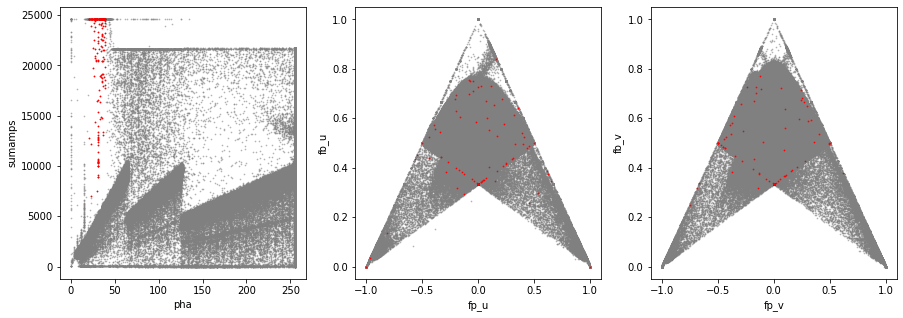

p-value comparing radial distribution to flat 0.005166468598651642
p-value comparing radial distribution to all events 0.010332936867101364


<Figure size 432x288 with 0 Axes>

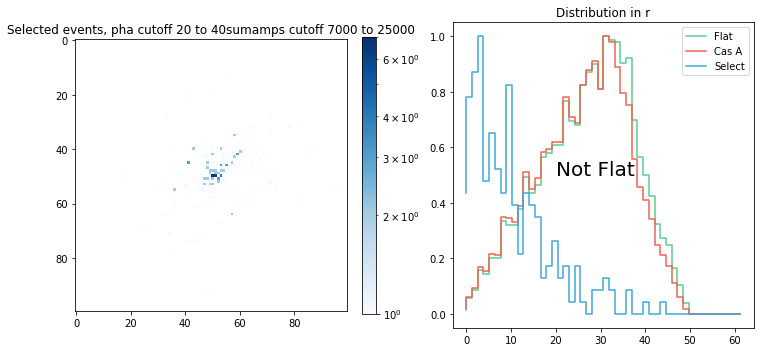

In [103]:
x_select = 'pha'
y_select = 'sumamps'

val_x = 20
val_x_plus_one = 40

val_y = 7000
val_y_plus_one =25000

selection = ((data_select['sumamps'] < val_plus_one) & (data_select['sumamps'] > val))
selection = ((data_select['pha'] < val_x_plus_one) & (data_select['pha'] > val_x) & (data_select['sumamps'] < val_y_plus_one) & (data_select['sumamps'] > val_y))

#selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) & ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3))
#((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))



selection_str = 'pha cutoff '+str(round(val_x,1))+' to '+str(round(val_x_plus_one,1))+'sumamps cutoff '+str(round(val_y,1))+' to '+str(round(val_y_plus_one,1))

cut_area = data_select[selection]
print('length of selection', len(cut_area))
if len(cut_area) < 100: # too small of events to say much
    STOP
#cut_area = data_select[((data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1-data_select[x_select])/3) | (data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1+data_select[x_select])/3))]# & 
                      #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))]
#cut_area = data_select[(data_select[y_select] < -0.5*data_select[x_select] + 0.5) | (data_select[y_select] < 0.5*data_select[x_select] + 0.5)]

plt.clf()
fig = plt.figure(figsize = (15,5))
ax = fig.add_subplot(131)
ax.scatter(data_select[x_select].values, data_select[y_select].values, 
           color='grey', s=0.5, alpha=0.5)
ax.scatter(cut_area[x_select].values, cut_area[y_select].values, 
           color='red', s=0.5)
#sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
ax.set_xlabel(x_select)
ax.set_ylabel(y_select)

#ax.set_xlim([np.min(data_select[x_select].values),np.max(data_select[x_select].values)])
#ax.set_ylim([np.min(data_select[y_select].values),np.max(data_select[y_select].values)])



# also show where these fall in fp_fb plane

ax1 = fig.add_subplot(132)
ax1.scatter(data_select['fp_u'].values, data_select['fb_u'].values, 
           color='grey', s=0.5, alpha=0.5)
ax1.scatter(cut_area['fp_u'].values, cut_area['fb_u'].values, 
           color='red', s=0.5)
#sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
ax1.set_xlabel('fp_u')
ax1.set_ylabel('fb_u')

#ax1.set_xlim([np.min(data_select['fp_u'].values),np.max(data_select['fp_u'].values)])
#ax1.set_ylim([np.min(data_select['fb_u'].values),np.max(data_select['fb_u'].values)])

ax2 = fig.add_subplot(133)
ax2.scatter(data_select['fp_v'].values, data_select['fb_v'].values, 
           color='grey', s=0.5, alpha=0.5)
ax2.scatter(cut_area['fp_v'].values, cut_area['fb_v'].values, 
           color='red', s=0.5)
#sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
ax2.set_xlabel('fp_v')
ax2.set_ylabel('fb_v')

#ax2.set_xlim([np.min(data_select['fp_v'].values),np.max(data_select['fp_v'].values)])
#ax2.set_ylim([np.min(data_select['fb_v'].values),np.max(data_select['fb_v'].values)])


plt.show()






# Plot up the properties of the selection
# First, an image


x = cut_area['x'].values
y = cut_area['y'].values



img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)



plt.clf()
fig = plt.figure(figsize=(10,5))


ax = fig.add_subplot(121)
im = ax.imshow(img_data, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
plt.colorbar(im, fraction = 0.046)

ax.set_title('Selected events, '+str(selection_str))



# What about projecting radially?
# This could be cool for breaking down what is happening on the very edge of the chip
# Ugh, but you actually have to do this for the img_datas, which are 2D

radial_bins_pix_sample = []

for k in range(len(radial_bins_pix)-1):

    counter_sample = 0

    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_sample+=img_data[i,j]

    radial_bins_pix_sample.append(counter_sample)

dist_sample = radial_bins_pix_sample/np.max(radial_bins_pix_sample)


ax2 = fig.add_subplot(122)
ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
ax2.step(radial_bins_pix[:-1], dist_sample, label='Select', color='#3FA7D6')
plt.legend()
ax2.set_title('Distribution in r')



#Conduct k-s test to see how similar this is to the flat distribution
stat_flat_r = scipy.stats.ks_2samp(dist_flat, dist_sample)
stat_all_r = scipy.stats.ks_2samp(dist_sample, dist_all)
#print(stat.pvalue)
k_s_val_flat_r.append(stat_flat_r.pvalue)
k_s_val_all_r.append(stat_all_r.pvalue)

print('p-value comparing radial distribution to flat', stat_flat_r.pvalue)
print('p-value comparing radial distribution to all events', stat_all_r.pvalue)

if stat_flat_r.pvalue < 0.05:
    ax2.annotate('Not Flat', xy=(20,0.5),xycoords='data',size=20)
else:
    ax2.annotate('Flat', xy=(20,0.5),xycoords='data',size=20)
plt.tight_layout()
plt.show()


length of selection 26942 total length of event file 6900503


<Figure size 432x288 with 0 Axes>

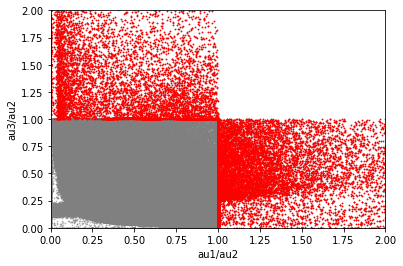

p-value comparing radial distribution to flat 0.16995747466707573
p-value comparing radial distribution to all events 1.614994282578643e-09


<Figure size 432x288 with 0 Axes>

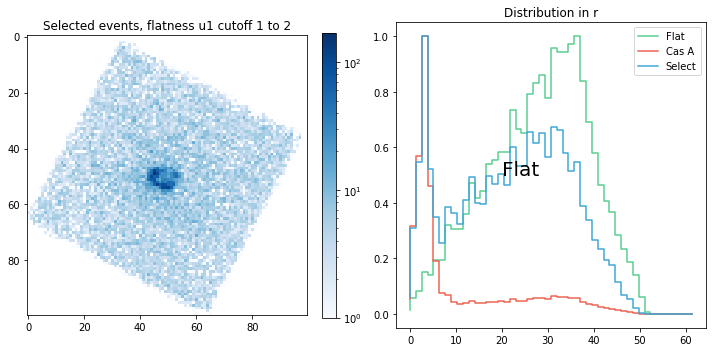

In [59]:
### This is for looking at flatness

x_select = 'flatness u1'
y_select = 'flatness u3'

'''u1 = data_select['au1']
u2 = data_select['au2']
u3 = data_select['au3']
v1 = data_select['av1']
v2 = data_select['av2']
v3 = data_select['av3']
'''



data_select['flatness u1'] = data_select['au1']/data_select['au2']
data_select['flatness u3'] = data_select['au3']/data_select['au2']

val_x = 1
val_x_plus_one = 2


val_y = 1
val_y_plus_one = 2

#val_y = 12000
#val_y_plus_one = 20000

selection = (((data_select['flatness u1'] < val_x_plus_one) & (data_select['flatness u1'] > val_x)) | ((data_select['flatness u3'] < val_y_plus_one) & (data_select['flatness u3'] > val_y)))

#selection = ((u2/(u1+u2+u3) > val*(1-data_select[x_select])/3) & (u2/(u1+u2+u3) < val_plus_one*(1-data_select[x_select])/3)) & ((v2/(v1+v2+v3) > val*(1-data_select[x_select_2])/3) & (v2/(v1+v2+v3) < val_plus_one*(1-data_select[x_select_2])/3))
#((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))



selection_str = 'flatness u1 cutoff '+str(round(val_x,1))+' to '+str(round(val_x_plus_one,1))#+'sumamps cutoff '+str(round(val_y,1))+' to '+str(round(val_y_plus_one,1))

cut_area = data_select[selection]
print('length of selection', len(cut_area), 'total length of event file', len(data_select))
if len(cut_area) < 100: # too small of events to say much
    STOP
#cut_area = data_select[((data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1-data_select[x_select])/3) | (data_select['au2']/(data_select['au1'] + data_select['au2'] + data_select['au3']) < (1+data_select[x_select])/3))]# & 
                      #((data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1-data_select[x_select_2])/3) | (data_select['av2']/(data_select['av1'] + data_select['av2'] + data_select['av3']) < (1+data_select[x_select_2])/3))]
#cut_area = data_select[(data_select[y_select] < -0.5*data_select[x_select] + 0.5) | (data_select[y_select] < 0.5*data_select[x_select] + 0.5)]

plt.clf()
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(data_select[x_select].values, data_select[y_select].values, 
           color='grey', s=0.5, alpha=0.5)
ax.scatter(cut_area[x_select].values, cut_area[y_select].values, 
           color='red', s=0.5)
#sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
ax.set_xlabel('au1/au2')
ax.set_ylabel('au3/au2')
ax.set_xlim([0,2])
ax.set_ylim([0,2])

#ax.set_xlim([np.min(data_select[x_select].values),np.max(data_select[x_select].values)])
#ax.set_ylim([np.min(data_select[y_select].values),np.max(data_select[y_select].values)])
plt.show()

if x_select=='fp_u':

    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(data_select[x_select_2].values, data_select[y_select_2].values, 
               color='grey', s=0.5, alpha=0.5)
    ax.scatter(cut_area[x_select_2].values, cut_area[y_select_2].values, 
               color='red', s=0.5)


    ax.set_xlim([np.min(data_select[x_select_2].values),np.max(data_select[x_select_2].values)])
    ax.set_ylim([np.min(data_select[y_select_2].values),np.max(data_select[y_select_2].values)])
    ax.set_xlabel(x_select_2)
    ax.set_ylabel(y_select_2)

    plt.show()





# Plot up the properties of the selection
# First, an image


x = cut_area['x'].values
y = cut_area['y'].values



img_data, yedges, xedges = np.histogram2d(y, x, nbins, range=extent_all)



plt.clf()
fig = plt.figure(figsize=(10,5))


ax = fig.add_subplot(121)
im = ax.imshow(img_data, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
plt.colorbar(im, fraction = 0.046)

ax.set_title('Selected events, '+str(selection_str))



# What about projecting radially?
# This could be cool for breaking down what is happening on the very edge of the chip
# Ugh, but you actually have to do this for the img_datas, which are 2D

radial_bins_pix_sample = []

for k in range(len(radial_bins_pix)-1):

    counter_sample = 0

    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_sample+=img_data[i,j]

    radial_bins_pix_sample.append(counter_sample)

dist_sample = radial_bins_pix_sample/np.max(radial_bins_pix_sample)


ax2 = fig.add_subplot(122)
ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
ax2.step(radial_bins_pix[:-1], dist_sample, label='Select', color='#3FA7D6')
plt.legend()
ax2.set_title('Distribution in r')



#Conduct k-s test to see how similar this is to the flat distribution
stat_flat_r = scipy.stats.ks_2samp(dist_flat, dist_sample)
stat_all_r = scipy.stats.ks_2samp(dist_sample, dist_all)
#print(stat.pvalue)
k_s_val_flat_r.append(stat_flat_r.pvalue)
k_s_val_all_r.append(stat_all_r.pvalue)

print('p-value comparing radial distribution to flat', stat_flat_r.pvalue)
print('p-value comparing radial distribution to all events', stat_all_r.pvalue)

if stat_flat_r.pvalue < 0.05:
    ax2.annotate('Not Flat', xy=(20,0.5),xycoords='data',size=20)
else:
    ax2.annotate('Flat', xy=(20,0.5),xycoords='data',size=20)
plt.tight_layout()
plt.show()


### Below, code to create the franken dataframe
Do this by sampling from each spatial bin to create a random df made up of a random assortment of events from Cas A that are spaced equally in x and y

[ 6940.1465    7128.643825  7317.14115   7505.638475  7694.1358
  7882.633125  8071.13045   8259.627775  8448.1251    8636.622425
  8825.11975   9013.617075  9202.1144    9390.611725  9579.10905
  9767.606375  9956.1037   10144.601025 10333.09835  10521.595675
 10710.093    10898.590325 11087.08765  11275.584975 11464.0823
 11652.579625 11841.07695  12029.574275 12218.0716   12406.568925
 12595.06625  12783.563575 12972.0609   13160.558225 13349.05555
 13537.552875 13726.0502   13914.547525 14103.04485  14291.542175
 14480.0395   14668.536825 14857.03415  15045.531475 15234.0288
 15422.526125 15611.02345  15799.520775 15988.0181   16176.515425
 16365.01275  16553.510075 16742.0074   16930.504725 17119.00205
 17307.499375 17495.9967   17684.494025 17872.99135  18061.488675
 18249.986    18438.483325 18626.98065  18815.477975 19003.9753
 19192.472625 19380.96995  19569.467275 19757.9646   19946.461925
 20134.95925  20323.456575 20511.9539   20700.451225 20888.94855
 21077.445875 21265.94

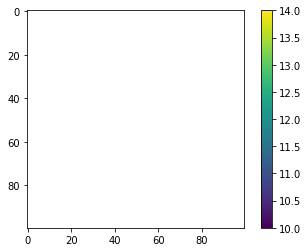

NameError: name 'STOP' is not defined

In [23]:
# New idea: bin everything up in x and y
# scipy.binned_statistic_2d
count, xbins, ybins, something = scipy.stats.binned_statistic_2d(x, y, None, 'count', bins=100)
print(xbins, ybins, count)

count_ma = np.ma.masked_where(count<10, count)

plt.imshow(count_ma)
plt.colorbar()
plt.show()
STOP

print(100*100*10, 'total events you will have')

print('starting len', len(data_select))

#data_select = data_select.reset_index()

# Now go through in x and y and ask if events are within each bin; build a new dataframe that you sample
# 10 events from at each x and y
index_list = []
break_now = False

dataframe_flat = pd.DataFrame(columns = data_select.columns)


for i in range(len(xbins)-1):
    #if break_now==True:
    #    break
    for j in range(len(ybins)-1):
        
        print(i, j)
        
        # ACTUALLY NO do this better
        data_subset = data_select[data_select['x'] > xbins[i]]
        data_subset = data_subset[data_subset['x'] < xbins[i+1]]
        data_subset = data_subset[data_subset['y'] > ybins[j]]
        data_subset = data_subset[data_subset['y'] < ybins[j+1]]
        #[(data_select['x'] > xbins[i]) and (data_select['x'] < xbins[i+1]) and (data_select['y'] > ybins[j]) and (data_select['y'] < ybins[j+1])]
        if len(data_subset)<10:
            continue
        else:
            # randomly sample 10 of these 
            data_random_subset = data_subset.sample(n=10)
            #print(i, j, len(data_random_subset))
            #print(data_random_subset)
            try:
                index_list.append(data_random_subset['index'].values)
            except:
                print(data_random_subset)
            dataframe_flat = dataframe_flat.append(data_random_subset)
            #STOP
            #break_now = True
            #break
            
print(dataframe_flat)


                 x          y  pha sumamps  fp_u_abs      fp_u      fb_u  \
4137636  7123.8450  18205.620   14    2300  0.014530 -0.014530  0.730769   
161670   7063.5590  18266.078   21    3063  0.447165  0.447165  0.503866   
1982006  7097.6310  18176.988   43    6315  0.045641  0.045641  0.727731   
1996370  7118.8755  18204.560   52    7722  0.130558  0.130558  0.708635   
2413152  7097.7217  18322.268   10    1642  0.261025  0.261025  0.617402   
...            ...        ...  ...     ...       ...       ...       ...   
618594   7273.8623  18713.186   12    1890  0.186047  0.186047  0.690597   
6288498  7253.1950  18867.129   53    8650  0.175237  0.175237  0.695309   
5162933  7149.6665  18792.576  185    6487  0.243259 -0.243259  0.563970   
6071838  7248.5474  18723.504   93    7144  0.414553  0.414553  0.536935   
1194646  7271.0250  18701.220  125    9529  0.075878 -0.075878  0.735995   

         fp_v_abs      fp_v      fb_v   au1   au2   au3   av1   av2   av3  \
4137636  0

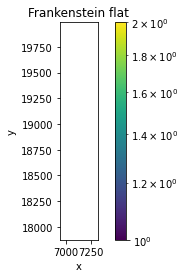

In [24]:
print(dataframe_flat)
plot_from_df(dataframe_flat, 'Frankenstein flat', 'x','y')

<Figure size 432x288 with 0 Axes>

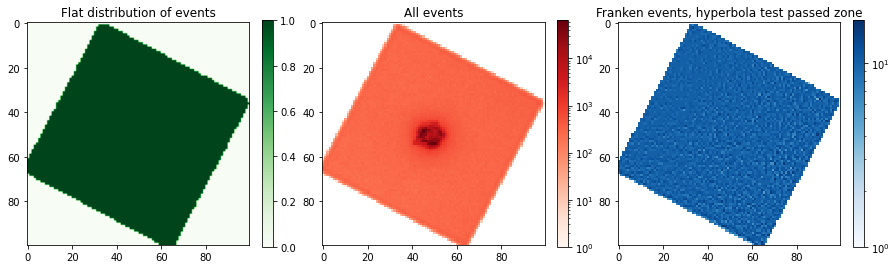

<Figure size 432x288 with 0 Axes>

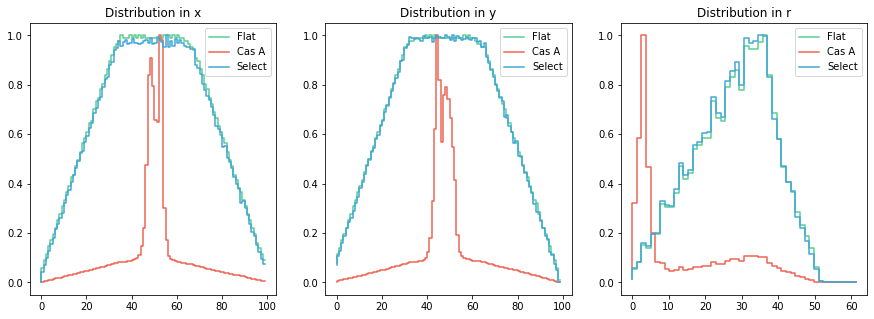

y comparing flat to flat Ks_2sampResult(statistic=0.0, pvalue=1.0)
y comparing flat to select Ks_2sampResult(statistic=0.13, pvalue=0.36818778606286096)
y comparing flat to all Ks_2sampResult(statistic=0.81, pvalue=3.93815390175582e-33)
y comparing select to all Ks_2sampResult(statistic=0.81, pvalue=3.93815390175582e-33)
Same thing but now radially
y comparing flat to flat Ks_2sampResult(statistic=0.0, pvalue=1.0)
y comparing flat to select Ks_2sampResult(statistic=0.061224489795918366, pvalue=0.9999937383109323)
y comparing flat to all Ks_2sampResult(statistic=0.6530612244897959, pvalue=3.5888761835080957e-10)
y comparing select to all Ks_2sampResult(statistic=0.6530612244897959, pvalue=3.5888761835080957e-10)


In [270]:
# Plot the radial distribution of the dataframe_flat


img_data_flat = np.minimum(img_data_all, 1)

x_franken = dataframe_flat['x'].values
y_franken = dataframe_flat['y'].values


img_data_franken, yedges, xedges = np.histogram2d(y_franken, x_franken, nbins, range=extent_all)



plt.clf()
fig = plt.figure(figsize=(15,5))
ax0 = fig.add_subplot(131)
im0 = ax0.imshow(img_data_flat, cmap='Greens')
plt.colorbar(im0, fraction = 0.046)
ax0.set_title('Flat distribution of events')

ax1 = fig.add_subplot(132)
im1 = ax1.imshow(img_data_all, norm=matplotlib.colors.LogNorm(), cmap='Reds', interpolation='None')
plt.colorbar(im1, fraction = 0.046)
ax1.set_title('All events')

ax2 = fig.add_subplot(133)
im2 = ax2.imshow(img_data_franken, norm=matplotlib.colors.LogNorm(), cmap='Blues', interpolation='None')
plt.colorbar(im2, fraction = 0.046)
ax2.set_title('Franken events, '+str(selection_str))
plt.show()



# Ugh, but you actually have to do this for the img_datas, which are 2D
middle_pixel_x = np.shape(img_data_flat)[0]/2
middle_pixel_y = np.shape(img_data_flat)[1]/2


extent = np.shape(img_data_flat)[0]

radial_bins_pix = np.linspace(0,extent/2 + extent/8,50)

radial_bins_pix_franken = []

for k in range(len(radial_bins_pix)-1):
   
    counter_sample = 0
   
    for i in range(np.shape(img_data_flat)[0]):
        for j in range(np.shape(img_data_flat)[1]):
            # so for each pixel see how far it is in pixel bins from the center
            if ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 > radial_bins_pix[k]**2) & ((i - middle_pixel_x)**2 + (j - middle_pixel_y)**2 < radial_bins_pix[k+1]**2):
                counter_sample+=img_data_franken[i,j]
                
    radial_bins_pix_franken.append(counter_sample)
    
dist_franken = radial_bins_pix_franken/np.max(radial_bins_pix_franken)








# Projected histograms in x and y

hx_franken, hy_franken = margins(img_data_franken)


xs = np.linspace(0, len(hx_flat.T[0])-1, len(hx_flat.T[0]))
ys = np.linspace(0, len(hy_flat[0])-1, len(hy_flat[0]))


plt.clf()
fig = plt.figure(figsize=(15,5))
ax0 = fig.add_subplot(131)
ax0.step(xs, hx_flat.T[0]/np.max(hx_flat.T[0]), label='Flat', color='#59CD90')
ax0.step(xs, hx_all.T[0]/np.max(hx_all.T[0]),  label='Cas A', color='#EE6352')#, density=True)
ax0.step(xs, hx_franken.T[0]/np.max(hx_franken.T[0]), label='Select', color='#3FA7D6')
plt.legend()
ax0.set_title('Distribution in x')

ax1 = fig.add_subplot(132)
ax1.step(ys, hy_flat[0]/np.max(hy_flat[0]), label='Flat', color='#59CD90')
ax1.step(ys, hy_all[0]/np.max(hy_all[0]),  label='Cas A', color='#EE6352')#, density=True)
ax1.step(ys, hy_franken[0]/np.max(hy_franken[0]), label='Select', color='#3FA7D6')
plt.legend()
ax1.set_title('Distribution in y')

ax2 = fig.add_subplot(133)
ax2.step(radial_bins_pix[:-1], dist_flat, label='Flat', color='#59CD90')
ax2.step(radial_bins_pix[:-1], dist_all,  label='Cas A', color='#EE6352')#, density=True)
ax2.step(radial_bins_pix[:-1], dist_franken, label='Select', color='#3FA7D6')
plt.legend()
ax2.set_title('Distribution in r')

plt.show()


#Conduct k-s test to see how similar this is to the flat distribution
print('y comparing flat to flat', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_flat[0]/np.max(hy_flat[0])) )
print('y comparing flat to select', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_franken[0]/np.max(hy_franken[0])) )
print('y comparing flat to all', scipy.stats.ks_2samp(hy_flat[0]/np.max(hy_flat[0]),hy_all[0]/np.max(hy_all[0])) )

print('y comparing select to all', scipy.stats.ks_2samp(hy_all[0]/np.max(hy_all[0]),hy_franken[0]/np.max(hy_franken[0])) )

# Doing the same radially
print('Same thing but now radially')
print('y comparing flat to flat', scipy.stats.ks_2samp(dist_flat,dist_flat) )
print('y comparing flat to select', scipy.stats.ks_2samp(dist_flat, dist_franken) )
print('y comparing flat to all', scipy.stats.ks_2samp(dist_flat, dist_all) )

print('y comparing select to all', scipy.stats.ks_2samp(dist_franken, dist_all) )


# The null hypothesis is that the two distributions are identical. 
# We can reject them because the p-val is so small

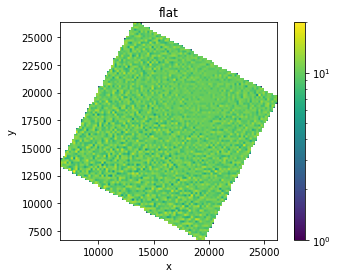

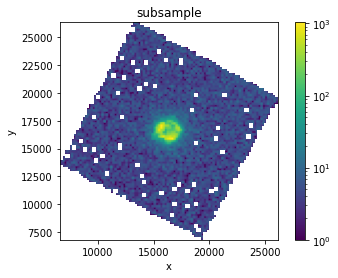

/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



finding test and train indices...
training fold 0


/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


predicting...
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken
['franken'] franken


<Figure size 432x288 with 0 Axes>

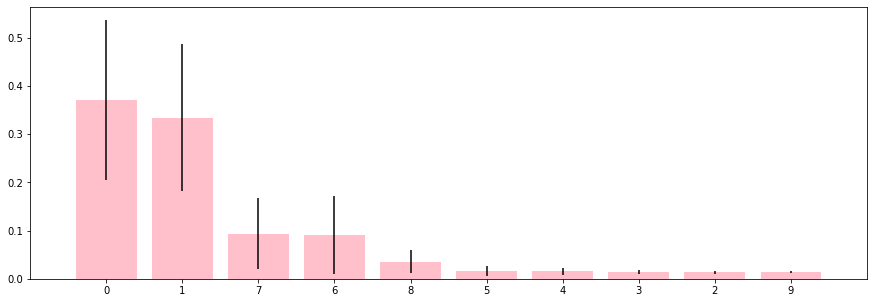

Importance in Order ~~~~
random idx 9
random_value 0.013777725409257908
0 crsu
1 crsv
7 pi
6 pha
8 sumamps
5 fp_v
4 fp_u
3 fb_v
2 fb_u
9 random


In [338]:
# Train a random forest to distinguish between the franken events and the events
#print(dataframe_flat)
# Compare this to 
#print(data_select)

# subsample from data_select
data_select_chopped = data_select.sample(n=len(dataframe_flat))
#print(data_select_chopped)

plot_from_df(dataframe_flat, 'flat','x', 'y')
plot_from_df(data_select_chopped, 'subsample', 'x', 'y')

# Now train a RF to distinguish between the two
dataframe_flat['class'] = 'franken'
data_select_chopped['class'] = 'real'

dataframe_flat['random'] = np.random.random(len(dataframe_flat))
data_select_chopped['random'] = np.random.random(len(data_select_chopped))

concat = pd.concat([dataframe_flat, data_select_chopped])

feature_list_RF = ['crsu','crsv','fb_u', 'fb_v', 'fp_u', 'fp_v',
        'pha', 'pi', 'sumamps', 'random']

feature_list = ['x', 'y','fb_u', 'fb_v', 'fp_u', 'fp_v',
        'pha', 'pi', 'sumamps', 'random']



#print(df_0)
most_imp, unimportant, model  = run_RFC(concat, 
                          feature_list_RF, verbose=True)

['real' 'franken' 'franken' ... 'real' 'franken' 'franken']
[[0.19421814 0.80578186]
 [0.52258568 0.47741432]
 [0.71038728 0.28961272]
 ...
 [0.11719996 0.88280004]
 [0.73742664 0.26257336]
 [0.64539018 0.35460982]]
real 1907286
not real 1512671


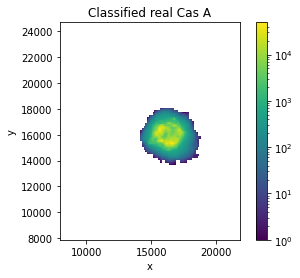

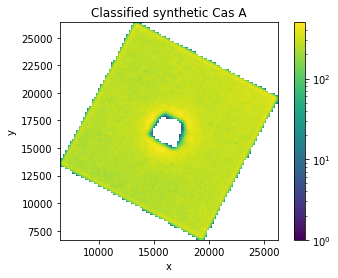

In [339]:
# Now classify everything as weird or normal

# Add a new column onto data_select with random
data_select['random'] = np.random.random(len(data_select))

predicted = model.predict(data_select[feature_list_RF].values)
predict_prob = model.predict_proba(data_select[feature_list_RF].values)

#print(np.bincount(predicted))
print(predicted)
print(predict_prob)
real_i = np.where(predicted=='real')[0]
not_real_i = np.where(predicted=='franken')[0]

print('real', len(real_i))
print('not real', len(not_real_i))

real = data_select[feature_list].values[real_i]# was [feature_list]
synthetic = data_select[feature_list].values[not_real_i]

real_df = pd.DataFrame(real, columns = feature_list)
real_df['class'] = 1

synthetic_df = pd.DataFrame(synthetic, columns = feature_list)
synthetic_df['class'] = 0


real_synthetic_df = pd.concat([real_df, 
                              synthetic_df])

# Now make plots out of these two 
plot_from_df(real_df, 'Classified real Cas A', 'x', 'y')
plot_from_df(synthetic_df, 'Classified synthetic Cas A', 'x','y')



NameError: name 'synthetic' is not defined

<Figure size 432x288 with 0 Axes>

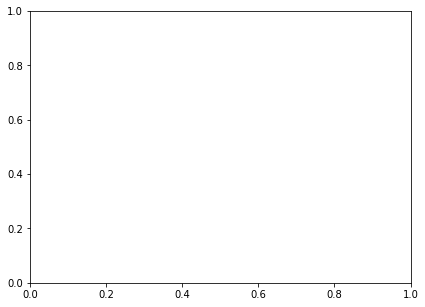

In [25]:
# How are these events distributed in parameter space?
feature_list_plot = ['x','y','fp_u','fb_u','fp_v','fb_v','pha','sumamps']


for i in range(int(len(feature_list_plot)/2)):
    # Make the shape of this divided by two of plots
    
    # Get the x and y features:
    plot_x = feature_list_plot[2*i]
    plot_y = feature_list_plot[2*i+1]
    
    index_x = feature_list.index(plot_x)
    index_y = feature_list.index(plot_y)
    
    
    
    
    # Also define where the centers fall: 
    
    plt.clf()
    fig = plt.figure(figsize = (15,5))
    ax = fig.add_subplot(121)
    ax.scatter(synthetic[:,index_x], synthetic[:,index_y], 
               color='grey', s=0.5, label='Not real')
    plt.legend()
    
    ax1 = fig.add_subplot(122)
    ax1.scatter(real[:,index_x], real[:,index_y], 
               color='red', s=0.5, alpha=0.5, label='Real')
    plt.legend()
    
    #sns.kdeplot(data_select_samp[plot_x], data_select_samp[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
    ax.set_xlabel(str(plot_x))
    ax.set_ylabel(str(plot_y))
    
    #ax.set_xlim([np.min(data_select[plot_x].values),np.max(data_select[plot_x].values)])
    #ax.set_ylim([np.min(data_select[plot_y].values),np.max(data_select[plot_y].values)])
    plt.show()
    
    continue
    
    # Try to also get the scipy.stats_binned_2d
    stat_x = real_synthetic_df[plot_y].values
    stat_y = real_synthetic_df[plot_y].values
    
    stat_c = real_synthetic_df['class'].values
    print(stat_x, stat_y, stat_c)
    stat, xbins, ybins, something = scipy.stats.binned_statistic_2d(stat_x, stat_y, stat_c, 'mean', bins=100)
    
    print(np.ma.masked_where(np.isnan(stat), stat))
    print(np.shape(stat))
    
    plt.clf()
    plt.imshow(np.ma.masked_where(np.isnan(stat), stat))
    plt.colorbar()
    plt.show()
    
    STOP
    
    plt.clf()
    plt.scatter(stat_x, stat_y, c = stat_c)
    plt.show()
    



In [26]:
# Let's try to use plotly to make this more beautiful

df = px.data.iris()
fig = px.scatter_matrix(df, dimensions=["sepal_width", "sepal_length", "petal_width", "petal_length"], color="species")
fig.show()

In [59]:
import plotly.express as px

plt.clf()
fig = px.scatter_matrix(data_select[0:1000], 
                        dimensions=["x","y","fp_u_abs", "fb_u","sumamps","pha"])
fig.update_traces(diagonal_visible=False)
fig.show()

<Figure size 432x288 with 0 Axes>

2.4.1
1.14.6


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
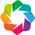

4734960


TypeError: cannot perform reduce with flexible type

In [20]:
# Try to do this with holoviews
import bokeh
print(bokeh.__version__)

import holoviews.plotting.bokeh

#STOP

import holoviews as hv
print(hv.__version__)
hv.extension('bokeh')
#import hvplot.pandas  # noqa

from bokeh.io import output_file, show
from bokeh.layouts import gridplot
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure


mag_hist = data_select.hvplot(
    y='x', kind='hist', responsive=True, min_height=150)

depth_hist = data_select.hvplot(
        y='y', kind='hist', responsive=True, min_height=150)

ls = hv.link_selections.instance()

ls(depth_hist + mag_hist)


print(len(data_select))
output_file("crossfilter.html")

length = 100000

data_select = data_clean

# create a column data source for the plots to share
source = ColumnDataSource(data=dict(x=data_select["x"][0:length], 
                                    y=data_select["y"][0:length], 
                                    crsu=data_select["crsu"][0:length], 
                                    crsv=data_select["crsv"][0:length], 
                                    fp_u_abs=data_select["fp_u_abs"][0:length],
                                    fp_u=data_select["fp_u"][0:length],
                                   fb_u=data_select["fb_u"][0:length],
                                   fp_v_abs=data_select["fp_v_abs"][0:length],
                                    fp_v=data_select["fp_v"][0:length],
                                    fb_v=data_select["fb_v"][0:length],
                                   sumamps = data_select["sumamps"][0:length],
                                   pha=data_select["pha"][0:length],
                                  pi=data_select["pi"][0:length]))

TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left_top = figure(tools=TOOLS, width=300, height=300, title=None)
left_top.circle('x', 'y', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

middle_top = figure(tools=TOOLS, width=300, height=300, title=None)
middle_top.circle('crsu', 'crsv', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

# create another new plot and add a renderer
right_top = figure(tools=TOOLS, width=300, height=300, title=None)
right_top.circle('pha', 'sumamps', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)


#H, xe, ye = np.histogram2d(data_select["x"][0:length], data_select["y"][0:length], bins=100)
H, xe, ye = np.histogram2d('x', 'y', bins=100)
left_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
left_bottom.image(image=[H], x=xe[0], y=ye[0], dw=xe[-1] - xe[0], dh=ye[-1] - ye[0], 
                  palette="Spectral11", source=source)

#http://tphinkle.github.io/bokeh_intro/
#Apparently brush linking might not be possible with the histogram in the static case
#Is there another casE?

'''
H, xe, ye = np.histogram2d(x, y, bins=100)

# produce an image of the 2d histogram
p = figure(x_range=(min(xe), max(xe)), y_range=(min(ye), max(ye)), title='Image')

p.image(image=[H], x=xe[0], y=ye[0], dw=xe[-1] - xe[0], dh=ye[-1] - ye[0], palette="Spectral11")

'''

'''
left_bottom.circle('pi', 'sumamps', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)
'''
middle_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
middle_bottom.circle('fp_u', 'fb_u', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

# create another new plot and add a renderer
right_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
right_bottom.circle('fp_v', 'fb_v', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

p = gridplot([[left_top, middle_top, right_top],[left_bottom, middle_bottom, right_bottom]])

show(p)

In [23]:


from bokeh.io import output_file, show
from bokeh.layouts import gridplot
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure


print(len(data_select))
output_file("crossfilter.html")

length = 100000

data_select = data_clean

# create a column data source for the plots to share
source = ColumnDataSource(data=dict(x=data_select["x"][0:length], 
                                    y=data_select["y"][0:length], 
                                    crsu=data_select["crsu"][0:length], 
                                    crsv=data_select["crsv"][0:length], 
                                    fp_u_abs=data_select["fp_u_abs"][0:length],
                                    fp_u=data_select["fp_u"][0:length],
                                   fb_u=data_select["fb_u"][0:length],
                                   fp_v_abs=data_select["fp_v_abs"][0:length],
                                    fp_v=data_select["fp_v"][0:length],
                                    fb_v=data_select["fb_v"][0:length],
                                   sumamps = data_select["sumamps"][0:length],
                                   pha=data_select["pha"][0:length],
                                  pi=data_select["pi"][0:length]))

TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left_top = figure(tools=TOOLS, width=300, height=300, title=None)
left_top.circle('x', 'y', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

middle_top = figure(tools=TOOLS, width=300, height=300, title=None)
middle_top.circle('crsu', 'crsv', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

# create another new plot and add a renderer
right_top = figure(tools=TOOLS, width=300, height=300, title=None)
right_top.circle('pha', 'sumamps', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)


H, xe, ye = np.histogram2d(data_select["x"][0:length], data_select["y"][0:length], bins=100)
#H, xe, ye = np.histogram2d('x', 'y', bins=100)
left_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
left_bottom.image(image=[H], x=xe[0], y=ye[0], dw=xe[-1] - xe[0], dh=ye[-1] - ye[0], 
                  palette="Spectral11")#, source=source)

#http://tphinkle.github.io/bokeh_intro/
#Apparently brush linking might not be possible with the histogram in the static case
#Is there another casE?

'''
H, xe, ye = np.histogram2d(x, y, bins=100)

# produce an image of the 2d histogram
p = figure(x_range=(min(xe), max(xe)), y_range=(min(ye), max(ye)), title='Image')

p.image(image=[H], x=xe[0], y=ye[0], dw=xe[-1] - xe[0], dh=ye[-1] - ye[0], palette="Spectral11")

'''

'''
left_bottom.circle('pi', 'sumamps', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)
'''
middle_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
middle_bottom.circle('fp_u', 'fb_u', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

# create another new plot and add a renderer
right_bottom = figure(tools=TOOLS, width=300, height=300, title=None)
right_bottom.circle('fp_v', 'fb_v', source=source,# set visual properties for selected glyphs
                       selection_color="mediumvioletred",

                       # set visual properties for non-selected glyphs
                       nonselection_fill_alpha=0.2,
                       nonselection_fill_color="pink", size=0.1)

p = gridplot([[left_top, middle_top, right_top],[left_bottom, middle_bottom, right_bottom]])

show(p)

4834181


In [45]:
# Try to set your own scatter plots
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots
fig = make_subplots(
    rows=2, cols=2,
    column_widths=[0.6, 0.6],
    row_heights=[1.0, 1.0],
    specs=[[{"type": "scatter"}, {"type": "scatter"}], [{"type": "scatter"}, {"type": "scatter"}]])

fig.add_trace(
    go.Scatter(x=data_select["x"][0:1000],y=data_select["y"][0:1000], mode='markers'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=data_select["pha"][0:1000],y=data_select["sumamps"][0:1000], mode='markers'),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(x=data_select["fp_u_abs"][0:1000],y=data_select["fb_u"][0:1000], mode='markers'),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=data_select["fp_v_abs"][0:1000],y=data_select["fb_v"][0:1000], mode='markers'),
    row=2, col=2
)


fig.show()

In [123]:
# Standardize the data prior to k-means:

standardized_data = preprocessing.scale(data_select)
standardized_data_df = pd.DataFrame(standardized_data, columns = feature_list)
x_and_y = data[['x','y']].values#)#, columns=['x','y'])
print(standardized_data)

[[ 0.34900499  0.13309845 -2.37982452 ...  0.78357093 -1.08196152
   1.05323334]
 [-0.28732523 -0.81387873 -2.36406448 ... -0.12141821 -1.30002589
   1.01233354]
 [-1.77209573  1.81661342 -2.26950424 ...  0.08094688 -0.51039268
   0.36686099]
 ...
 [ 0.03083988 -0.18256061 -2.09614379 ...  0.73561165 -1.30811017
   1.41079574]
 [ 2.78827081  2.86881028 -2.09614379 ... -1.80981535 -0.95198312
  -1.83720398]
 [-1.02971048  0.23831813 -2.31678436 ... -2.11871492  0.78953352
  -0.94000711]]


In [124]:

print(np.shape(standardized_data))
print(feature_list)

(6900503, 8)
['crsu', 'crsv', 'pi', 'sumamps', 'fp_u_abs', 'fb_u', 'fp_v_abs', 'fb_v']


In [ ]:
### Okay, why not run q quick clustering ?

nclusters=10
kmeans = KMeans(n_clusters=nclusters, random_state=42)
clusters = kmeans.fit_predict(standardized_data)
centers = kmeans.cluster_centers_#.reshape(nclusters, resampling_shape, resampling_shape)
print('centers', centers)
# These are meant to be repopulated every time you cut the galaxies
#bad_galaxies = np.zeros(np.shape(MB_matrix_rescaled))
#bad_galaxies_ifus = []

# Is it naiive to expect all of the background events to be clustered together?
# Regions of suspicion: 
# high sumamps or 
# along the rightmost side of pha
# 

(10, 8)
             crsu      crsv       pha   sumamps  fp_u_abs      fb_u  fp_v_abs  \
0        0.349005  0.133098 -2.176025 -2.476705 -0.549363  0.783571 -1.081962   
1       -0.287325 -0.813879 -2.176025 -2.529163 -0.026817 -0.121418 -1.300026   
2       -1.772096  1.816613 -2.146579 -2.247873  0.060532  0.080947 -0.510393   
3        0.349005  1.080076 -2.087687 -2.061999  0.612988 -0.453607 -0.949192   
4       -0.923655 -2.918272 -2.117133 -2.156175  0.149209  0.080026  1.020720   
...           ...       ...       ...       ...       ...       ...       ...   
6900498  0.136895 -0.077341 -2.014073 -1.759229 -1.590027  1.002027 -0.573134   
6900499  2.894326 -1.445197 -2.146579 -2.412682 -1.343213  1.006065  0.132524   
6900500  0.030840 -0.182561 -1.881567 -1.252411 -0.439291  0.735612 -1.308110   
6900501  2.788271  2.868810 -2.102410 -2.077282  1.053724 -1.809815 -0.951983   
6900502 -1.029710  0.238318 -2.131856 -2.394508 -0.558982 -2.118715  0.789534   

             fb_v  

<Figure size 432x288 with 0 Axes>

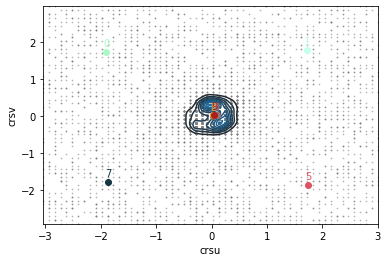

<Figure size 432x288 with 0 Axes>

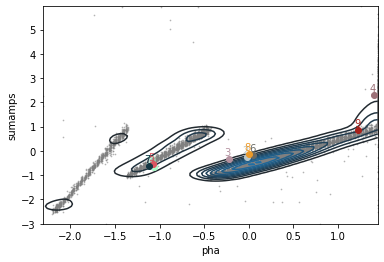

<Figure size 432x288 with 0 Axes>

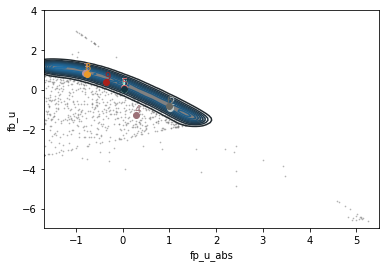

<Figure size 432x288 with 0 Axes>

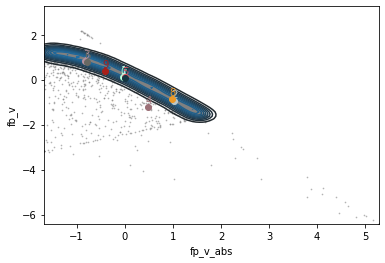

In [107]:
# Plot the centers of the clusters in these different spaces
# Do this for the pairs of features:
print(np.shape(centers))
color_array = ['#AAFAC8', '#C7FFED','#BBC8CA','#B592A0','#9C7178',
                   '#DB5461', '#686963', '#143642', '#EC9A29', '#A8201A' ]

size_random = 10000
data_select = standardized_data_df.sample(n=size_random)

print(standardized_data_df)
print(data_select)



for i in range(int(np.shape(centers)[1]/2)):
    # Make the shape of this divided by two of plots
    
    # Get the x and y features:
    plot_x = feature_list[2*i]
    plot_y = feature_list[2*i+1]
    
    index_x = all_feature_list.index(plot_x)
    index_y = all_feature_list.index(plot_y)
    
    # Also define where the centers fall: 
    
    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(data_select[plot_x].values, data_select[plot_y].values, 
               color='grey', s=0.5, alpha=0.5)
    sns.kdeplot(data_select[plot_x], data_select[plot_y], cut=0, ax = ax)#, shade_lowest=False, shade=True)
    
    
    
    for j in range(np.shape(centers)[0]):
        ax.scatter(centers[j][2*i], centers[j][2*i+1], color=color_array[j], zorder = 100)
        #print('this is the shape', np.shape(centers),'trying this cluster', j, 'and this x', 2*i, 'and this y', 2*i+1)
        ax.annotate(str(j), xy=(centers[j][2*i]-0.05, centers[j][2*i+1]+0.15), xycoords='data', color=color_array[j])
    #ax.set_aspect('equal')
    plt.show()
    
    

In [108]:
cluster={}
x_and_y_cluster = {}

for n in range(nclusters):

    cluster[n]=[]
    x_and_y_cluster[n] = []
    
    for j in range(np.shape(standardized_data)[0]):
        if clusters[j]==n:
            cluster[n].append(standardized_data[j])
            
            x_and_y_cluster[n].append(x_and_y[j])
            
    print('Cluster # ', n, ' length is ', len(cluster[n]), 
          ' fractional length is ', round(len(cluster[n])/np.shape(standardized_data)[0],2))
    
    
    
# plot each cluster individually
print(x_and_y_cluster[0])



Cluster #  0  length is  306565  fractional length is  0.04
Cluster #  1  length is  279261  fractional length is  0.04
Cluster #  2  length is  896574  fractional length is  0.13
Cluster #  3  length is  1255185  fractional length is  0.18
Cluster #  4  length is  445103  fractional length is  0.06
Cluster #  5  length is  293241  fractional length is  0.04
Cluster #  6  length is  1155125  fractional length is  0.17
Cluster #  7  length is  331264  fractional length is  0.05
Cluster #  8  length is  1182217  fractional length is  0.17
Cluster #  9  length is  755968  fractional length is  0.11


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<Figure size 432x288 with 0 Axes>

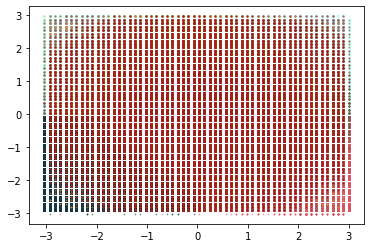

<Figure size 432x288 with 0 Axes>

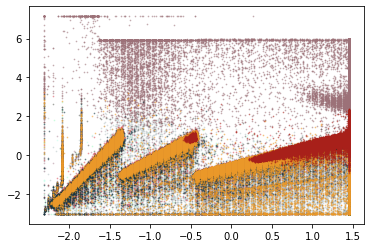

<Figure size 432x288 with 0 Axes>

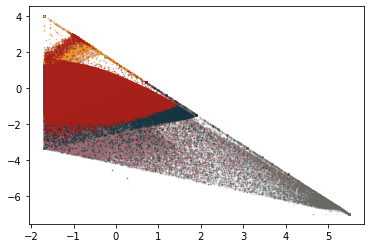

<Figure size 432x288 with 0 Axes>

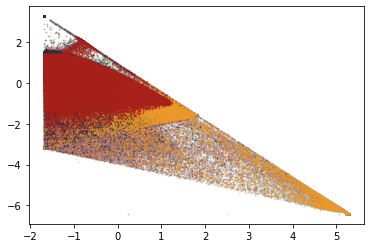

In [109]:
# Plot the points from each cluster in all of these different spaces

#color_array = ['orange','red','purple','blue','green']
for i in range(int(np.shape(centers)[1]/2)):
    # Make the shape of this divided by two of plots
    
    # Get the x and y features:
    plot_x = feature_list[2*i]
    plot_y = feature_list[2*i+1]
    
    index_x = feature_list.index(plot_x)
    index_y = feature_list.index(plot_y)
    
    
    # Also define where the centers fall: 
    
    plt.clf()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    for n in range(nclusters):
        ax.scatter(np.array(cluster[n])[:,index_x], 
                   np.array(cluster[n])[:,index_y], 
               color=color_array[n], s=0.5, alpha=0.5)
    plt.show()
 

(6951810, 2)
x 6481.045999999999 26216.475
y 6684.405 26623.547000000002
Cluster # 0 306565
(306565, 2)


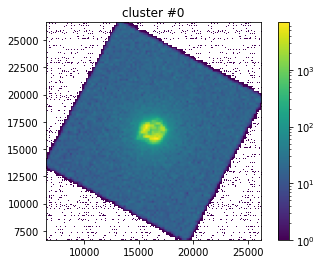

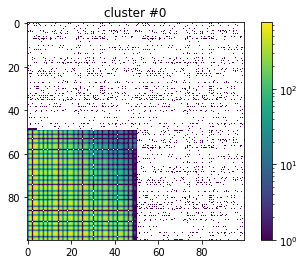

Cluster # 1 279261
(279261, 2)


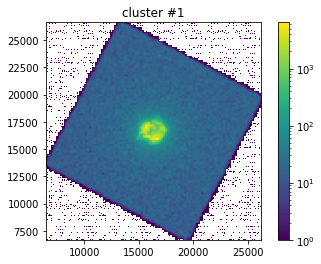

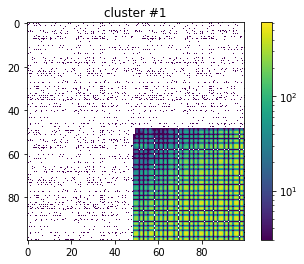

Cluster # 2 896574
(896574, 2)


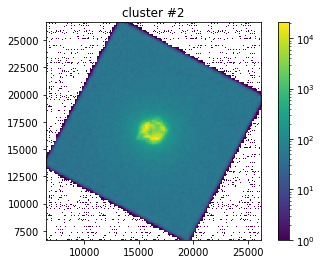

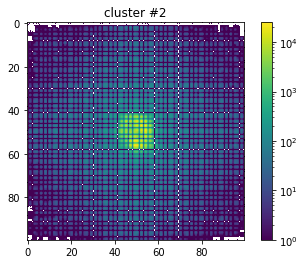

Cluster # 3 1255185
(1255185, 2)


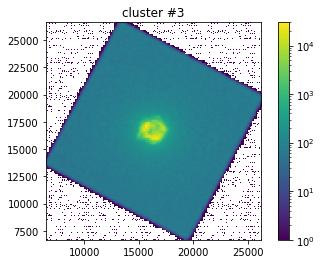

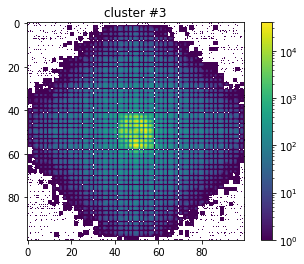

Cluster # 4 445103
(445103, 2)


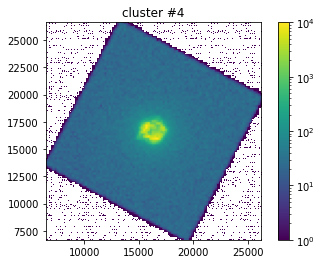

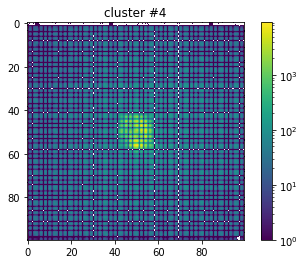

Cluster # 5 293241
(293241, 2)


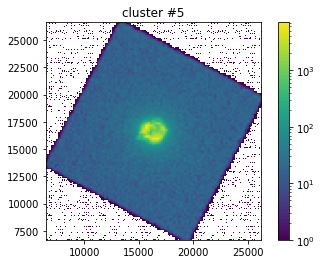

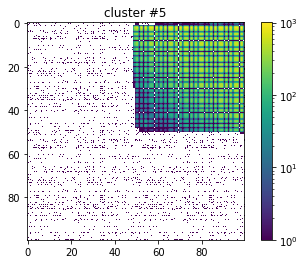

Cluster # 6 1155125
(1155125, 2)


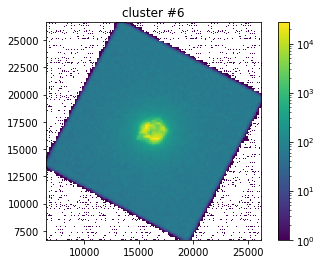

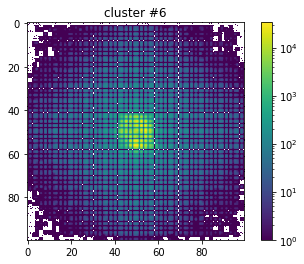

Cluster # 7 331264
(331264, 2)


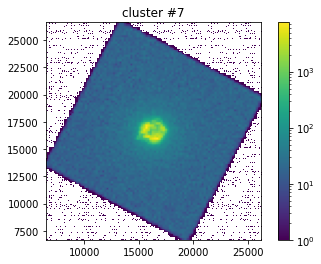

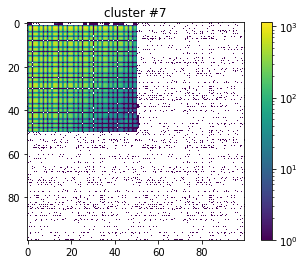

Cluster # 8 1182217
(1182217, 2)


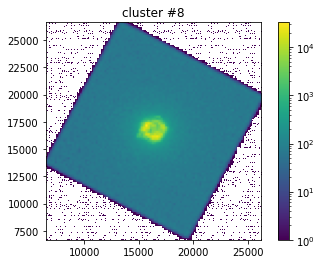

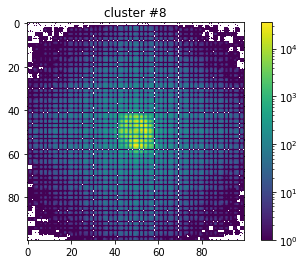

Cluster # 9 755968
(755968, 2)


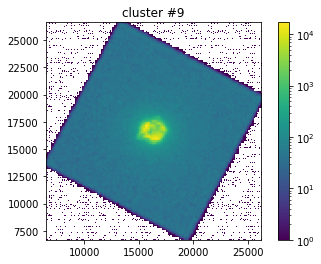

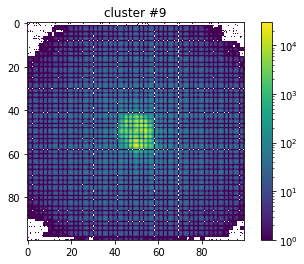

In [121]:
# Can you plot x, y images of what each cluster looks like in the data?


# Get an overall extent that is better than the individual ones:
print(np.shape(x_and_y))
print('x', np.min(x_and_y[:,0]), np.max(x_and_y[:,0]))
print('y', np.min(x_and_y[:,1]), np.max(x_and_y[:,1]))

extent_all = [np.min(x_and_y[:,0]), np.max(x_and_y[:,0]),np.min(x_and_y[:,1]), np.max(x_and_y[:,1])]
extent_all_crs = [[np.min(standardized_data[:,0]), np.max(standardized_data[:,0])],
                  [np.min(standardized_data[:,1]), np.max(standardized_data[:,1])]]
for n in range(nclusters):
    print('Cluster #', n, len(cluster[n]))
    print(np.shape(x_and_y_cluster[n]))
    
    x = np.array(x_and_y_cluster[n])[:,0]
    y = np.array(x_and_y_cluster[n])[:,1]
    
    
    nbins=100#int(len(x)/10)
    
    img_data, yedges, xedges = np.histogram2d(y, x, nbins)
    

    
    plt.clf()
    plt.imshow(abs(img_data), interpolation=None, extent=extent_all, norm=matplotlib.colors.LogNorm())#,rasterized=True, cmap='viridis', origin='data')
    

    plt.colorbar()
    plt.title('cluster #'+str(n))
    plt.show()
        
    crsu = np.array(cluster[n])[:,0]
    crsv = np.array(cluster[n])[:,1]
    
    
    nbins=100#int(len(x)/10)
    
    img_data, yedges, xedges = np.histogram2d(crsv, crsu, nbins, range = extent_all_crs)
    

    
    plt.clf()
    plt.imshow(abs(img_data), interpolation=None,  norm=matplotlib.colors.LogNorm())#,rasterized=True, cmap='viridis', origin='data')
    

    plt.colorbar()
    plt.title('cluster #'+str(n))
    plt.show()

<Figure size 432x288 with 0 Axes>

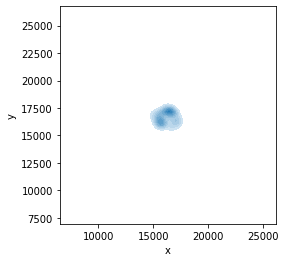

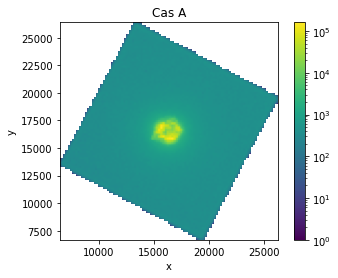

extent [[6684.405, 26623.547000000002], [6481.045999999999, 26216.475]]
Cluster #  0  length is  2045569  fractional length is  0.3
Cluster #  1  length is  4854934  fractional length is  0.7


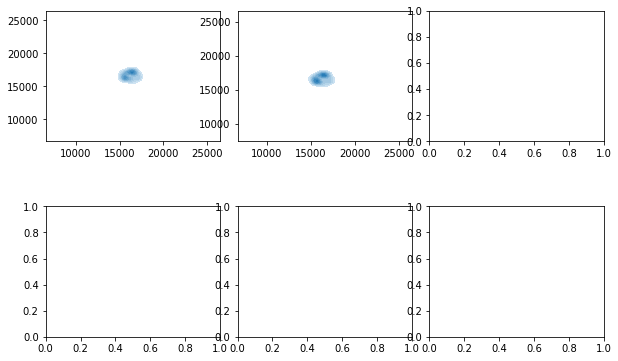

In [30]:
# Plot where the centers fall:



plt.clf()

plot_x = 'x'
plot_y = 'y'

index_x = all_feature_list.index(plot_x)
index_y = all_feature_list.index(plot_y)

data_select = data.sample(n=size_random)
# Instead, use a kde plot to better show the distributions:
fig = plt.figure()
ax = fig.add_subplot(111)
sns.kdeplot(data_select[plot_x], data_select[plot_y], shade_lowest=False, shade=True)
ax.set_aspect('equal')
plt.show()

plot_from_df(data, 'Cas A', plot_x, plot_y)



'''
standardized_data_df = pd.DataFrame(standardized_data, columns=feature_list)

plot_from_df(standardized_data_df, 'Cas A', plot_x, plot_y)

for i in range(nclusters):
    plt.scatter(centers[i][index_x], centers[i][index_y])
plt.xlabel('normalized '+plot_x)
plt.ylabel('normalized '+plot_y)
plt.show()
'''



# Classify all of the points into their proper cluster:


data_np = np.array(data)
extent = [[np.min(data_np[:,index_y]), np.max(data_np[:,index_y])], [np.min(data_np[:,index_x]), np.max(data_np[:,index_x])]]
print('extent', extent)
      


cluster={}
cluster_e={}

fig, axs = plt.subplots(2,3, figsize=(10, 6), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.1)

axs = axs.ravel()

#cluster_name=[]
for n in range(nclusters):

    print('Cluster # ', n, ' length is ', len(cluster[n]), 
          ' fractional length is ', round(len(cluster[n])/np.shape(standardized_data)[0],2))
    
    
    
    #sampled_size = cluster[n].sample(n=size_random)
    
    cluster_stack = np.vstack(cluster[n])#cluster[n]
    
    
    random_indices = np.random.choice(len(cluster[n]), size=size_random, replace=False)
    
    
    
    xs = cluster_stack[random_indices,index_x]
    ys = cluster_stack[random_indices,index_y]
    
    sns.kdeplot(xs, ys, shade_lowest=False, shade=True, ax = axs[n])
    #plt.show()
    continue
    
    nbins=100#int(len(x)/10)
    
    img_data, yedges, xedges = np.histogram2d(ys, xs, nbins, range=extent)
            #xedges[0], xedges[-1], yedges[0], yedges[-1]]

    #print('# Real events: ', len(input_data.loc[good_hyperbola]), '# All events: ',len(input_data))
    #print('# bg events: ', len(input_data)-len(input_data.loc[good_hyperbola]))
    #try:
    
    
    axs[n].annotate('Cluster # '+str(n)+'\nLength: '+str(len(cluster[n]))+' ('+str(round(100*len(cluster[n])/np.shape(standardized_data)[0],1))+'%)', 
                   xy = (0.03, 0.9), xycoords='axes fraction')
    
    im = axs[n].imshow(ma.masked_where(img_data==0, img_data),  
                    rasterized=True, cmap='viridis')#, 
                  # norm=matplotlib.colors.LogNorm())#, extent=extent
    if n==0:
        axs[n].set_xlabel(plot_x)
        axs[n].set_ylabel(plot_y)

    plt.colorbar(im, ax = axs[n], fraction=0.046)

plt.show()


/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/matplotlib/contour.py:1430: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/matplotlib/contour.py:1431: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


<Figure size 432x288 with 0 Axes>

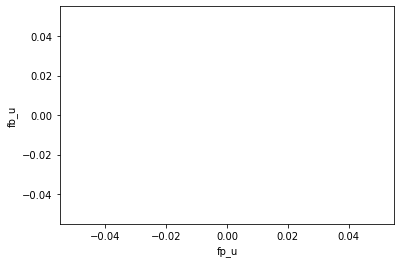

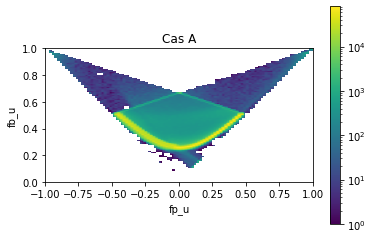

extent [[0.0, 1.0], [-0.9740518962075848, 1.0]]


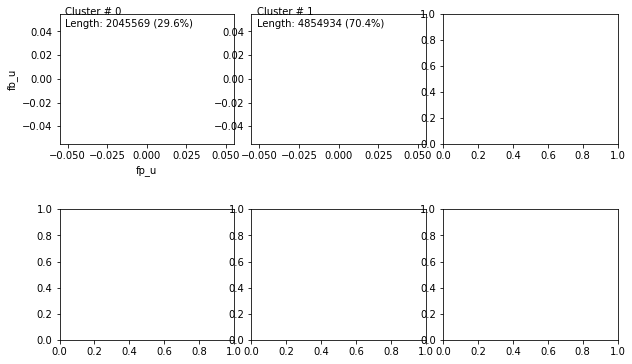

<Figure size 432x288 with 0 Axes>

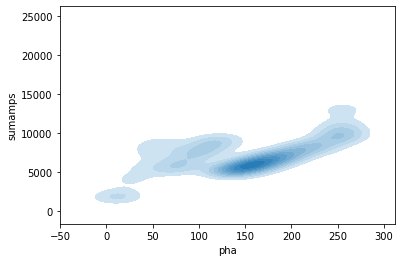

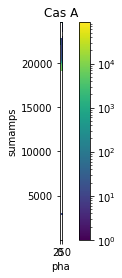

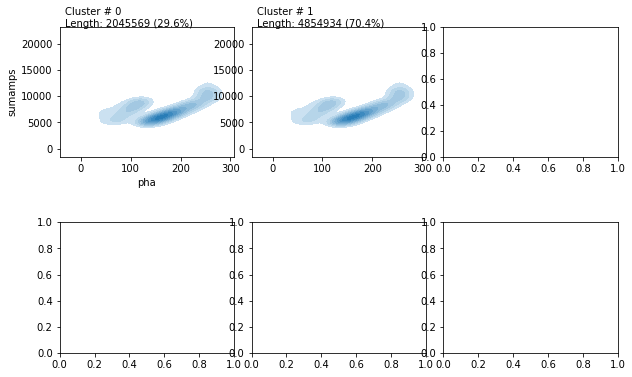

In [31]:
# Do the same thing with fp_u and fb_u
plt.clf()

plot_x = 'fp_u'
plot_y = 'fb_u'

index_x = all_feature_list.index(plot_x)
index_y = all_feature_list.index(plot_y)

fig = plt.figure()
ax = fig.add_subplot(111)
sns.kdeplot(data_select[plot_x], data_select[plot_y], shade_lowest=False, shade=True)
#ax.set_aspect('equal')
plt.show()
plot_from_df(data, 'Cas A', plot_x, plot_y)

'''
for i in range(nclusters):
    plt.scatter(centers[i][index_x], centers[i][index_y])
plt.xlabel('normalized '+plot_x)
plt.ylabel('normalized '+plot_y)
plt.show()

'''


extent = [[np.min(data_np[:,index_y]), np.max(data_np[:,index_y])], [np.min(data_np[:,index_x]), np.max(data_np[:,index_x])]]
print('extent', extent)
fig, axs = plt.subplots(2,3, figsize=(10, 6), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.1)

axs = axs.ravel()

#cluster_name=[]
for n in range(nclusters):
    
    #img_data, yedges, xedges = np.histogram2d(ys, xs, nbins, range=extent)
            #xedges[0], xedges[-1], yedges[0], yedges[-1]]

    
    
    xs = cluster_stack[random_indices,index_x]
    ys = cluster_stack[random_indices,index_y]
    
    sns.kdeplot(xs, ys, shade_lowest=False, shade=True, ax = axs[n])
    
    
    
    axs[n].annotate('Cluster # '+str(n)+'\nLength: '+str(len(cluster[n]))+' ('+str(round(100*len(cluster[n])/np.shape(standardized_data)[0],1))+'%)', 
                   xy = (0.03, 0.9), xycoords='axes fraction')
    
    #im = axs[n].imshow(ma.masked_where(img_data==0, img_data),  
    #                rasterized=True, cmap='viridis')#, origin='data')#, 
                  # norm=matplotlib.colors.LogNorm())#, extent=extent
    if n==0:
        axs[n].set_xlabel(plot_x)
        axs[n].set_ylabel(plot_y)

    #plt.colorbar(im, ax = axs[n], fraction=0.046)

plt.show()


# Do the same thing with fp_u and fb_u
plt.clf()

plot_x = 'pha'
plot_y = 'sumamps'

index_x = all_feature_list.index(plot_x)
index_y = all_feature_list.index(plot_y)

fig = plt.figure()
ax = fig.add_subplot(111)
sns.kdeplot(data_select[plot_x], data_select[plot_y], shade_lowest=False, shade=True)
#ax.set_aspect('equal')
plt.show()

plot_from_df(data, 'Cas A', plot_x, plot_y)
'''
for i in range(nclusters):
    plt.scatter(centers[i][index_x], centers[i][index_y])
plt.xlabel('normalized '+plot_x)
plt.ylabel('normalized '+plot_y)
plt.show()
'''



extent = [[np.min(data_np[:,index_y]), np.max(data_np[:,index_y])], [np.min(data_np[:,index_x]), np.max(data_np[:,index_x])]]

fig, axs = plt.subplots(2,3, figsize=(10, 6), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.1)

axs = axs.ravel()

#cluster_name=[]
for n in range(nclusters):
    
    
    xs = cluster_stack[random_indices,index_x]
    ys = cluster_stack[random_indices,index_y]
    
    #img_data, yedges, xedges = np.histogram2d(ys, xs, nbins, range=extent)
            #xedges[0], xedges[-1], yedges[0], yedges[-1]]

    sns.kdeplot(xs, ys, shade_lowest=False, shade=True, ax = axs[n])
    
    axs[n].annotate('Cluster # '+str(n)+'\nLength: '+str(len(cluster[n]))+' ('+str(round(100*len(cluster[n])/np.shape(standardized_data)[0],1))+'%)', 
                   xy = (0.03, 1), xycoords='axes fraction')
    
    #im = axs[n].imshow(ma.masked_where(img_data==0, img_data),  
    #                rasterized=True, cmap='viridis')#, origin='data')#, 
                  # norm=matplotlib.colors.LogNorm())#, extent=extent
    if n==0:
        axs[n].set_xlabel(plot_x)
        axs[n].set_ylabel(plot_y)

    #plt.colorbar(im, ax = axs[n], fraction=0.046)

plt.show()


(6900503, 28)
x = fp_v
y = fb_v


<Figure size 432x288 with 0 Axes>

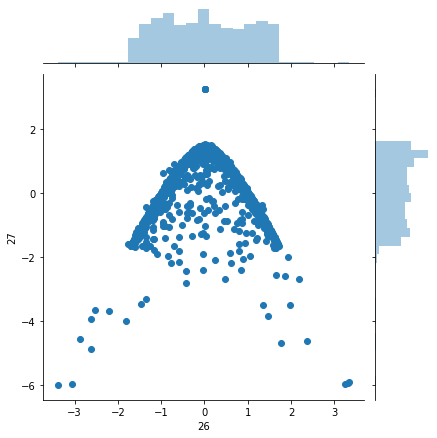

In [19]:
### Now do the RF clustering where you make frankenstein data
print(np.shape(standardized_data))
import seaborn as sns
from random import randint



plt.clf()

pix_1 = 26# This is just randomly selecting a feature in the event table
pix_2 = 27

print('x = '+feature_list[pix_1])
print('y = '+feature_list[pix_2])

x = standardized_data[0:2000,pix_1]
y = standardized_data[0:2000,pix_2]
g = (sns.jointplot(x, y)
        .set_axis_labels(str(pix_1), str(pix_2)));#, kind="hex"

913
(1000, 28)
(1000, 28)


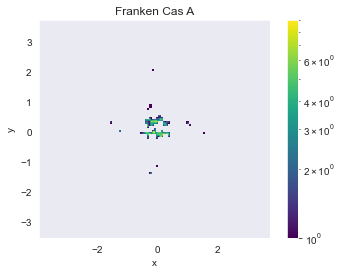

NameError: name 'STOP' is not defined

In [26]:
## Make a marginal distribution

standardized_data = standardized_data[0:1000]

value = randint(0, np.shape(standardized_data)[0])
print(value)

frankenstein_array = np.zeros(np.shape(standardized_data))

for i in range(np.shape(standardized_data)[0]):
    frankenstein_gal = []
    for j in range(np.shape(standardized_data)[1]):
        ran_int = randint(0,np.shape(standardized_data)[0] - 1)
        frankenstein_gal.append(standardized_data[ran_int,j])
    frankenstein_array[i,:] = frankenstein_gal
    
print(np.shape(frankenstein_array))
print(np.shape(standardized_data))
plot_from_df(pd.DataFrame(frankenstein_array, columns=feature_list), 'Franken Cas A', 'x', 'y')

STOP
# plot a random collection of galaxies once they have been rebinned and resized
plt.clf()
sns.set_style("dark")
fig = plt.figure(figsize = (25,15))
fig.subplots_adjust(hspace=0.3, 
                    wspace=0.15)

for j in range(6):
    ax = fig.add_subplot(1,6, j+1)
    
    ran_int = randint(0,np.shape(frankenstein_array)[0] - 1)
    
    # Plot three random versions of Cas A (uncorrelated)
    plot_from_df(pd.DataFrame(frankenstein_array[ran_int], columns=feature_list), 'Franken Cas A', 'x', 'y')

    im = ax.imshow(np.reshape(frankenstein_array[ran_int], (np.shape(MB_matrix_flat)[1],np.shape(MB_matrix_flat)[1])), cmap='RdBu_r', norm=MidpointNormalize(midpoint=0))
plt.show()

(1000, 28)
(1000, 28)


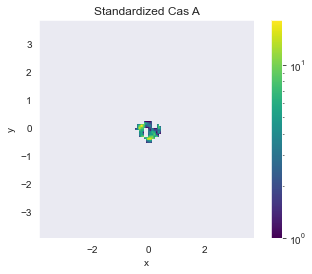

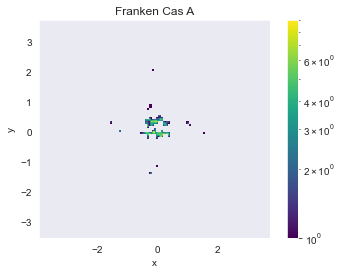

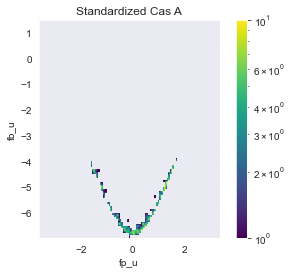

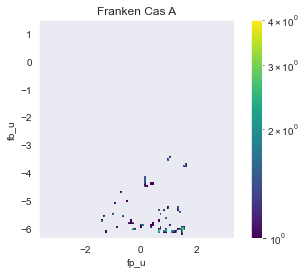

In [27]:
# Explore what the franken event file looks like 
print(np.shape(frankenstein_array))
print(np.shape(standardized_data))
plot_from_df(pd.DataFrame(standardized_data, columns = feature_list), 'Standardized Cas A', 'x', 'y')

plot_from_df(pd.DataFrame(frankenstein_array, columns = feature_list), 'Franken Cas A', 'x', 'y')


plot_from_df(pd.DataFrame(standardized_data, columns = feature_list), 'Standardized Cas A', 'fp_u', 'fb_u')

plot_from_df(pd.DataFrame(frankenstein_array, columns = feature_list), 'Franken Cas A', 'fp_u', 'fb_u')


In [283]:


from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

def testAndTrainIndices(test_fold, Nfolds, folds):

    print('finding test and train indices...')

    train_folds = np.delete(np.arange(Nfolds), test_fold)

    test_ind   = [i for i in range(len(folds)) if folds[i]==test_fold]
    train_ind  = [i for i in range(len(folds)) if folds[i] in train_folds]

    return test_ind, train_ind

def run_RFC(df_merg, features_list,  verbose):
    # These are adjustable RFR parameters
    Nfolds = 10
    Ndat = 5000

    features = df_merg[features_list].values
    #,'nspax','re'
    Nfeatures = len(features[0])
    
    #dat['features']#.reshape(-1,1)
    labels = df_merg[['class']].values
    folds = np.arange(len(labels))%Nfolds
    
    
    #Test on fold 0, train on the remaining folds:
    test_ind, train_ind = testAndTrainIndices(test_fold = 0, Nfolds = Nfolds, folds=folds)
    
    #divide features and labels into test and train sets:
    test_features = features[test_ind]
    test_labels   = labels[test_ind]
   
    train_features  = features[train_ind]
    train_labels    = labels[train_ind]

    print('training fold 0')
    #make a random forest model:
    model = RandomForestClassifier(max_depth=10, random_state=42)
    model.fit(train_features, train_labels)

    print('predicting...')
    # Predict on new data
    preds = model.predict(test_features)
    #print out the first few mass predictions to see if they make sense:
    if verbose:
        for h in range(10):
            print(test_labels[h], preds[h])

    #print('made it through creating model', preds)
    # rank feature importance:
    importances = model.feature_importances_
    #print('ranked importances', importances)
    std = np.std([tree.feature_importances_ for tree in model.estimators_], axis=0)
    indices = np.argsort(importances)[::-1]
    
    #print('std and indices', std, indices)

    if verbose:
        # Plot the feature importances of the forest
        plt.clf()
        plt.figure(figsize=(15,5))
        #plt.title("RFR Feature importances for "+str(run))
        plt.bar(range(Nfeatures), importances[indices], yerr=std[indices], align="center", color='pink')
        plt.xticks(range(Nfeatures), indices)
        plt.xlim([-1, Nfeatures])
        plt.show()
        
        #plt.savefig('feature_importance_'+str(run)+'_rando.pdf')
        
        
        
        print('Importance in Order ~~~~')
    
    # find the index of the random one:
    random_idx = features_list.index('random')
    random_value = importances[random_idx]
    random_std = std[random_idx]
    if verbose:
        print('random idx', random_idx)
        print('random_value', random_value)
    unin_here = []
    important_here = []
    for j in range(len(indices)):
        #if importances[indices[j]] - std[indices[j]] > 0:
        print(indices[j], features_list[indices[j]])
        if importances[indices[j]] > random_value:# or importances[indices[j]] - std[indices[j]] > random_value - random_std:
            important_here.append(features_list[indices[j]])
        else:
            unin_here.append(features_list[indices[j]])
        
  
    return important_here, unin_here, model



finding test and train indices...
training fold 0


/Users/rebeccanevin/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


predicting...
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real
['real'] real


<Figure size 432x288 with 0 Axes>

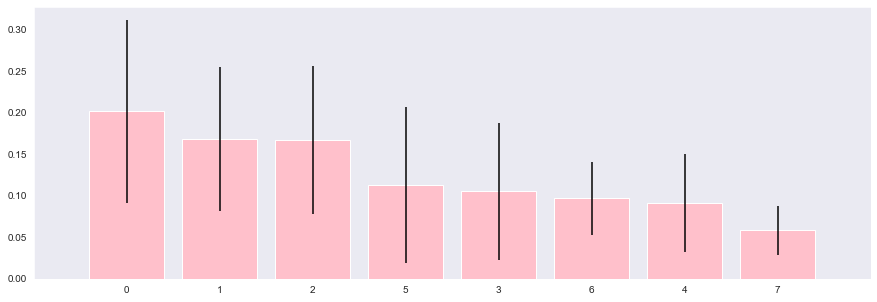

Importance in Order ~~~~
random idx 7
random_value 0.05809680632508389
0 pha
1 pi
2 sumamps
5 fp_v
3 fp_u
6 fb_v
4 fb_u
7 random


In [29]:
# Now train a random forest to distinguish between real and franken data:
# label one as ones and one as zeros

feature_list_random = ['time', 'crsv', 'crsu', 'amp_sf', 'av1', 'av2', 'av3', 'au1', 'au2', 'au3', 'rawx', 'rawy', 'chipx', 'chipy', 'tdetx', 'tdety', 'detx', 'dety', 'x', 'y', 'pha', 'pi', 'sumamps', 'chip_id', 'fp_u', 'fb_u', 'fp_v', 'fb_v', 'random']


feature_list_random = ['pha', 'pi', 'sumamps',  'fp_u', 'fb_u', 'fp_v', 'fb_v', 'random']# 'x','y', 



df_0 = pd.DataFrame(standardized_data[0:10000], columns=feature_list)#
df_1 = pd.DataFrame(frankenstein_array[0:10000], columns=feature_list)

df_0['random'] = np.random.random(len(df_0))
df_1['random'] = np.random.random(len(df_1))

df_0['class'] = 'real'
df_1['class'] = 'synthetic'

#print(df_0)
most_imp, unimportant, model  = run_RFC(pd.concat([df_0,df_1]), 
                          feature_list_random, verbose=True)



['pha', 'pi', 'sumamps', 'fp_v', 'fp_u', 'fb_v', 'fb_u'] ['random'] RandomForestClassifier(max_depth=10, random_state=42)
['real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real' 'real'
 'real' 'real' 'real' 'rea

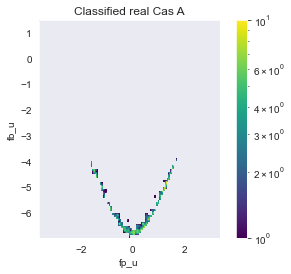

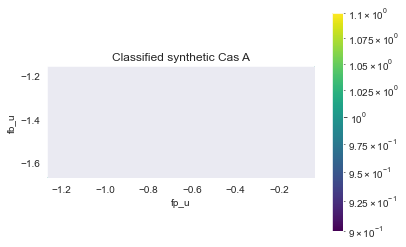

In [30]:
print(most_imp, unimportant, model)



# Now classify everything as weird or normal

predicted = model.predict(df_0[feature_list_random].values)
predict_prob = model.predict_proba(df_0[feature_list_random].values)

#print(np.bincount(predicted))
print(predicted)
print(predict_prob)
real_i = np.where(predicted=='real')[0]
not_real_i = np.where(predicted=='synthetic')[0]

print('real', len(real_i))
print('not real', len(not_real_i))

real_df = df_0[feature_list_random].values[real_i]
synthetic_df = df_0[feature_list_random].values[not_real_i]

# Now make plots out of these two 
plot_from_df(pd.DataFrame(real_df, columns = feature_list_random), 'Classified real Cas A', 'fp_u', 'fb_u')
plot_from_df(pd.DataFrame(synthetic_df, columns = feature_list_random), 'Classified synthetic Cas A', 'fp_u', 'fb_u')

In [64]:
#Wait so you need to figure out which spaxel this is
#322, where is this?

full_length = np.shape(MB_matrix_rescaled)[1]
empty = np.zeros(np.shape(MB_matrix_rescaled)[1])
for j in range(len(most_imp)):
    empty[most_imp[j]] = value[j]
    
print(empty)

# how does this show value?

'''
#side = int(np.sqrt(len(empty)))
twod = np.reshape(empty, (side,side))
plt.imshow(twod)
plt.colorbar()
plt.show()
'''

NameError: name 'MB_matrix_rescaled' is not defined